## PTBDB

In [401]:
import torch
import os
from scipy import io
import numpy as np
from matplotlib import pyplot as plt
#from wandb.keras import WandbMetricsLogger, WandbModelCheckpoint
import tqdm
from torcheval.metrics.functional import r2_score

In [402]:
devices = [torch.device("cuda:0"), torch.device("cuda:1")]
device = devices[0]
device_type = 'cuda' # for later use in torch.autocast

In [403]:
mainfolder = "dump_data"
leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
conditiondata = {'BB': [], 'HC': [], 'HY' : [], 'MI': [], 'ND': [],'VA': []}
for folder in os.listdir(mainfolder):
    i = os.path.join(mainfolder, folder)
    # checking if it is a dir
    if not os.path.isfile(i):
        j1 = os.path.join(i, 'RL3')
        j2 = os.path.join(i, 'SL9')
        for patient in os.listdir(j1):
            k1 = os.path.join(j1, patient)
            k2 = os.path.join(j2, patient)
            RL3data = torch.tensor(io.loadmat(k1)['val_RL3'], dtype=torch.float32)
            SL9data = torch.tensor(io.loadmat(k2)['val_SL9'], dtype=torch.float32)
            conditiondata[folder].append(torch.cat((RL3data,SL9data), 0))

for key in conditiondata:
    conditiondata[key] = torch.stack(conditiondata[key], 0)


In [248]:
d0 = sum([conditiondata[key].shape[0] for key in conditiondata])

In [419]:
r_ptbdb = 0.465 # proportion of time/people taken for training
#window_len = 25 # num of input timesteps used to make a single prediction
#slide_len = 5 # num of output timesteps in a single prediction
#condition = 'HC' # condition of patient used for training model
#pred_steps = (int(30000*(1-r)) - window_len)

In [420]:
d1 = 30000

In [421]:
illness_wise_patient_nums = [len(conditiondata[condition]) for condition in conditiondata]
illness_wise_patient_nums

[17, 80, 26, 368, 18, 7]

In [422]:
totaldata_ptbdb = torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)
traindata_ptbdb = torch.cat([conditiondata[condition][:round(r_ptbdb*len(conditiondata[condition]))] for condition in conditiondata], dim=0)
testdata_ptbdb = torch.cat([conditiondata[condition][round(r_ptbdb*len(conditiondata[condition])):] for condition in conditiondata], dim=0)

resampled_testdata_ptbdb = torch.zeros((testdata_ptbdb.size(0),testdata_ptbdb.size(1), int(testdata_ptbdb.size(2)/2)))
for i in range(len(testdata_ptbdb)):
    for j in range(len(leads)):
        resampled_testdata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(testdata_ptbdb[i,j], 15000), dtype=torch.float32)

resampled_traindata_ptbdb = torch.zeros((traindata_ptbdb.size(0),traindata_ptbdb.size(1), int(traindata_ptbdb.size(2)/2)))
for i in range(len(traindata_ptbdb)):
    for j in range(len(leads)):
        resampled_traindata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(traindata_ptbdb[i,j], 15000), dtype=torch.float32)

In [423]:
torch.manual_seed(1337)
train_idx = torch.randperm(resampled_traindata_ptbdb.size(0))
test_idx = torch.randperm(resampled_testdata_ptbdb.size(0))
print(train_idx[:10])
print(test_idx[:10])

tensor([228,  88, 172, 143,  54, 120, 135,  57,  71,  19])
tensor([146, 237, 257,  91,  62, 221,  82, 262, 161,  58])


In [424]:
resampled_traindata_ptbdb = resampled_traindata_ptbdb[train_idx]
resampled_testdata_ptbdb = resampled_testdata_ptbdb[test_idx]

In [425]:
# # extract 5000 point graphs with window size 1000 from 30000 point ECG
# data_5k_snaps = []
# window_size = 2500
# image_size = 30000
# for i in range(totaldata.size(0)):
#     for j in range((totaldata.size(2) - image_size)//window_size):
#         data_5k_snaps.append(totaldata[i, :, j*window_size: j*window_size + image_size])
# data_5k_snaps = torch.stack(data_5k_snaps)
# data_5k_snaps.shape

In [426]:
# X_train = torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)[int(r*d0):,:3,:round((1-r)*d1)].unsqueeze(1)
# y_train= torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)[int(r*d0):,3:,:round((1-r)*d1)].unsqueeze(1)
# X_test = torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)[:int(r*d0),:3,:round((1-r)*d1)].unsqueeze(1)
# y_test = torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)[:int(r*d0),3:,:round((1-r)*d1)].unsqueeze(1)
# X_train.shape, y_train.shape, X_test.shape, y_test.shape

# X_test = data_5k_snaps[int(r*data_5k_snaps.size(0)):,:3,:].unsqueeze(1)
# y_test= data_5k_snaps[int(r*data_5k_snaps.size(0)):,3:,:].unsqueeze(1)
# X_train = data_5k_snaps[:int(r*data_5k_snaps.size(0)),:3,:].unsqueeze(1)
# y_train = data_5k_snaps[:int(r*data_5k_snaps.size(0)),3:,:].unsqueeze(1)
# X_train.shape, y_train.shape, X_test.shape, y_test.shape

clip_len = 204

X_test_ptbdb = resampled_testdata_ptbdb[:,:3,clip_len:-clip_len].unsqueeze(1)
y_test_ptbdb = resampled_testdata_ptbdb[:,3:,clip_len:-clip_len].unsqueeze(1)
X_train_ptbdb = resampled_traindata_ptbdb[:,:3,clip_len:-clip_len].unsqueeze(1)
y_train_ptbdb = resampled_traindata_ptbdb[:,3:,clip_len:-clip_len].unsqueeze(1)
# X_ptbdb = totaldata_ptbdb[:,:3,clip_len:-clip_len].unsqueeze(1)
# y_ptbdb = totaldata_ptbdb[:,3:,clip_len:-clip_len].unsqueeze(1)
X_train_ptbdb.shape, y_train_ptbdb.shape, X_test_ptbdb.shape, y_test_ptbdb.shape

(torch.Size([239, 1, 3, 14592]),
 torch.Size([239, 1, 9, 14592]),
 torch.Size([277, 1, 3, 14592]),
 torch.Size([277, 1, 9, 14592]))

In [427]:
# data normalization
for i in range(X_train_ptbdb.size(0)):
    for j in range(3):
        #print(X_train_ptbdb[i,0,j].shape)
        X_train_ptbdb[i,0,j] = X_train_ptbdb[i,0,j]/torch.max(torch.abs(X_train_ptbdb[i,0,j]))
    for j in range(9):
        #print(y_train_ptbdb[i,0,j].shape)
        y_train_ptbdb[i,0,j] = y_train_ptbdb[i,0,j]/torch.max(torch.abs(y_train_ptbdb[i,0,j]))
for i in range(X_test_ptbdb.size(0)):
    for j in range(3):
        #print(X_test_ptbdb[i,0,j].shape)
        X_test_ptbdb[i,0,j] = X_test_ptbdb[i,0,j]/torch.max(torch.abs(X_test_ptbdb[i,0,j]))
    for j in range(9):
        #print(y_5sec_train[i,0,j].shape)
        y_test_ptbdb[i,0,j] = y_test_ptbdb[i,0,j]/torch.max(torch.abs(y_test_ptbdb[i,0,j]))
    #break

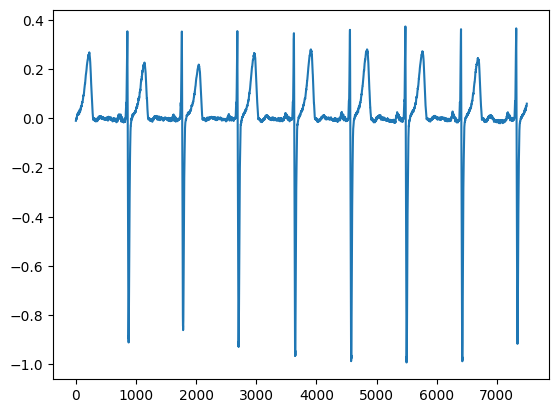

In [55]:
start = 0
stop = 7500
sums = []
indices = []
for i in range(X_5sec_train.size(0)):
    inisum = sum(abs(X_5sec_train[i,0,0][:start]))
    sums.append((i, inisum))
    if inisum > 4:
        indices.append(i)
#print(torch.tensor(sums)[indices])
i = 12
plt.plot([x for x in range(len(X_5sec_train[i,0,0][start:stop]))], X_5sec_train[i,0,2][start:stop])

In [275]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms


# upsample block for pix2pix in pytorch
class UpSampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padding=1, activation='relu', output_padding=0):
        super(UpSampleBlock, self).__init__()
        self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, output_padding=output_padding)
        self.batch_norm = nn.BatchNorm2d(out_channels)
        self.activation = nn.ReLU(inplace=True) if activation == 'relu' else nn.Tanh()

    def forward(self, x):
        x = self.conv_transpose(x)
        x = self.batch_norm(x)
        x = self.activation(x)
        return x

# downsample block for pix2pix in pytorch
class DownSampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=5, padding=1, activation='leakyrelu', batch_norm=True):
        super(DownSampleBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        self.batch_norm = nn.BatchNorm2d(out_channels) if batch_norm else None
        self.activation = nn.LeakyReLU(0.2, inplace=True) if activation == 'leakyrelu' else nn.Tanh()

    def forward(self, x):
        x = self.conv(x)
        if self.batch_norm:
            x = self.batch_norm(x)
        x = self.activation(x)
        return x


# Unet generator for pix2pix in pytorch
class Generator(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Generator, self).__init__()
        self.encoder = nn.Sequential(
            DownSampleBlock(in_channels, 1*64, batch_norm=False ,kernel_size=(3,4), stride=(1,2), padding=1),
            DownSampleBlock(1*64, 1*128, kernel_size=(3,4), stride=(1,2), padding=1),
            DownSampleBlock(1*128, 1*256, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*256, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            #DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
        )

        self.decoder = nn.Sequential(
            UpSampleBlock(1*512, 1*512,kernel_size=(3,4),stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            #UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 256,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*512, 1*128,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*256, 1*64,kernel_size=(3,4), stride=(1,2),padding=1),
        )
        self.last = nn.Sequential(
            nn.ConvTranspose2d(1*128, out_channels, kernel_size=(3,4), stride=(1,2), padding=1),
            nn.Tanh()
        )
            
            
    
    def forward(self, x):    
        # Downsampling through the model
        skips = []
        x = x.repeat(1,1,3,1) # another approach
        for module in self.encoder:
            x = module(x)
            skips.append(x)
            # print("down")
            # print(x.shape)
        skips = reversed(skips[:-1])
        # #print(skips)
        # Upsampling and establishing the skip connections
        for up, skip in zip(self.decoder, skips):
            x = up(x)
            # #print(skip.shape)
            # print(x.shape)
            x = torch.cat([x, skip], 1)
        
        x = self.last(x)
        return x
        
# Discriminator
class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(PatchGANDiscriminator, self).__init__()
        self.model = nn.Sequential(
            DownSampleBlock(in_channels, 1*64, batch_norm=False, stride=(1,2), padding=1),
            DownSampleBlock(1*64, 1*128, stride=(1,2), padding=1),
            DownSampleBlock(1*128,1* 256, stride=(1,2),padding=1),
            #DownSampleBlock(256, 512, stride=(1,2),padding=1),
            nn.Conv2d(1*256, out_channels, stride=(1,2), kernel_size=3, padding=1),
        )
    
    def forward(self, x, y):
        #x = torch.nn.functional.pad(x, (0,0,3,3)) # for making 3 lead input to 9 lead with other leads at zeros
        x = x.repeat(1,1,3,1) # another approach
        input = torch.cat([x, y], 1)
        return self.model(input)

In [194]:
generator = Generator(1, 1).to(device)
discriminator = PatchGANDiscriminator(2, 1).to(device)


x = X_5sec_train[0].unsqueeze(0).to(device)
y = generator(x)
print(y.shape)
discriminator(x, y).shape

torch.Size([1, 1, 9, 29696])


torch.Size([1, 1, 9, 1856])

In [274]:
def sample(generator,X, y, start=0, length=None, res=1, index=None):
    x = [i for i in range(X.size(3))]
    if length is None:
        length = X.size(3)
    plt.subplots(9, 1, sharex='all', figsize=(25,25))
    if index is None:
        index = torch.randint(0, y.size(0), (1,)).item()
    assert index < y.size(0) 
    patient_true = y[index,0]
    patient_pred = generator(X[index].unsqueeze(0).to(device))[0,0].detach().cpu()
    #plt.ylim(-3,3)
    print(f"Index: {index}")
    for i in range(9):
        plt.subplot(9, 1, i+1)
        plt.plot(x[start:start+length][::res],patient_true[i][start:start+length][::res], label='true')
        plt.plot(x[start:start+length][::res],patient_pred[i][start:start+length][::res], label='predicted')
    plt.legend(['true', 'predicted'])
    plt.show()

In [276]:
def compute_metrics(generator, X, y, num_preds_ratio=1):
    #index = torch.randint(0, round((1-r) * d0), (1,)).item()
    #patient_true = y[index,0]
    generator.eval()
    #patient_pred = generator(X[index].unsqueeze(0).to(device))[0,0].detach().cpu()
    #plt.ylim(-3,3)
    totalnum = y.size(0)
    test_num_patients = int(num_preds_ratio*y.size(0))
    avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
    avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
    idx = torch.randperm(totalnum)[:test_num_patients]
    for index in idx:
        #print(f"patient {index} from test set")
        patient_true = y[index.item(),0]
        patient_pred = generator(X[index.item()].unsqueeze(0).to(device))[0,0].detach().cpu()
        for i in range(9):
            z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
            avg_pearsoncorr_score[leads[i + 3]] += z[0,1]/test_num_patients
            avg_r2_score[leads[i + 3]] += r2_score(patient_pred[i], patient_true[i])/test_num_patients
            #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
    for i in range(9):
        #print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
        print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
    print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")
#compute_metrics(generator, 0.01, 'train')

In [198]:
import torch
from torch.utils.data import TensorDataset, DataLoader

class CustomDataset(Dataset):
    def __init__(self, x_data, y_data):
        self.x_data = x_data
        self.y_data = y_data

    def __len__(self):
        return self.x_data.size(0)

    def __getitem__(self, idx):
        x = self.x_data[idx]
        y = self.y_data[idx]
        return x, y
        
# Create Dataset objects for training and testing data
#train_dataset = TensorDataset(X_5sec_train, y_5sec_train)
#test_dataset = TensorDataset(X_5sec_test, y_5sec_test)

train_dataset = CustomDataset(X_5sec_train, y_5sec_train)
test_dataset = CustomDataset(X_5sec_test, y_5sec_test)

# Create DataLoader objects for training and testing data
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=2, shuffle=False, pin_memory=True)


In [199]:
generator = Generator(1, 1).to(device)
discriminator = PatchGANDiscriminator(2, 1).to(device)
# Loss functions
criterion_GAN = nn.BCEWithLogitsLoss()
criterion_L1 = nn.L1Loss()

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.000002, betas=(0.5, 0.999))

In [ ]:
# Training
num_epochs = 100
N = 100
test_losses = []

for epoch in range(num_epochs):
    for i, (input_img, target_img) in enumerate(train_loader):
        input_img = input_img.to(device)
        target_img = target_img.to(device)

        # Train Discriminator
        optimizer_D.zero_grad()
        fake_img = generator(input_img)
        real_output = discriminator(input_img, target_img)
        fake_output = discriminator(input_img, fake_img.detach())
        real_loss = criterion_GAN(real_output, torch.ones_like(real_output))
        fake_loss = criterion_GAN(fake_output, torch.zeros_like(fake_output))
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        fake_output = discriminator(input_img, fake_img)
        gan_loss = criterion_GAN(fake_output, torch.ones_like(fake_output))
        l1_loss = criterion_L1(fake_img, target_img)
        g_loss = gan_loss + N * l1_loss
        g_loss.backward()
        optimizer_G.step()
            
        if (i % 100 == 0):
            print(f"Epoch [{epoch+1}/{num_epochs}], Step [{i+1}]")
            print(f"L1 Loss: {l1_loss.item()}, Gan Loss: {gan_loss.item()}")
            print(f"Total D Loss: {d_loss.item()}, Total G Loss: {g_loss.item()}")
            
    
    with torch.no_grad():
        generator.eval()
        discriminator.eval()
        l1_test_loss = []
        for input_img, target_img in test_loader:
            input_img = input_img.to(device)
            patient_true = target_img.to(device)
            #print(f"patient {index} from test set")
            patient_pred = generator(input_img)
            l1_test_loss.append(criterion_L1(patient_pred, patient_true))

        epoch_avg_test_loss = sum(l1_test_loss)/len(l1_test_loss)
        print(f"Test Loss: {epoch_avg_test_loss}")
        #g_loss = gan_loss + N * l1_loss
        test_losses.append(epoch_avg_test_loss)
        # if epoch > 10 and epoch_avg_test_loss > sum(test_losses)/len(test_losses):
        #     print(f"Stopped Early at Epoch: {epoch}")
        #     break
        
    generator.train()
    discriminator.train()

    if (epoch % 5) == True:
        sample(generator, start=15000, length=5000)
        compute_metrics(generator)
print("Training finished.")

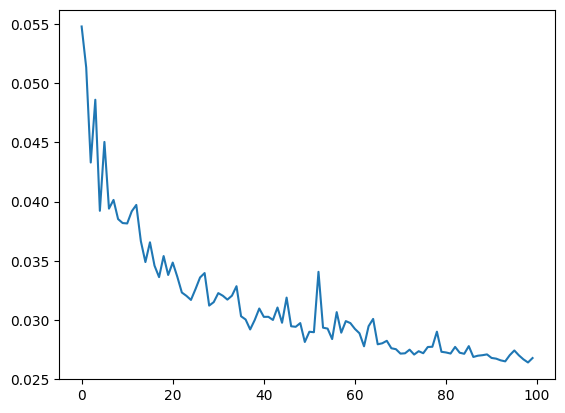

In [201]:
plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])

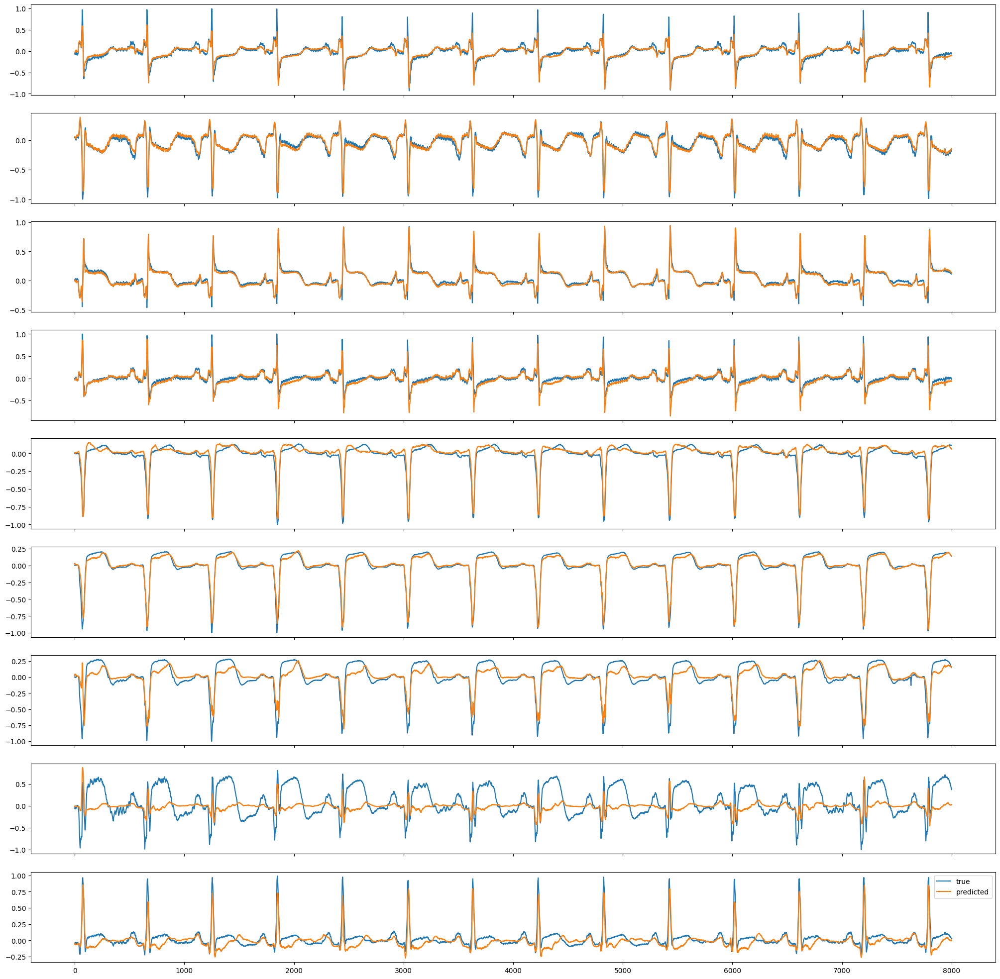

In [261]:
sample(generator, length=8000)

In [264]:
#compute_metrics(generator, 1, 'train')
compute_metrics(generator, X=X_5sec_train, y=y_5sec_train)

avg R2 score for III: 0.7507807612419128
avg R2 score for aVR: 0.9639900326728821
avg R2 score for aVL: 0.82807457447052
avg R2 score for aVF: 0.8883742690086365
avg R2 score for V1: 0.6309104561805725
avg R2 score for V3: 0.7453965544700623
avg R2 score for V4: 0.43547922372817993
avg R2 score for V5: 0.580811083316803
avg R2 score for V6: 0.6530442833900452
avg R2 score: 0.7196512222290039


In [223]:
torch.save(generator.state_dict(), 'best_generator.pt')

In [253]:
# state_dict = torch.load('best_generator.pt')
state_dict = torch.load('best_generator_PTBXL.pt')

In [254]:
generator = Generator(1, 1).to(device)
generator.load_state_dict(state_dict)

<All keys matched successfully>

In [204]:
numels = 0
for param in generator.parameters():
    numels += param.numel()
print(numels)

31374593


In [186]:
resampled_data_ptbdb = torch.zeros((totaldata_ptbdb.size(0),totaldata_ptbdb.size(1), int(totaldata_ptbdb.size(2)/2)))
for i in range(len(totaldata_ptbdb)):
    for j in range(len(leads)):
        resampled_data_ptbdb[i,j] = torch.tensor(scipy.signal.resample(totaldata_ptbdb[i,j], 15000), dtype=torch.float32)

In [187]:
clip_len = 76 # 152 or 664 are good values

X_ptbdb = resampled_data_ptbdb[:,:3,clip_len:-clip_len].unsqueeze(1)
y_ptbdb = resampled_data_ptbdb[:,3:,clip_len:-clip_len].unsqueeze(1)
X_ptbdb.shape, y_ptbdb.shape

(torch.Size([516, 1, 3, 14848]), torch.Size([516, 1, 9, 14848]))

Index: 468


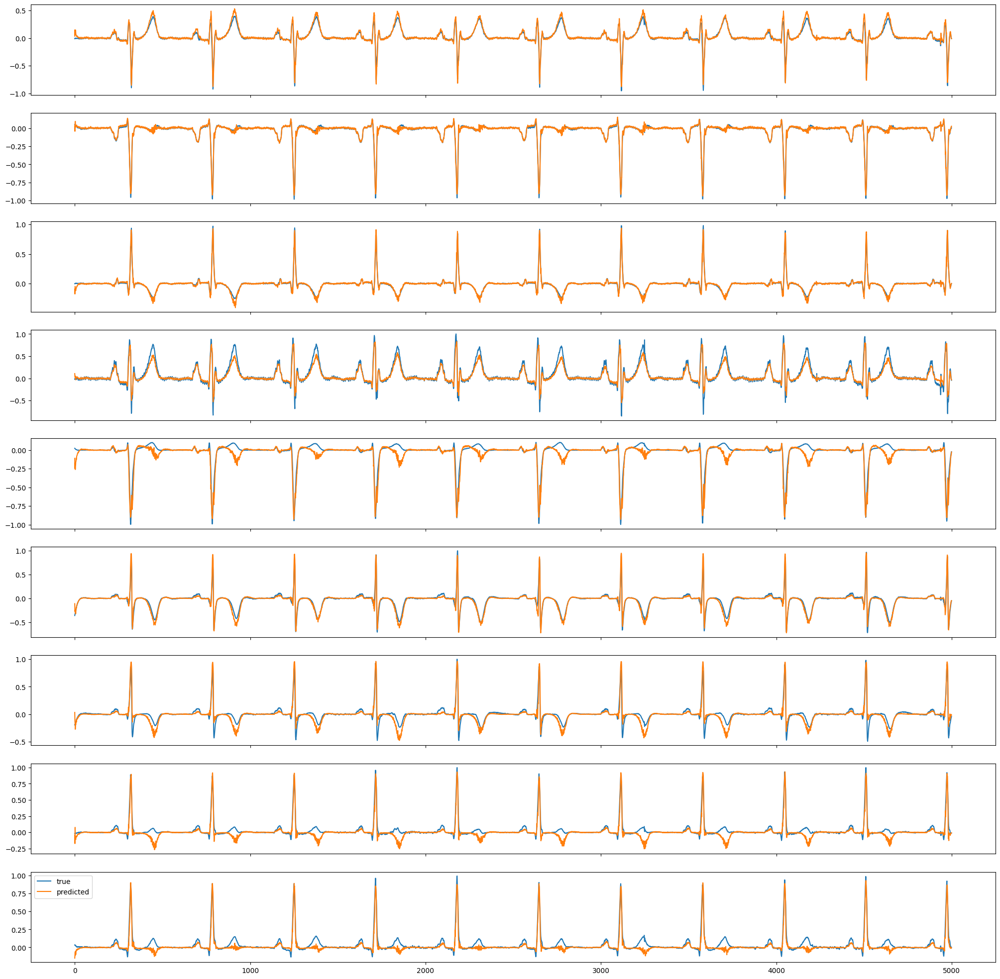

In [189]:
sample(generator, length=5000, X=X_ptbdb, y=y_ptbdb)

In [204]:
#compute_metrics(generator, 1, 'train')
compute_metrics(generator, X=X_ptbdb, y=y_ptbdb)

avg R2 score for III: 0.6403245329856873
avg R2 score for aVR: 0.9428824186325073
avg R2 score for aVL: 0.7691980004310608
avg R2 score for aVF: 0.8396093845367432
avg R2 score for V1: 0.7501299977302551
avg R2 score for V3: 0.8471052050590515
avg R2 score for V4: 0.44972118735313416
avg R2 score for V5: 0.5226466059684753
avg R2 score for V6: 0.5777164697647095
avg R2 score: 0.704370379447937


## SPHADB

In [285]:
import torch
import os
import copy
import scipy
import numpy as np
from matplotlib import pyplot as plt
#from denoise_WFDB import NLM_1dDarbon
from torcheval.metrics.functional import r2_score

In [1090]:
wfdb_df1 = pd.read_csv('snomed-ct.csv')
conditiondata_indices1 = dict.fromkeys(list(wfdb_df1['SNOMED CT Code']), [])
wfdb_df2 = pd.read_csv('ConditionNames_SNOMED-CT.csv')
conditiondata_indices2 = dict.fromkeys(list(wfdb_df2['Snomed_CT']), [])

In [1162]:
conditioncode_to_name_df1 = {x: y for x,y in zip(list(wfdb_df1['SNOMED CT Code']),list(wfdb_df1['Dx']))}
conditioncode_to_name_df2 = {x: y for x,y in zip(list(wfdb_df2['Snomed_CT']),list(wfdb_df2['Full Name']))}
conditioncode_to_name_df2.update(conditioncode_to_name_df1)
conditioncode_to_name_df2

{270492004: '1st degree av block',
 195042002: '2nd degree av block',
 54016002: 'mobitz type i wenckebach atrioventricular block',
 28189009: '2 degree atrioventricular block(Type two)',
 27885002: 'complete heart block',
 251173003: 'atrial bigeminy',
 39732003: 'left axis deviation',
 284470004: 'premature atrial contraction',
 164917005: 'qwave abnormal',
 47665007: 'right axis deviation',
 233917008: 'av block',
 251199005: 'countercolockwise rotation',
 251198002: 'colockwise rotation',
 428417006: 'early repolarization',
 164942001: 'fQRS Wave',
 698252002: 'nonspecific intraventricular conduction disorder',
 426995002: 'junctional escape',
 251164006: 'junctional premature complex',
 164909002: 'left bundle branch block',
 164873001: 'left ventricular hypertrophy',
 251146004: 'low qrs voltages',
 251148003: 'lower voltage QRS in chest lead',
 251147008: 'lower voltage QRS in limb lead',
 164865005: 'myocardial infarction',
 164947007: 'prolonged pr interval',
 164912004: 'P wa

In [1108]:
conditioncodeset = set(list(wfdb_df1['SNOMED CT Code']) + list(wfdb_df2['Snomed_CT']))
conditiondata_indices = {key: [] for key in conditioncodeset}


In [1120]:
wfdb_conditiondata_dir = "physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords"
unlabelled_pats = []
diagnosis_not_named = {}
for folder in os.listdir(wfdb_conditiondata_dir):
    i = os.path.join(wfdb_conditiondata_dir, folder)
    print(i)
    # checking if it is a dir
    for subfolder in os.listdir(i):
        j = os.path.join(i, subfolder)
        for file in os.listdir(j):
            k = os.path.join(j, file)
            # print(k)
            if k[-4:] == ".hea":
                with open(k) as header_file:
                    pat_id = k[-11:-4]
                    line = header_file.readlines()[-4]
                    for condition in line[5:-1].split(','):
                        # print(condition)
                        if int(condition) in conditiondata_indices:
                            conditiondata_indices[int(condition)].append(pat_id)
                            # print(conditiondata_indices[int(condition)])
                        else:
                            if int(condition) in diagnosis_not_named:
                                diagnosis_not_named[int(condition)].append(pat_id)
                            else:
                                diagnosis_not_named[int(condition)] = [pat_id]

physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/46
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/31
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/09
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/03
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/22
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/28
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/10
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/17
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/25
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/04
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/41
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/32
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/45
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/38
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/21
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/19
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRecords/13
physionet.org/files/ecg-arrhythmia/1.0.0/WFDBRec

In [1153]:
patlens_dict = {key: len(conditiondata_indices[key]) for key in conditiondata_indices}
patlens = list(patlens_dict.items())
patlens = sorted(patlens, key=lambda x: x[1], reverse=True)
patlens

[(426177001, 35618),
 (426783006, 16480),
 (164890007, 16191),
 (427084000, 14698),
 (164934002, 14580),
 (55930002, 8560),
 (59931005, 5931),
 (427393009, 5100),
 (164889003, 3803),
 (429622005, 3428),
 (39732003, 3135),
 (284470004, 2657),
 (428750005, 2460),
 (10370003, 2366),
 (270492004, 2308),
 (713427006, 2192),
 (427172004, 2182),
 (164917005, 2178),
 (251146004, 2139),
 (47665007, 1735),
 (164930006, 1643),
 (698252002, 1566),
 (426761007, 1448),
 (59118001, 1351),
 (164873001, 1312),
 (111975006, 798),
 (6374002, 770),
 (445118002, 760),
 (428417006, 735),
 (17338001, 622),
 (713422000, 594),
 (233917008, 507),
 (164909002, 505),
 (713426002, 492),
 (164931005, 381),
 (251199005, 347),
 (425856008, 304),
 (164912004, 297),
 (164937009, 286),
 (29320008, 278),
 (81898007, 268),
 (164865005, 252),
 (13640000, 238),
 (164896001, 232),
 (89792004, 220),
 (251198002, 160),
 (426995002, 153),
 (27885002, 152),
 (74390002, 144),
 (195042002, 132),
 (251170000, 124),
 (75532003, 117)

In [1125]:
pats_who_have_labelled_conditions = set()
for key in conditiondata_indices:
    pats_who_have_labelled_conditions.update(conditiondata_indices[key])
pats_who_dont_have_labelled_conditions = set()
for key in diagnosis_not_named:
    pats_who_dont_have_labelled_conditions.update(diagnosis_not_named[key]) 
print(len(pats_who_have_labelled_conditions))
print(len(pats_who_dont_have_labelled_conditions))

45010
7267


In [1127]:
if (pats_who_have_labelled_conditions & pats_who_dont_have_labelled_conditions):
    print(len(pats_who_have_labelled_conditions & pats_who_dont_have_labelled_conditions))
else:
    print("No common elements") 

7125


In [1130]:
diagnosis_not_named.keys()

dict_keys([61277005, 106068003, 233892002, 55827005, 251223006, 365413008, 67751000119106, 50799005, 61721007, 5609005, 251205003, 733534002, 17366009, 251166008, 418818005, 251187003, 426183003])

In [49]:
# WFDB_records = torch.load('WFDB_records.pt') # takes 47s
# #WFDB_records = torch.transpose(WFDB_records, 1,2)
# WFDB_records.shape

baseline_median_corrected_WFDB = torch.load('baseline_median_corrected_WFDB.pt') # takes 47s
#WFDB_records = torch.transpose(WFDB_records, 1,2)
baseline_median_corrected_WFDB.shape



torch.Size([43657, 12, 5000])

In [50]:
idx = torch.randperm(baseline_median_corrected_WFDB.size(0))
baseline_median_corrected_WFDB = baseline_median_corrected_WFDB[idx]
baseline_median_corrected_WFDB.shape


torch.Size([43657, 12, 5000])

In [397]:
# records_to_drop = []
# records_to_keep = []
# for record in range(len(WFDB_records)):
#     for lead in range(len(leads)):
#         if torch.sum(WFDB_records[record, lead].isnan()==True):
#             records_to_drop.append(record)
#             break
# for i in range(len(WFDB_records)):
#     if i not in records_to_drop:
#         records_to_keep.append(i)
# WFDB_records = WFDB_records[records_to_keep]
# WFDB_records.shape

In [ ]:
# for i in range(len(WFDB_records)):
#     for j in range(len(leads)):
#         temp = WFDB_records[i,j]
#         mfil1 = scipy.ndimage.median_filter(temp, size=int(fs/5))
#         mfil2 = scipy.ndimage.median_filter(mfil1, size=int(3*fs/5))
#         WFDB_records[i,j] = temp-mfil2

In [443]:
clip_len = 68 # 152 for 30k, 68 for 5k
num = int(0.95*baseline_median_corrected_WFDB.size(0))
X_test_WFDB = torch.cat((baseline_median_corrected_WFDB[num:,:2,clip_len:-clip_len], baseline_median_corrected_WFDB[num:,7,clip_len:-clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_test_WFDB = torch.cat((baseline_median_corrected_WFDB[num:,2:7,clip_len:-clip_len], baseline_median_corrected_WFDB[num:,8:,clip_len:-clip_len]), 1).unsqueeze(1)
X_train_WFDB = torch.cat((baseline_median_corrected_WFDB[:num,:2,clip_len:-clip_len], baseline_median_corrected_WFDB[:num,7,clip_len:-clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_train_WFDB = torch.cat((baseline_median_corrected_WFDB[:num,2:7,clip_len:-clip_len], baseline_median_corrected_WFDB[:num,8:,clip_len:-clip_len]), 1).unsqueeze(1)
X_train_WFDB.shape, y_train_WFDB.shape, X_test_WFDB.shape, y_test_WFDB.shape

(torch.Size([41474, 1, 3, 4864]),
 torch.Size([41474, 1, 9, 4864]),
 torch.Size([2183, 1, 3, 4864]),
 torch.Size([2183, 1, 9, 4864]))

In [444]:
# data normalization
for i in range(X_train_WFDB.size(0)):
    for j in range(3):
        #print(X_train_WFDB[i,0,j].shape)
        X_train_WFDB[i,0,j] = X_train_WFDB[i,0,j]/torch.max(torch.abs(X_train_WFDB[i,0,j]))
    for j in range(9):
        #print(y_train_WFDB[i,0,j].shape)
        y_train_WFDB[i,0,j] = y_train_WFDB[i,0,j]/torch.max(torch.abs(y_train_WFDB[i,0,j]))
for i in range(X_test_WFDB.size(0)):
    for j in range(3):
        #print(X_test_WFDB[i,0,j].shape)
        X_test_WFDB[i,0,j] = X_test_WFDB[i,0,j]/torch.max(torch.abs(X_test_WFDB[i,0,j]))
    for j in range(9):
        #print(y_5sec_train[i,0,j].shape)
        y_test_WFDB[i,0,j] = y_test_WFDB[i,0,j]/torch.max(torch.abs(y_test_WFDB[i,0,j]))
    #break

In [223]:
i = 15
j = 7
sphadb = y_test_WFDB[i,0]
ptbdb = y_test[i,0]
ptbxl = y_test_ptbxl[i,0]
incart = y_incart[i,0]
plt.subplots(6, 1, sharex='all', figsize=(25,18))
#plt.ylim(-3,3)
plt.subplot(6, 1, 1)
plt.plot(ptbdb[j][:4864], label='true')
plt.subplot(6, 1, 2)
plt.plot(scipy.signal.resample(ptbdb[j], 13348)[:4864], label='compare')
plt.subplot(6, 1, 3)
plt.plot(sphadb[j], label='compare')
plt.subplot(6, 1, 4)
plt.plot(ptbxl[j], label='compare')
plt.subplot(6, 1, 5)
plt.plot(scipy.signal.resample(incart[j], 13348)[:4864], label='compare')
plt.subplot(6, 1, 6)
plt.plot(incart[j][:4864], label='compare')

NameError: name 'y_test' is not defined

In [84]:
import torch
from torch.utils.data import TensorDataset, DataLoader

class CustomDataset(Dataset):
    def __init__(self, x_data, y_data):
        self.x_data = x_data
        self.y_data = y_data

    def __len__(self):
        return self.x_data.size(0)

    def __getitem__(self, idx):
        x = self.x_data[idx]
        y = self.y_data[idx]
        return x, y
        
# Create Dataset objects for training and testing data
#train_dataset = TensorDataset(X_5sec_train, y_5sec_train)
#test_dataset = TensorDataset(X_5sec_test, y_5sec_test)

train_dataset = CustomDataset(X_5sec_train_WFDB, y_5sec_train_WFDB)
test_dataset = CustomDataset(X_5sec_test_WFDB, y_5sec_test_WFDB)

# Create DataLoader objects for training and testing data
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, pin_memory=True)


In [94]:
generator = Generator(1, 1).to(device)
discriminator = PatchGANDiscriminator(2, 1).to(device)
# Loss functions
criterion_GAN = nn.BCEWithLogitsLoss()
criterion_L1 = nn.L1Loss()

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=0.00002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0000002, betas=(0.5, 0.999))

Epoch [1/100], Step [1]
L1 Loss: 0.6636795401573181, Gan Loss: 0.6399564743041992
Total D Loss: 0.7174891233444214, Total G Loss: 67.00790405273438
Epoch [1/100], Step [501]
L1 Loss: 0.06487410515546799, Gan Loss: 0.6557066440582275
Total D Loss: 0.7012004256248474, Total G Loss: 7.1431169509887695
Epoch [1/100], Step [1001]
L1 Loss: 0.051937036216259, Gan Loss: 0.6688640117645264
Total D Loss: 0.6984566450119019, Total G Loss: 5.862567901611328
Test Loss: 0.04813746362924576
Epoch [2/100], Step [1]
L1 Loss: 0.04655160754919052, Gan Loss: 0.6720440983772278
Total D Loss: 0.6985542178153992, Total G Loss: 5.327205181121826
Epoch [2/100], Step [501]
L1 Loss: 0.045049555599689484, Gan Loss: 0.6822906732559204
Total D Loss: 0.6973022818565369, Total G Loss: 5.187246322631836
Epoch [2/100], Step [1001]
L1 Loss: 0.04343066364526749, Gan Loss: 0.6908387541770935
Total D Loss: 0.6967018842697144, Total G Loss: 5.033905029296875
Test Loss: 0.039187218993902206


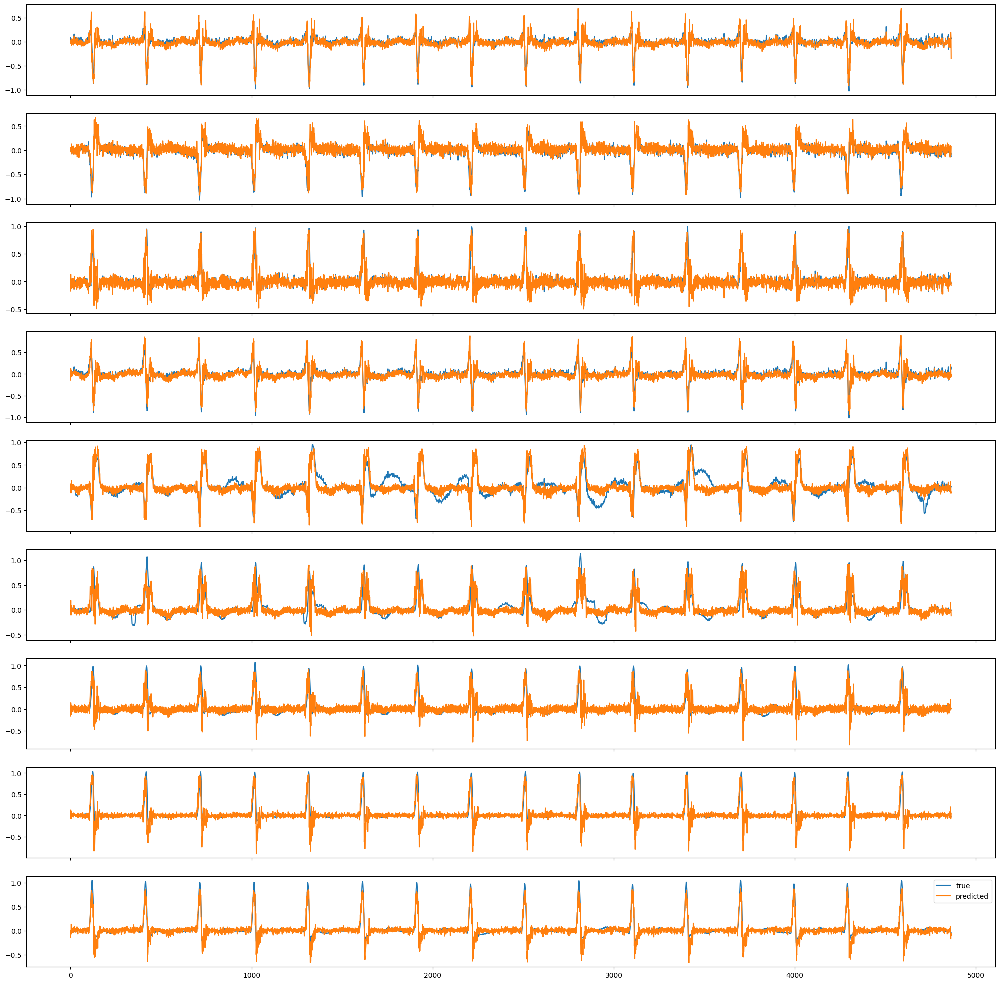

avg R2 score for III: 0.5410566329956055
avg R2 score for aVR: 0.8891271948814392
avg R2 score for aVL: 0.6039612889289856
avg R2 score for aVF: 0.7505554556846619
avg R2 score for V1: 0.5990299582481384
avg R2 score for V3: 0.6894046664237976
avg R2 score for V4: 0.6543979644775391
avg R2 score for V5: 0.7120726108551025
avg R2 score for V6: 0.6250922083854675
avg R2 score: 0.6738553047180176
Epoch [3/100], Step [1]
L1 Loss: 0.039498861879110336, Gan Loss: 0.69279545545578
Total D Loss: 0.6958271861076355, Total G Loss: 4.64268159866333
Epoch [3/100], Step [501]
L1 Loss: 0.03515804186463356, Gan Loss: 0.697429895401001
Total D Loss: 0.6946907043457031, Total G Loss: 4.213233947753906
Epoch [3/100], Step [1001]
L1 Loss: 0.035496786236763, Gan Loss: 0.700296938419342
Total D Loss: 0.693710446357727, Total G Loss: 4.249975681304932
Test Loss: 0.036407966166734695
Epoch [4/100], Step [1]
L1 Loss: 0.06471837311983109, Gan Loss: 0.6934491991996765
Total D Loss: 0.698804497718811, Total G Lo

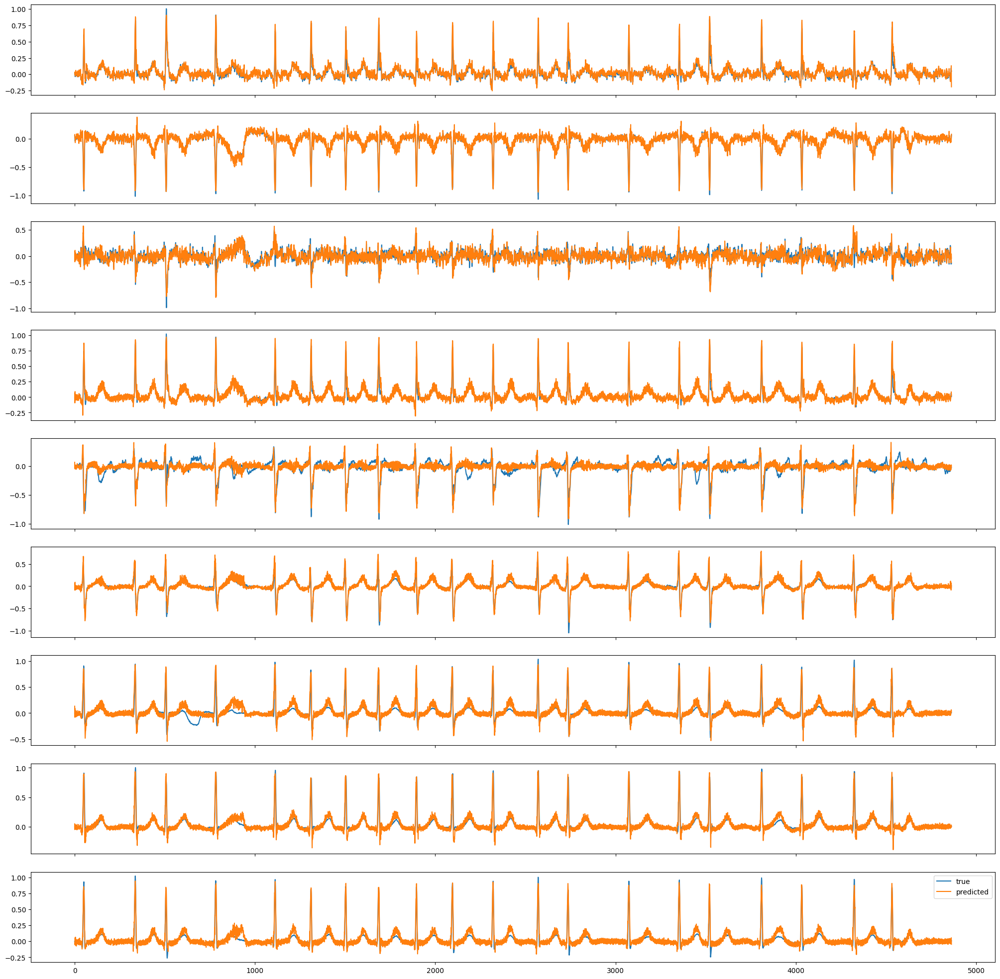

avg R2 score for III: 0.7861997485160828
avg R2 score for aVR: 0.9454450011253357
avg R2 score for aVL: 0.8180971741676331
avg R2 score for aVF: 0.89112389087677
avg R2 score for V1: 0.7255764007568359
avg R2 score for V3: 0.7667080163955688
avg R2 score for V4: 0.753006100654602
avg R2 score for V5: 0.7756507396697998
avg R2 score for V6: 0.7288504838943481
avg R2 score: 0.7989619374275208
Epoch [8/100], Step [1]
L1 Loss: 0.03302665799856186, Gan Loss: 0.6890375018119812
Total D Loss: 0.6885970830917358, Total G Loss: 3.9917032718658447
Epoch [8/100], Step [501]
L1 Loss: 0.03846615180373192, Gan Loss: 0.6894813179969788
Total D Loss: 0.6865819692611694, Total G Loss: 4.536096572875977
Epoch [8/100], Step [1001]
L1 Loss: 0.029279440641403198, Gan Loss: 0.717887282371521
Total D Loss: 0.6860966682434082, Total G Loss: 3.64583158493042
Test Loss: 0.030383700504899025
Epoch [9/100], Step [1]
L1 Loss: 0.04134669154882431, Gan Loss: 0.6818840503692627
Total D Loss: 0.6990526914596558, Total

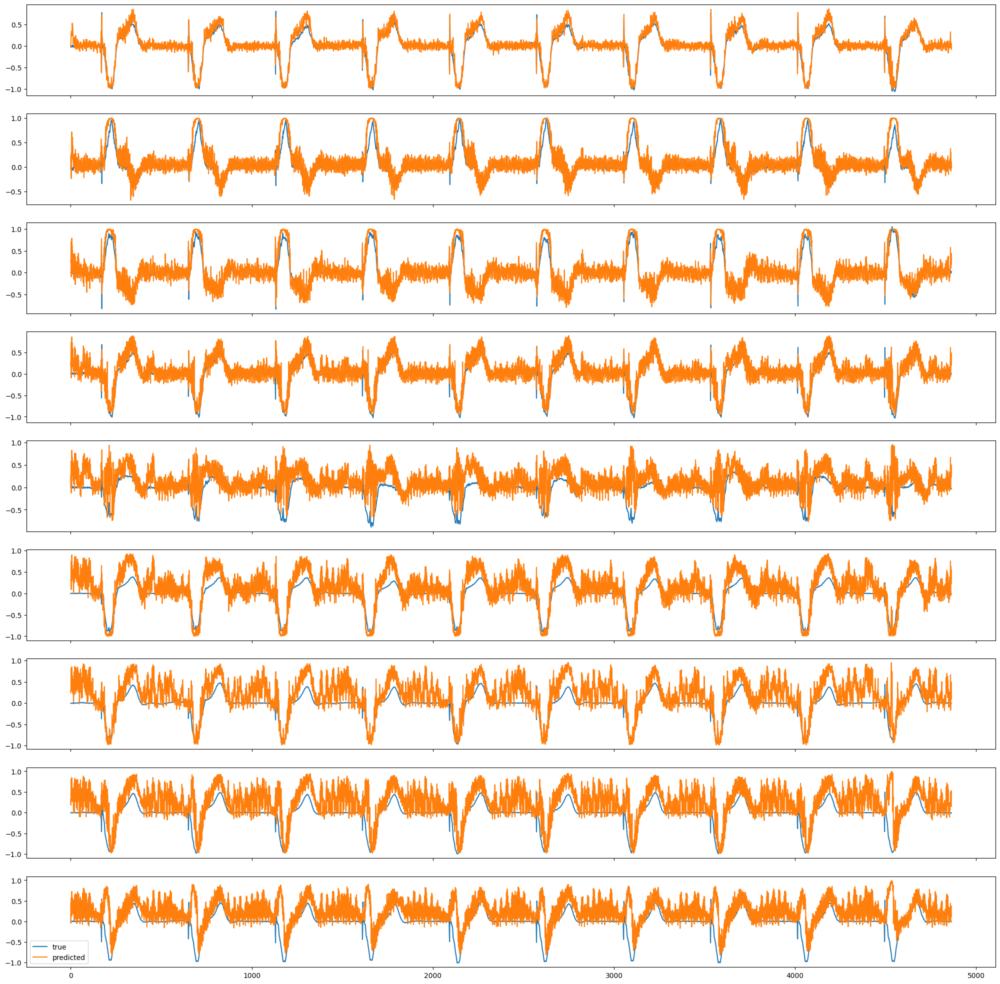

avg R2 score for III: 0.8291665315628052
avg R2 score for aVR: 0.9548142552375793
avg R2 score for aVL: 0.8607237935066223
avg R2 score for aVF: 0.8940090537071228
avg R2 score for V1: 0.6871203184127808
avg R2 score for V3: 0.7667332291603088
avg R2 score for V4: 0.750804603099823
avg R2 score for V5: 0.7505331039428711
avg R2 score for V6: 0.5866873264312744
avg R2 score: 0.7867324352264404
Epoch [13/100], Step [1]
L1 Loss: 0.02836780622601509, Gan Loss: 0.7095749378204346
Total D Loss: 0.682549238204956, Total G Loss: 3.5463554859161377
Epoch [13/100], Step [501]
L1 Loss: 0.02712852880358696, Gan Loss: 0.703980565071106
Total D Loss: 0.6828161478042603, Total G Loss: 3.4168334007263184
Epoch [13/100], Step [1001]
L1 Loss: 0.02656003087759018, Gan Loss: 0.7082870602607727
Total D Loss: 0.6834331750869751, Total G Loss: 3.3642899990081787
Test Loss: 0.02798302099108696
Epoch [14/100], Step [1]
L1 Loss: 0.03458760306239128, Gan Loss: 0.6750941872596741
Total D Loss: 0.7021933794021606,

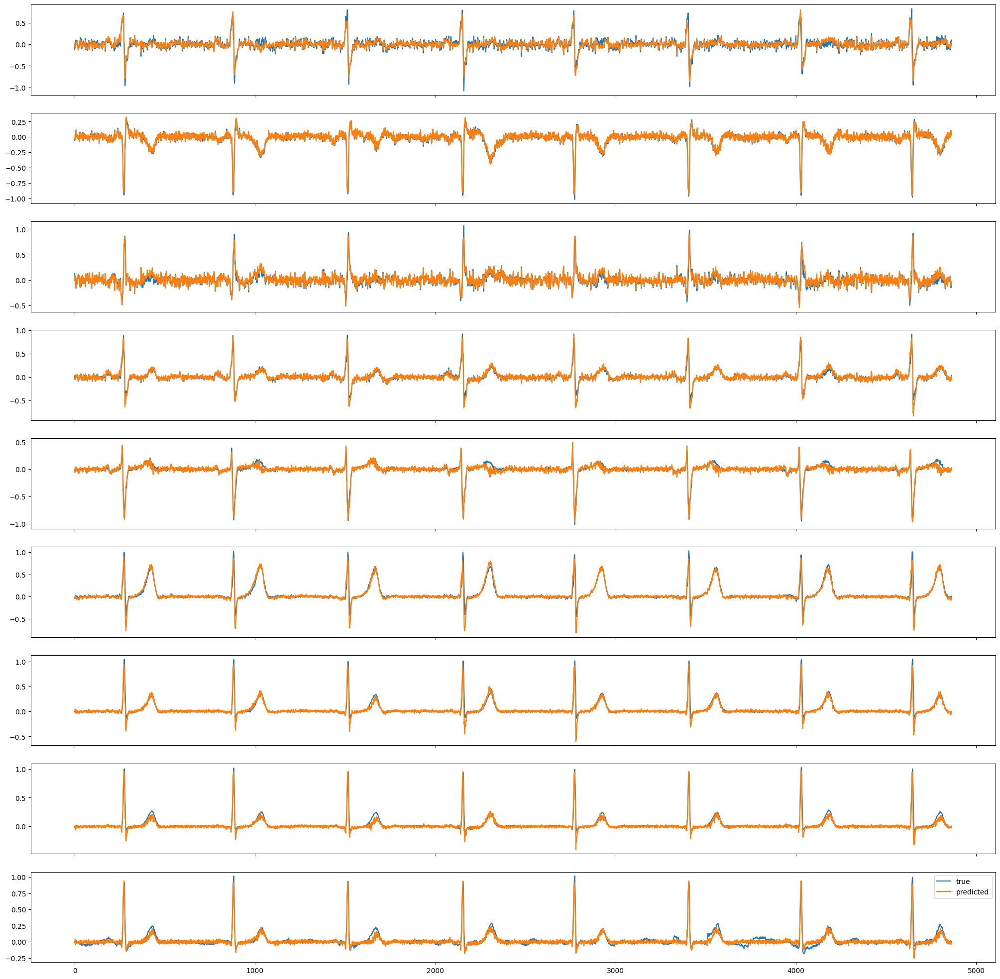

avg R2 score for III: 0.888975203037262
avg R2 score for aVR: 0.9698153138160706
avg R2 score for aVL: 0.8990879654884338
avg R2 score for aVF: 0.9379917979240417
avg R2 score for V1: 0.7204815149307251
avg R2 score for V3: 0.7878816723823547
avg R2 score for V4: 0.6970489025115967
avg R2 score for V5: 0.8035833239555359
avg R2 score for V6: 0.6726049780845642
avg R2 score: 0.8197189569473267
Epoch [18/100], Step [1]
L1 Loss: 0.023576106876134872, Gan Loss: 0.7224515676498413
Total D Loss: 0.6796668171882629, Total G Loss: 3.0800623893737793
Epoch [18/100], Step [501]
L1 Loss: 0.024375656619668007, Gan Loss: 0.7460144758224487
Total D Loss: 0.6742221117019653, Total G Loss: 3.183579921722412
Epoch [18/100], Step [1001]
L1 Loss: 0.02295663021504879, Gan Loss: 0.7201173901557922
Total D Loss: 0.6816427707672119, Total G Loss: 3.015780448913574
Test Loss: 0.026568593457341194
Epoch [19/100], Step [1]
L1 Loss: 0.03382302075624466, Gan Loss: 0.6516209840774536
Total D Loss: 0.70178925991058

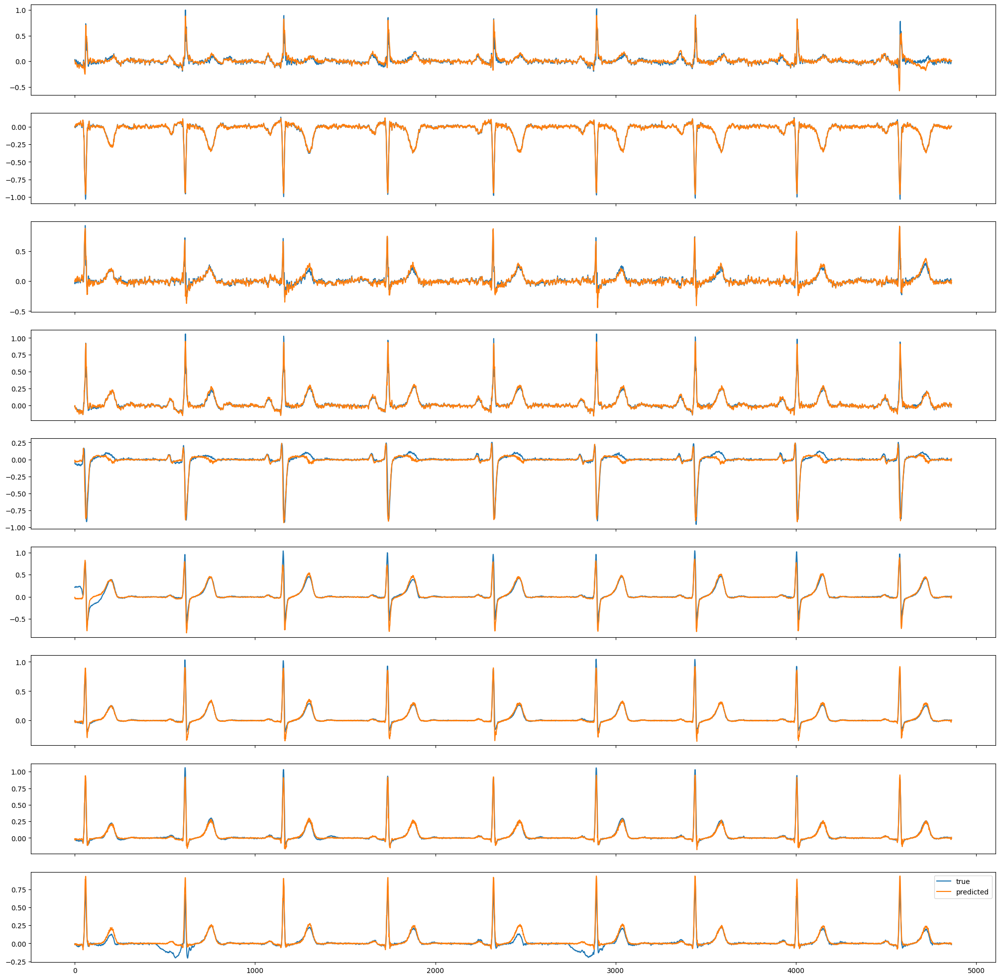

avg R2 score for III: 0.8920353651046753
avg R2 score for aVR: 0.9744943976402283
avg R2 score for aVL: 0.9035071134567261
avg R2 score for aVF: 0.9519832134246826
avg R2 score for V1: 0.745771050453186
avg R2 score for V3: 0.8148470520973206
avg R2 score for V4: 0.7957453727722168
avg R2 score for V5: 0.8226457834243774
avg R2 score for V6: 0.5812021493911743
avg R2 score: 0.8313590288162231
Epoch [23/100], Step [1]
L1 Loss: 0.024490509182214737, Gan Loss: 0.733340322971344
Total D Loss: 0.6658231616020203, Total G Loss: 3.1823911666870117
Epoch [23/100], Step [501]
L1 Loss: 0.024881010875105858, Gan Loss: 0.7426254153251648
Total D Loss: 0.6642558574676514, Total G Loss: 3.230726480484009
Epoch [23/100], Step [1001]
L1 Loss: 0.024469682946801186, Gan Loss: 0.7419320344924927
Total D Loss: 0.6684908270835876, Total G Loss: 3.1889004707336426
Test Loss: 0.02602468617260456
Epoch [24/100], Step [1]
L1 Loss: 0.02960430085659027, Gan Loss: 0.6619953513145447
Total D Loss: 0.70029789209365

KeyboardInterrupt: 

In [95]:
# Training
num_epochs = 100
N = 100
test_losses = []

for epoch in range(num_epochs):
    for i, (input_img, target_img) in enumerate(train_loader):
        input_img = input_img.to(device)
        target_img = target_img.to(device)

        # Train Discriminator
        optimizer_D.zero_grad()
        fake_img = generator(input_img)
        real_output = discriminator(input_img, target_img)
        fake_output = discriminator(input_img, fake_img.detach())
        real_loss = criterion_GAN(real_output, torch.ones_like(real_output))
        fake_loss = criterion_GAN(fake_output, torch.zeros_like(fake_output))
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        fake_output = discriminator(input_img, fake_img)
        gan_loss = criterion_GAN(fake_output, torch.ones_like(fake_output))
        l1_loss = criterion_L1(fake_img, target_img)
        g_loss = gan_loss + N * l1_loss
        g_loss.backward()
        optimizer_G.step()
            
        if (i % 500 == 0):
            print(f"Epoch [{epoch+1}/{num_epochs}], Step [{i+1}]")
            print(f"L1 Loss: {l1_loss.item()}, Gan Loss: {gan_loss.item()}")
            print(f"Total D Loss: {d_loss.item()}, Total G Loss: {g_loss.item()}")
            
    
    with torch.no_grad():
        generator.eval()
        discriminator.eval()
        l1_test_loss = []
        for input_img, target_img in test_loader:
            input_img = input_img.to(device)
            patient_true = target_img.to(device)
            #print(f"patient {index} from test set")
            patient_pred = generator(input_img)
            l1_test_loss.append(criterion_L1(patient_pred, patient_true))

        epoch_avg_test_loss = sum(l1_test_loss)/len(l1_test_loss)
        print(f"Test Loss: {epoch_avg_test_loss}")
        #g_loss = gan_loss + N * l1_loss
        test_losses.append(epoch_avg_test_loss)
        # if epoch > 10 and epoch_avg_test_loss > sum(test_losses)/len(test_losses):
        #     print(f"Stopped Early at Epoch: {epoch}")
        #     break
        
    generator.train()
    discriminator.train()

    if (epoch % 5) == True:
        sample(generator, X=X_5sec_test_WFDB, y=y_5sec_test_WFDB)
        compute_metrics(generator, X=X_5sec_test_WFDB, y=y_5sec_test_WFDB, num_preds_ratio = 0.2)
print("Training finished.")

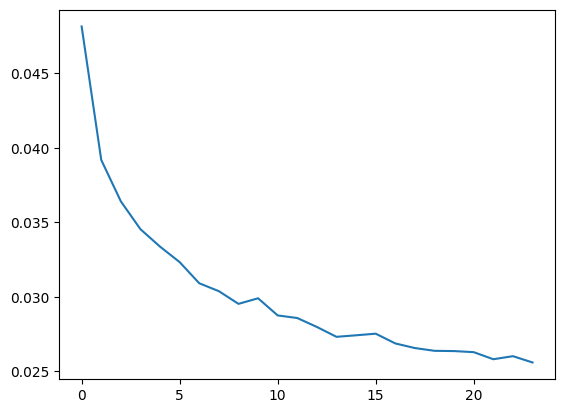

In [206]:
plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])

In [ ]:
sample(generator, X=X_5sec_test_WFDB, y=y_5sec_test_WFDB)

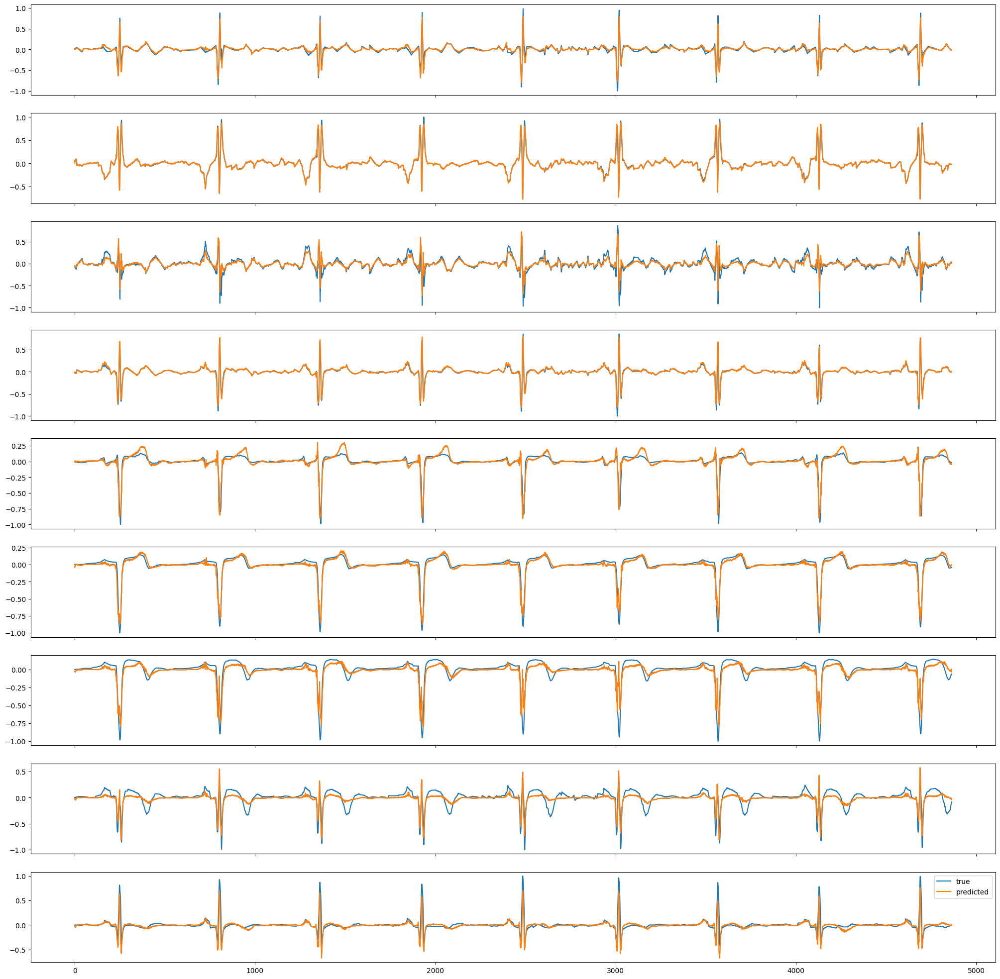

In [102]:
sample(generator, X=X_5sec_ptbxl, y=y_5sec_ptbxl)

In [99]:
X_5sec_ptbxl = torch.cat((X_5sec_test_ptbxl,X_5sec_train_ptbxl))
y_5sec_ptbxl = torch.cat((y_5sec_test_ptbxl,y_5sec_train_ptbxl))
y_5sec_ptbxl.shape, X_5sec_ptbxl.shape

(torch.Size([21798, 1, 9, 4864]), torch.Size([21798, 1, 3, 4864]))

In [124]:
compute_metrics(generator, X=X_5sec_test_WFDB, y=y_5sec_test_WFDB, num_preds_ratio = 1)

avg R2 score for III: 0.9038388133049011
avg R2 score for aVR: 0.976728081703186
avg R2 score for aVL: 0.9132106304168701
avg R2 score for aVF: 0.9544726610183716
avg R2 score for V1: 0.7486740946769714
avg R2 score for V3: 0.8028077483177185
avg R2 score for V4: 0.7661269903182983
avg R2 score for V5: 0.8021354079246521
avg R2 score for V6: 0.6893962621688843
avg R2 score: 0.8397100567817688


In [125]:
compute_metrics(generator, X=X_5sec_ptbxl, y=y_5sec_ptbxl, num_preds_ratio = 1)

avg R2 score for III: 0.8194854259490967
avg R2 score for aVR: 0.9726020693778992
avg R2 score for aVL: 0.9054783582687378
avg R2 score for aVF: 0.8962482213973999
avg R2 score for V1: 0.8173227906227112
avg R2 score for V3: 0.7867116928100586
avg R2 score for V4: 0.7351711392402649
avg R2 score for V5: 0.8004864454269409
avg R2 score for V6: 0.8409645557403564
avg R2 score: 0.841607928276062


In [ ]:
torch.save(generator.state_dict(), 'generator_v3.pt')

## INCART

In [363]:
mainfolder = "incart_orig"
leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
conditiondata = {'Train': [], 'Test': []}
for folder in os.listdir(mainfolder):
    i = os.path.join(mainfolder, folder)
    # checking if it is a dir
    if not os.path.isfile(i):
        j1 = os.path.join(i, 'RL3')
        j2 = os.path.join(i, 'SL9')
        for patient in os.listdir(j1):
            k1 = os.path.join(j1, patient)
            k2 = os.path.join(j2, patient)
            RL3data = torch.tensor(io.loadmat(k1)['val_RL3'], dtype=torch.float32)
            SL9data = torch.tensor(io.loadmat(k2)['val_SL9'], dtype=torch.float32)
            conditiondata[folder].append(torch.cat((RL3data,SL9data), 0))

for key in conditiondata:
    conditiondata[key] = torch.stack(conditiondata[key], 0)


In [364]:
totaldata_incart = torch.cat([conditiondata[condition] for condition in conditiondata], dim=0)
totaldata_incart.shape

torch.Size([74, 12, 30000])

In [365]:
records_to_drop = [70, 63, 42, 19] # bad incart data
records_to_keep = []
for i in range(len(totaldata_incart)):
    if i not in records_to_drop:
        records_to_keep.append(i)
totaldata_incart = totaldata_incart[records_to_keep]
totaldata_incart.shape

torch.Size([70, 12, 30000])

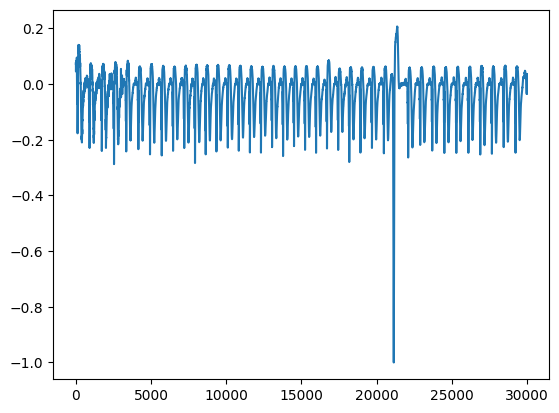

In [369]:
plt.plot(totaldata_incart[42, 9])

In [370]:
resampled_data_incart = torch.zeros((totaldata_incart.size(0),totaldata_incart.size(1), int(totaldata_incart.size(2)/2)))
for i in range(len(totaldata_incart)):
    for j in range(len(leads)):
        resampled_data_incart[i,j] = torch.tensor(scipy.signal.resample(totaldata_incart[i,j], 15000), dtype=torch.float32)

In [371]:
clip_len = 76 # 152 or 664 are good values

X_incart = resampled_data_incart[:,:3,clip_len:-clip_len].unsqueeze(1)
y_incart = resampled_data_incart[:,3:,clip_len:-clip_len].unsqueeze(1)

# data normalization
for i in range(X_incart.size(0)):
    for j in range(3):
        #print(X_incart[i,0,j].shape)
        X_incart[i,0,j] = X_incart[i,0,j]/torch.max(torch.abs(X_incart[i,0,j]))
    for j in range(9):
        #print(y_incart[i,0,j].shape)
        y_incart[i,0,j] = y_incart[i,0,j]/torch.max(torch.abs(y_incart[i,0,j]))
        
X_incart.shape, y_incart.shape

(torch.Size([70, 1, 3, 14848]), torch.Size([70, 1, 9, 14848]))

In [313]:
X_incart[9]

tensor([[[-3.2812e-03,  1.1600e-03, -1.5335e-03,  ...,  1.8200e-02,
           2.3757e-02,  2.6441e-02],
         [ 3.9488e-03,  3.5564e-03,  5.7503e-04,  ...,  1.8022e-02,
           1.9919e-02,  1.8253e-02],
         [-1.2015e-03,  2.2050e-05, -4.9307e-04,  ..., -8.0532e-03,
          -7.2910e-03, -7.1886e-03]]])

Index: 18


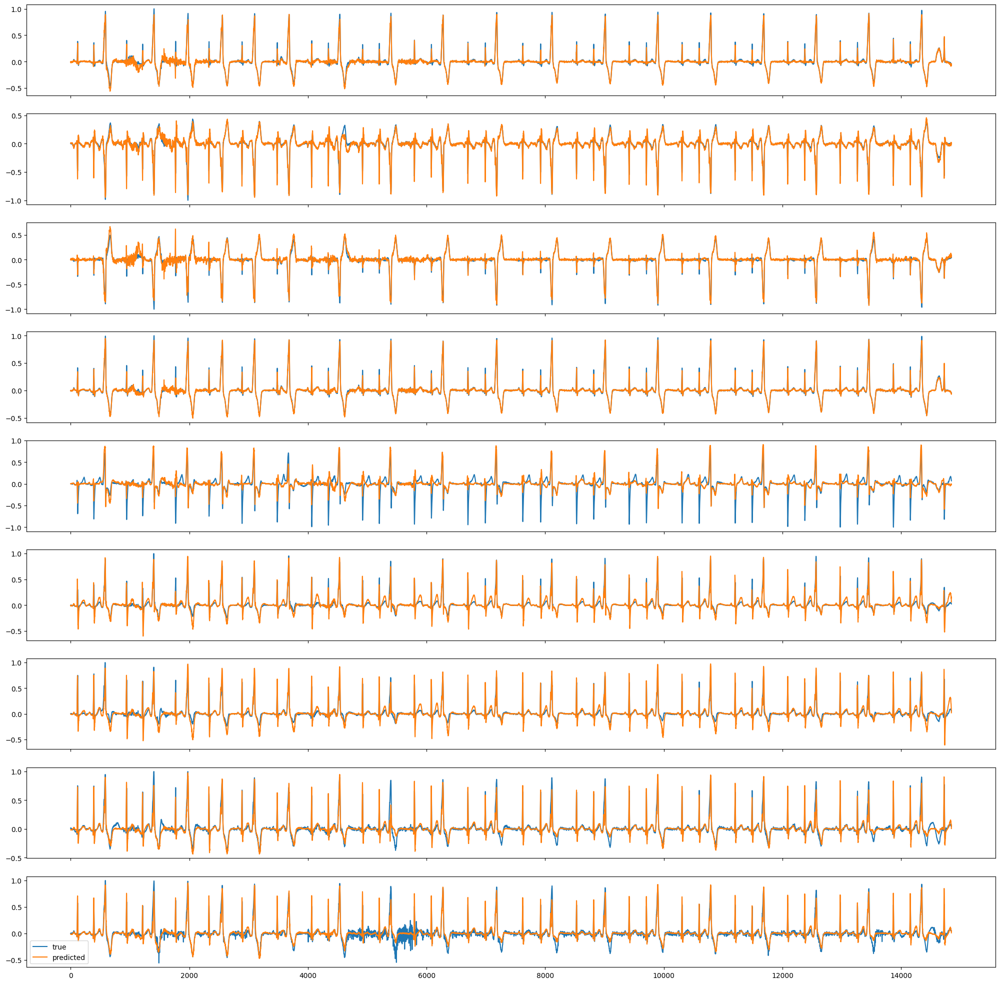

In [385]:
sample(generator, X=X_incart, y=y_incart)

In [383]:
# generator.eval()
# #patient_pred = generator(X[index].unsqueeze(0).to(device))[0,0].detach().cpu()
# #plt.ylim(-3,3)
# totalnum = y_incart.size(0)
# test_num_patients = y_incart.size(0)
# avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
# avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
# for index in range(totalnum):
#     #print(f"patient {index} from test set")
#     patient_true = y_incart[index,0]
#     patient_pred = generator(X_incart[index].unsqueeze(0).to(device))[0,0].detach().cpu()
#     for i in range(9):
#         # z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
#         # avg_pearsoncorr_score[leads[i + 3]] += z[0,1]/test_num_patients
#         add = r2_score(patient_pred[i], patient_true[i])
#         if add < -10:
#             print(f"Index: {index}, r2 score for lead {i}: {add}")
#         avg_r2_score[leads[i + 3]] += add/test_num_patients
#         #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
# for i in range(9):
#     #print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
#     print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
# print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")
compute_metrics(generator, X=X_incart, y=y_incart, num_preds_ratio=1)

avg R2 score for III: 0.8711850643157959
avg R2 score for aVR: 0.9494729042053223
avg R2 score for aVL: 0.6764934062957764
avg R2 score for aVF: 0.9580355882644653
avg R2 score for V1: 0.8199995756149292
avg R2 score for V3: 0.5988643169403076
avg R2 score for V4: 0.27436983585357666
avg R2 score for V5: 0.41710856556892395
avg R2 score for V6: 0.622867226600647
avg R2 score: 0.6875995993614197


## PTBXL

In [432]:
train_ptbxl = torch.tensor(np.load('baseline_corrected_X_train.npy'), dtype=torch.float32)
#y_train = np.load('baseline_corrected_y_train.npy', allow_pickle=True)
test_ptbxl = torch.tensor(np.load('baseline_corrected_X_test.npy'), dtype=torch.float32)
#y_test = np.load('baseline_corrected_y_test.npy', allow_pickle=True)
train_ptbxl = torch.transpose(train_ptbxl, 1,2)
test_ptbxl = torch.transpose(test_ptbxl, 1,2)

train_ptbxl = torch.cat((train_ptbxl[:11278],train_ptbxl[11279:])) # sus point

print(train_ptbxl.shape)
print(test_ptbxl.shape)

torch.Size([19600, 12, 5000])
torch.Size([2198, 12, 5000])


In [433]:
clip_len = 68 # 152 for 30k, 68 for 5k

X_test_ptbxl = torch.cat((test_ptbxl[:,:2,clip_len:-clip_len], test_ptbxl[:,7,clip_len:-clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_test_ptbxl = torch.cat((test_ptbxl[:,2:7,clip_len:-clip_len], test_ptbxl[:,8:,clip_len:-clip_len]), 1).unsqueeze(1)
X_train_ptbxl = torch.cat((train_ptbxl[:,:2,clip_len:-clip_len], train_ptbxl[:,7,clip_len:-clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_train_ptbxl = torch.cat((train_ptbxl[:,2:7,clip_len:-clip_len], train_ptbxl[:,8:,clip_len:-clip_len]), 1).unsqueeze(1)
X_train_ptbxl.shape, y_train_ptbxl.shape, X_test_ptbxl.shape, y_test_ptbxl.shape

(torch.Size([19600, 1, 3, 4864]),
 torch.Size([19600, 1, 9, 4864]),
 torch.Size([2198, 1, 3, 4864]),
 torch.Size([2198, 1, 9, 4864]))

In [434]:
# data normalization
for i in range(X_train_ptbxl.size(0)):
    for j in range(3):
        #print(X_train_ptbxl[i,0,j].shape)
        X_train_ptbxl[i,0,j] = X_train_ptbxl[i,0,j]/torch.max(torch.abs(X_train_ptbxl[i,0,j]))
    for j in range(9):
        #print(y_train_ptbxl[i,0,j].shape)
        y_train_ptbxl[i,0,j] = y_train_ptbxl[i,0,j]/torch.max(torch.abs(y_train_ptbxl[i,0,j]))
for i in range(X_test_ptbxl.size(0)):
    for j in range(3):
        #print(X_test_ptbxl[i,0,j].shape)
        X_test_ptbxl[i,0,j] = X_test_ptbxl[i,0,j]/torch.max(torch.abs(X_test_ptbxl[i,0,j]))
    for j in range(9):
        #print(y_train_ptbxl[i,0,j].shape)
        y_test_ptbxl[i,0,j] = y_test_ptbxl[i,0,j]/torch.max(torch.abs(y_test_ptbxl[i,0,j]))
    #break

In [439]:
records_to_drop = []
records_to_keep = []
for record in range(len(y_test_ptbxl)):
    for lead in range(9):
        if torch.sum(y_test_ptbxl[record,0, lead].isnan()==True):
            records_to_drop.append(record)
            break
for i in range(len(y_test_ptbxl)):
    if i not in records_to_drop:
        records_to_keep.append(i)
records_to_drop
# WFDB_records = WFDB_records[records_to_keep]
# WFDB_records.shape

[]

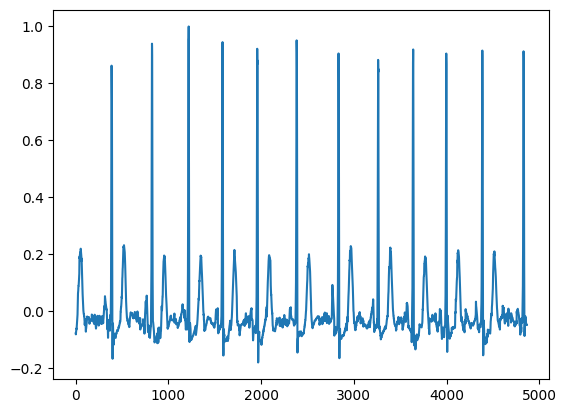

In [440]:
plt.plot(y_train_ptbxl[12,0,3])

## Putting it all together

In [33]:
import torch
import os
from scipy import io
import scipy
import numpy as np
from matplotlib import pyplot as plt
#from wandb.keras import WandbMetricsLogger, WandbModelCheckpoint
import tqdm
from torcheval.metrics.functional import r2_score
import copy

torch.manual_seed(1337)
devices = [torch.device("cuda:0"), torch.device("cuda:1")]
device = devices[0]
device_type = 'cuda' # for later use in torch.autocast

### Data Prep

In [2]:
# data prep
ptbdb_mainfolder = "dump_data"
leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
ptbdb_conditiondata = {'BB': [], 'HC': [], 'HY' : [], 'MI': [], 'ND': [],'VA': []}
for folder in os.listdir(ptbdb_mainfolder):
    i = os.path.join(ptbdb_mainfolder, folder)
    # checking if it is a dir
    if not os.path.isfile(i):
        j1 = os.path.join(i, 'RL3')
        j2 = os.path.join(i, 'SL9')
        for patient in os.listdir(j1):
            k1 = os.path.join(j1, patient)
            k2 = os.path.join(j2, patient)
            RL3data = torch.tensor(io.loadmat(k1)['val_RL3'], dtype=torch.float32)
            SL9data = torch.tensor(io.loadmat(k2)['val_SL9'], dtype=torch.float32)
            ptbdb_conditiondata[folder].append(torch.cat((RL3data,SL9data), 0))

for key in ptbdb_conditiondata:
    ptbdb_conditiondata[key] = torch.stack(ptbdb_conditiondata[key], 0)

d0 = sum([ptbdb_conditiondata[key].shape[0] for key in ptbdb_conditiondata])
r_ptbdb = 0.465 # proportion of time/people taken for training
d1 = 30000
illness_wise_patient_nums = [len(ptbdb_conditiondata[condition]) for condition in ptbdb_conditiondata]
totaldata_ptbdb = torch.cat([ptbdb_conditiondata[condition] for condition in ptbdb_conditiondata], dim=0)
traindata_ptbdb = torch.cat([ptbdb_conditiondata[condition][:round(r_ptbdb*len(ptbdb_conditiondata[condition]))] for condition in ptbdb_conditiondata], dim=0)
testdata_ptbdb = torch.cat([ptbdb_conditiondata[condition][round(r_ptbdb*len(ptbdb_conditiondata[condition])):] for condition in ptbdb_conditiondata], dim=0)

resampled_testdata_ptbdb = torch.zeros((testdata_ptbdb.size(0),testdata_ptbdb.size(1), int(testdata_ptbdb.size(2)/2)))
for i in range(len(testdata_ptbdb)):
    for j in range(len(leads)):
        resampled_testdata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(testdata_ptbdb[i,j], 15000), dtype=torch.float32)

resampled_traindata_ptbdb = torch.zeros((traindata_ptbdb.size(0),traindata_ptbdb.size(1), int(traindata_ptbdb.size(2)/2)))
for i in range(len(traindata_ptbdb)):
    for j in range(len(leads)):
        resampled_traindata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(traindata_ptbdb[i,j], 15000), dtype=torch.float32)


train_idx = torch.randperm(resampled_traindata_ptbdb.size(0))
test_idx = torch.randperm(resampled_testdata_ptbdb.size(0))
resampled_traindata_ptbdb = resampled_traindata_ptbdb[train_idx]
resampled_testdata_ptbdb = resampled_testdata_ptbdb[test_idx]
ptbdb_clip_len = 12

X_test_ptbdb = resampled_testdata_ptbdb[:,:3,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
y_test_ptbdb = resampled_testdata_ptbdb[:,3:,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
X_train_ptbdb = resampled_traindata_ptbdb[:,:3,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
y_train_ptbdb = resampled_traindata_ptbdb[:,3:,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)

# # data normalization
# for i in range(X_train_ptbdb.size(0)):
#     for j in range(3):
#         #print(X_train_ptbdb[i,0,j].shape)
#         X_train_ptbdb[i,0,j] = X_train_ptbdb[i,0,j]/torch.max(torch.abs(X_train_ptbdb[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbdb[i,0,j].shape)
#         y_train_ptbdb[i,0,j] = y_train_ptbdb[i,0,j]/torch.max(torch.abs(y_train_ptbdb[i,0,j]))
# for i in range(X_test_ptbdb.size(0)):
#     for j in range(3):
#         #print(X_test_ptbdb[i,0,j].shape)
#         X_test_ptbdb[i,0,j] = X_test_ptbdb[i,0,j]/torch.max(torch.abs(X_test_ptbdb[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbdb[i,0,j].shape)
#         y_test_ptbdb[i,0,j] = y_test_ptbdb[i,0,j]/torch.max(torch.abs(y_test_ptbdb[i,0,j]))

# data normalization
for i in range(X_train_ptbdb.size(0)):
    for j in range(3):
        if torch.max(X_train_ptbdb[i,0,j]) - torch.min(X_train_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j}")
        #print(X_train_ptbdb[i,0,j].shape)
        X_train_ptbdb[i,0,j] = (X_train_ptbdb[i,0,j]-torch.mean(X_train_ptbdb[i,0,j]))/(torch.max(X_train_ptbdb[i,0,j]) - torch.min(X_train_ptbdb[i,0,j]))
    for j in range(9):
        if torch.max(y_train_ptbdb[i,0,j]) - torch.min(y_train_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j+3}")
        #print(y_train_ptbdb[i,0,j].shape)
        y_train_ptbdb[i,0,j] = (y_train_ptbdb[i,0,j]-torch.mean(y_train_ptbdb[i,0,j]))/(torch.max(y_train_ptbdb[i,0,j]) - torch.min(y_train_ptbdb[i,0,j]))
for i in range(X_test_ptbdb.size(0)):
    for j in range(3):
        if torch.max(X_test_ptbdb[i,0,j]) - torch.min(X_test_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j}")
        #print(X_test_ptbdb[i,0,j].shape)
        X_test_ptbdb[i,0,j] = (X_test_ptbdb[i,0,j]-torch.mean(X_test_ptbdb[i,0,j]))/(torch.max(X_test_ptbdb[i,0,j]) - torch.min(X_test_ptbdb[i,0,j]))
    for j in range(9):
        if torch.max(y_test_ptbdb[i,0,j]) - torch.min(y_test_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j+3}")
        #print(y_train_ptbdb[i,0,j].shape)
        y_test_ptbdb[i,0,j] = (y_test_ptbdb[i,0,j]-torch.mean(y_test_ptbdb[i,0,j]))/(torch.max(y_test_ptbdb[i,0,j]) - torch.min(y_test_ptbdb[i,0,j]))
    #break

In [90]:
train_ptbxl = torch.tensor(np.load('medfilt_baseline_corrected_X_train.npy'), dtype=torch.float32)
#y_train = np.load('baseline_corrected_y_train.npy', allow_pickle=True)
test_ptbxl = torch.tensor(np.load('medfilt_baseline_corrected_X_test.npy'), dtype=torch.float32)
#y_test = np.load('baseline_corrected_y_test.npy', allow_pickle=True)
# train_ptbxl = torch.transpose(train_ptbxl, 1,2)
# test_ptbxl = torch.transpose(test_ptbxl, 1,2)

train_ptbxl = torch.cat((train_ptbxl[:11278],train_ptbxl[11279:])) # sus point
ptbxl_clip_len = 4 # 152 for 30k, 68 for 5k

X_test_ptbxl = torch.cat((test_ptbxl[:,:2,ptbxl_clip_len:-ptbxl_clip_len], test_ptbxl[:,7,ptbxl_clip_len:-ptbxl_clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_test_ptbxl = torch.cat((test_ptbxl[:,2:7,ptbxl_clip_len:-ptbxl_clip_len], test_ptbxl[:,8:,ptbxl_clip_len:-ptbxl_clip_len]), 1).unsqueeze(1)
X_train_ptbxl = torch.cat((train_ptbxl[:,:2,ptbxl_clip_len:-ptbxl_clip_len], train_ptbxl[:,7,ptbxl_clip_len:-ptbxl_clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_train_ptbxl = torch.cat((train_ptbxl[:,2:7,ptbxl_clip_len:-ptbxl_clip_len], train_ptbxl[:,8:,ptbxl_clip_len:-ptbxl_clip_len]), 1).unsqueeze(1)

# # data normalization
# for i in range(X_train_ptbxl.size(0)):
#     for j in range(3):
#         #print(X_train_ptbxl[i,0,j].shape)
#         X_train_ptbxl[i,0,j] = X_train_ptbxl[i,0,j]/torch.max(torch.abs(X_train_ptbxl[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbxl[i,0,j].shape)
#         y_train_ptbxl[i,0,j] = y_train_ptbxl[i,0,j]/torch.max(torch.abs(y_train_ptbxl[i,0,j]))
# for i in range(X_test_ptbxl.size(0)):
#     for j in range(3):
#         #print(X_test_ptbxl[i,0,j].shape)
#         X_test_ptbxl[i,0,j] = X_test_ptbxl[i,0,j]/torch.max(torch.abs(X_test_ptbxl[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbxl[i,0,j].shape)
#         y_test_ptbxl[i,0,j] = y_test_ptbxl[i,0,j]/torch.max(torch.abs(y_test_ptbxl[i,0,j]))
#     #break

# data normalization
for i in range(X_train_ptbxl.size(0)):
    for j in range(3):
        if torch.max(X_train_ptbxl[i,0,j]) - torch.min(X_train_ptbxl[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j}")
        #print(X_train_ptbxl[i,0,j].shape)
        X_train_ptbxl[i,0,j] = (X_train_ptbxl[i,0,j]-torch.mean(X_train_ptbxl[i,0,j]))/(torch.max(X_train_ptbxl[i,0,j]) - torch.min(X_train_ptbxl[i,0,j]))
        if torch.isnan(X_train_ptbxl[i,0,j]).any():
            print(f"nan error at index {i}, xtrain lead {j}")
    for j in range(9):
        if torch.max(y_train_ptbxl[i,0,j]) - torch.min(y_train_ptbxl[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j+3}")
        #print(y_train_ptbxl[i,0,j].shape)
        y_train_ptbxl[i,0,j] = (y_train_ptbxl[i,0,j]-torch.mean(y_train_ptbxl[i,0,j]))/(torch.max(y_train_ptbxl[i,0,j]) - torch.min(y_train_ptbxl[i,0,j]))
        if torch.isnan(y_train_ptbxl[i,0,j]).any():
            print(f"nan error at index {i}, ytrain lead {j}")
for i in range(X_test_ptbxl.size(0)):
    for j in range(3):
        if torch.max(X_test_ptbxl[i,0,j]) - torch.min(X_test_ptbxl[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j}")
        #print(X_test_ptbxl[i,0,j].shape)
        X_test_ptbxl[i,0,j] = (X_test_ptbxl[i,0,j]-torch.mean(X_test_ptbxl[i,0,j]))/(torch.max(X_test_ptbxl[i,0,j]) - torch.min(X_test_ptbxl[i,0,j]))
        if torch.isnan(X_test_ptbxl[i,0,j]).any():
            print(f"nan error at index {i}, xtest lead {j}")
    for j in range(9):
        if torch.max(y_test_ptbxl[i,0,j]) - torch.min(y_test_ptbxl[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j+3}")
        #print(y_test_ptbxl[i,0,j].shape)
        y_test_ptbxl[i,0,j] = (y_test_ptbxl[i,0,j]-torch.mean(y_test_ptbxl[i,0,j]))/(torch.max(y_test_ptbxl[i,0,j]) - torch.min(y_test_ptbxl[i,0,j]))
        if torch.isnan(y_test_ptbxl[i,0,j]).any():
            print(f"nan error at index {i}, ytest lead {j}")
    #break



In [3]:
baseline_median_corrected_WFDB = torch.load('baseline_median_corrected_WFDB.pt') # takes 47s
#WFDB_records = torch.transpose(WFDB_records, 1,2)
baseline_median_corrected_WFDB.shape

wfdb_idx = torch.randperm(baseline_median_corrected_WFDB.size(0))
baseline_median_corrected_WFDB = baseline_median_corrected_WFDB[wfdb_idx]
baseline_median_corrected_WFDB.shape

wfdb_clip_len = 4 # 152 for 30k, 68 for 5k
num = int(0.95*baseline_median_corrected_WFDB.size(0))
X_test_WFDB = torch.cat((baseline_median_corrected_WFDB[num:,:2,wfdb_clip_len:-wfdb_clip_len], baseline_median_corrected_WFDB[num:,7,wfdb_clip_len:-wfdb_clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_test_WFDB = torch.cat((baseline_median_corrected_WFDB[num:,2:7,wfdb_clip_len:-wfdb_clip_len], baseline_median_corrected_WFDB[num:,8:,wfdb_clip_len:-wfdb_clip_len]), 1).unsqueeze(1)
X_train_WFDB = torch.cat((baseline_median_corrected_WFDB[:num,:2,wfdb_clip_len:-wfdb_clip_len], baseline_median_corrected_WFDB[:num,7,wfdb_clip_len:-wfdb_clip_len].unsqueeze(1)), 1).unsqueeze(1)
y_train_WFDB = torch.cat((baseline_median_corrected_WFDB[:num,2:7,wfdb_clip_len:-wfdb_clip_len], baseline_median_corrected_WFDB[:num,8:,wfdb_clip_len:-wfdb_clip_len]), 1).unsqueeze(1)

# # data normalization
# for i in range(X_train_WFDB.size(0)):
#     for j in range(3):
#         #print(X_train_WFDB[i,0,j].shape)
#         X_train_WFDB[i,0,j] = X_train_WFDB[i,0,j]/torch.max(torch.abs(X_train_WFDB[i,0,j]))
#     for j in range(9):
#         #print(y_train_WFDB[i,0,j].shape)
#         y_train_WFDB[i,0,j] = y_train_WFDB[i,0,j]/torch.max(torch.abs(y_train_WFDB[i,0,j]))
# for i in range(X_test_WFDB.size(0)):
#     for j in range(3):
#         #print(X_test_WFDB[i,0,j].shape)
#         X_test_WFDB[i,0,j] = X_test_WFDB[i,0,j]/torch.max(torch.abs(X_test_WFDB[i,0,j]))
#     for j in range(9):
#         #print(y_5sec_train[i,0,j].shape)
#         y_test_WFDB[i,0,j] = y_test_WFDB[i,0,j]/torch.max(torch.abs(y_test_WFDB[i,0,j]))
#     #break

# data normalization
for i in range(X_train_WFDB.size(0)):
    for j in range(3):
        if torch.max(X_train_WFDB[i,0,j]) - torch.min(X_train_WFDB[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j}")
        #print(X_train_WFDB[i,0,j].shape)
        X_train_WFDB[i,0,j] = (X_train_WFDB[i,0,j]-torch.mean(X_train_WFDB[i,0,j]))/(torch.max(X_train_WFDB[i,0,j]) - torch.min(X_train_WFDB[i,0,j]))
    for j in range(9):
        if torch.max(y_train_WFDB[i,0,j]) - torch.min(y_train_WFDB[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j+3}")
        #print(y_train_WFDB[i,0,j].shape)
        y_train_WFDB[i,0,j] = (y_train_WFDB[i,0,j]-torch.mean(y_train_WFDB[i,0,j]))/(torch.max(y_train_WFDB[i,0,j]) - torch.min(y_train_WFDB[i,0,j]))
for i in range(X_test_WFDB.size(0)):
    for j in range(3):
        if torch.max(X_test_WFDB[i,0,j]) - torch.min(X_test_WFDB[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j}")
        #print(X_test_WFDB[i,0,j].shape)
        X_test_WFDB[i,0,j] = (X_test_WFDB[i,0,j]-torch.mean(X_test_WFDB[i,0,j]))/(torch.max(X_test_WFDB[i,0,j]) - torch.min(X_test_WFDB[i,0,j]))
    for j in range(9):
        if torch.max(y_test_WFDB[i,0,j]) - torch.min(y_test_WFDB[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j+3}")
        #print(y_test_WFDB[i,0,j].shape)
        y_test_WFDB[i,0,j] = (y_test_WFDB[i,0,j]-torch.mean(y_test_WFDB[i,0,j]))/(torch.max(y_test_WFDB[i,0,j]) - torch.min(y_test_WFDB[i,0,j]))
    #break



In [4]:
incart_mainfolder = "incart_orig"
leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
incart_conditiondata = {'Train': [], 'Test': []}
for folder in os.listdir(incart_mainfolder):
    i = os.path.join(incart_mainfolder, folder)
    # checking if it is a dir
    if not os.path.isfile(i):
        j1 = os.path.join(i, 'RL3')
        j2 = os.path.join(i, 'SL9')
        for patient in os.listdir(j1):
            k1 = os.path.join(j1, patient)
            k2 = os.path.join(j2, patient)
            RL3data = torch.tensor(io.loadmat(k1)['val_RL3'], dtype=torch.float32)
            SL9data = torch.tensor(io.loadmat(k2)['val_SL9'], dtype=torch.float32)
            incart_conditiondata[folder].append(torch.cat((RL3data,SL9data), 0))

for key in incart_conditiondata:
    incart_conditiondata[key] = torch.stack(incart_conditiondata[key], 0)

totaldata_incart = torch.cat([incart_conditiondata[condition] for condition in incart_conditiondata], dim=0)
records_to_drop = [70, 63, 42, 19] # bad incart data
records_to_keep = []
for i in range(len(totaldata_incart)):
    if i not in records_to_drop:
        records_to_keep.append(i)
totaldata_incart = totaldata_incart[records_to_keep]
resampled_data_incart = torch.zeros((totaldata_incart.size(0),totaldata_incart.size(1), int(totaldata_incart.size(2)/2)))
for i in range(len(totaldata_incart)):
    for j in range(len(leads)):
        resampled_data_incart[i,j] = torch.tensor(scipy.signal.resample(totaldata_incart[i,j], 15000), dtype=torch.float32)
incart_clip_len = 12 # 152 or 664 are good values

X_train_incart = resampled_data_incart[:38,:3,incart_clip_len:-incart_clip_len].unsqueeze(1)
X_test_incart = resampled_data_incart[38:,:3,incart_clip_len:-incart_clip_len].unsqueeze(1)
y_train_incart = resampled_data_incart[:38,3:,incart_clip_len:-incart_clip_len].unsqueeze(1)
y_test_incart = resampled_data_incart[38:,3:,incart_clip_len:-incart_clip_len].unsqueeze(1)

# # data normalization
# for i in range(X_train_incart.size(0)):
#     for j in range(3):
#         #print(X_train_incart[i,0,j].shape)
#         X_train_incart[i,0,j] = X_train_incart[i,0,j]/torch.max(torch.abs(X_train_incart[i,0,j]))
#     for j in range(9):
#         #print(y_incart[i,0,j].shape)
#         y_train_incart[i,0,j] = y_train_incart[i,0,j]/torch.max(torch.abs(y_train_incart[i,0,j]))
# for i in range(X_test_incart.size(0)):
#     for j in range(3):
#         #print(X_incart[i,0,j].shape)
#         X_test_incart[i,0,j] = X_test_incart[i,0,j]/torch.max(torch.abs(X_test_incart[i,0,j]))
#     for j in range(9):
#         #print(y_incart[i,0,j].shape)
#         y_test_incart[i,0,j] = y_test_incart[i,0,j]/torch.max(torch.abs(y_test_incart[i,0,j]))

# data normalization
for i in range(X_train_incart.size(0)):
    for j in range(3):
        if torch.max(X_train_incart[i,0,j]) - torch.min(X_train_incart[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j}")
        #print(X_train_incart[i,0,j].shape)
        X_train_incart[i,0,j] = (X_train_incart[i,0,j]-torch.mean(X_train_incart[i,0,j]))/(torch.max(X_train_incart[i,0,j]) - torch.min(X_train_incart[i,0,j]))
        if torch.isnan(X_train_incart[i,0,j]).any():
            print(f"nan error at index {i}, xtrain lead {j}")
    for j in range(9):
        if torch.max(y_train_incart[i,0,j]) - torch.min(y_train_incart[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j+3}")
        #print(y_train_incart[i,0,j].shape)
        y_train_incart[i,0,j] = (y_train_incart[i,0,j]-torch.mean(y_train_incart[i,0,j]))/(torch.max(y_train_incart[i,0,j]) - torch.min(y_train_incart[i,0,j]))
        if torch.isnan(y_train_incart[i,0,j]).any():
            print(f"nan error at index {i}, ytrain lead {j}")
for i in range(X_test_incart.size(0)):
    for j in range(3):
        if torch.max(X_test_incart[i,0,j]) - torch.min(X_test_incart[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j}")
        #print(X_test_incart[i,0,j].shape)
        X_test_incart[i,0,j] = (X_test_incart[i,0,j]-torch.mean(X_test_incart[i,0,j]))/(torch.max(X_test_incart[i,0,j]) - torch.min(X_test_incart[i,0,j]))
        if torch.isnan(X_test_incart[i,0,j]).any():
            print(f"nan error at index {i}, xtest lead {j}")
    for j in range(9):
        if torch.max(y_test_incart[i,0,j]) - torch.min(y_test_incart[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j+3}")
        #print(y_test_incart[i,0,j].shape)
        y_test_incart[i,0,j] = (y_test_incart[i,0,j]-torch.mean(y_test_incart[i,0,j]))/(torch.max(y_test_incart[i,0,j]) - torch.min(y_test_incart[i,0,j]))
        if torch.isnan(y_test_incart[i,0,j]).any():
            print(f"nan error at index {i}, ytest lead {j}")
    #break

### More data prep

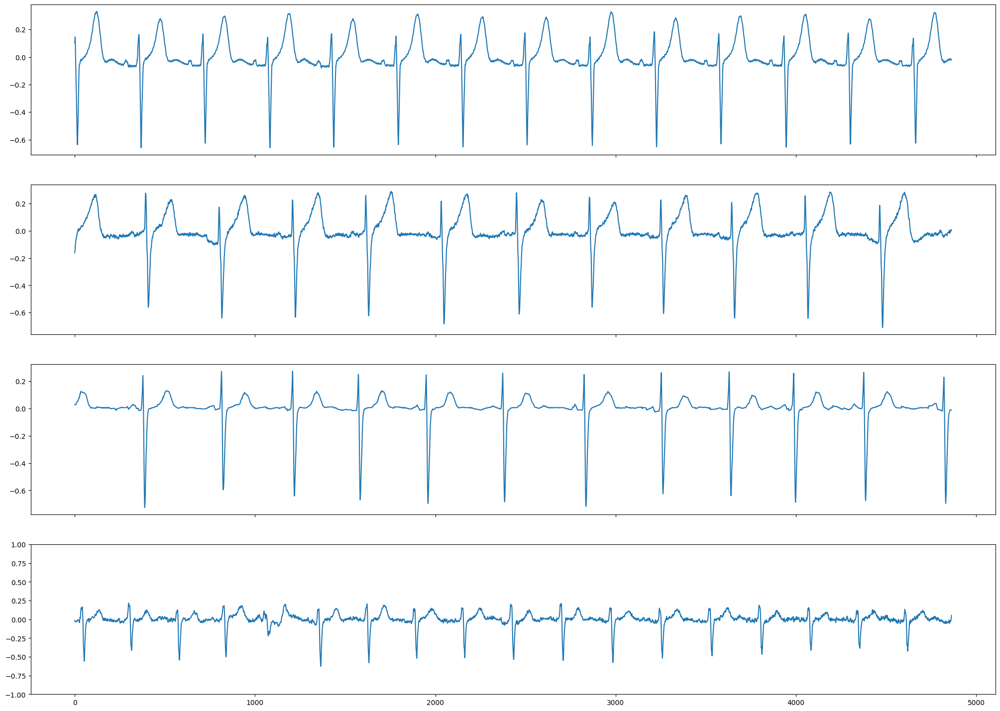

In [227]:
i = 12
j = 2
sphadb = X_train_WFDB[i,0]
ptbdb = X_train_ptbdb[i,0]
ptbxl = X_train_ptbxl[i,0]
incart = X_train_incart[i,0]
plt.subplots(4, 1, sharex='all', figsize=(25,18))
plt.ylim(-1,1)
plt.subplot(4, 1, 1)
plt.plot(ptbdb[j][:4864], label='true')
plt.subplot(4, 1, 2)
plt.plot(sphadb[j], label='compare')
plt.subplot(4, 1, 3)
plt.plot(ptbxl[j], label='compare')
plt.subplot(4, 1, 4)
plt.plot(incart[j][:4864], label='compare')

In [91]:
X_train_ptbxl.shape, X_train_ptbdb.shape, X_train_WFDB.shape,X_train_incart.shape, y_train_ptbxl.shape, y_train_ptbdb.shape, y_train_WFDB.shape, y_train_incart.shape

(torch.Size([19600, 1, 3, 4992]),
 torch.Size([239, 1, 3, 14976]),
 torch.Size([41474, 1, 3, 4992]),
 torch.Size([38, 1, 3, 14976]),
 torch.Size([19600, 1, 9, 4992]),
 torch.Size([239, 1, 9, 14976]),
 torch.Size([41474, 1, 9, 4992]),
 torch.Size([38, 1, 9, 14976]))

In [92]:
X_test_ptbxl.shape, X_test_ptbdb.shape, X_test_WFDB.shape,X_test_incart.shape, y_test_ptbxl.shape, y_test_ptbdb.shape, y_test_WFDB.shape, y_test_incart.shape

(torch.Size([2198, 1, 3, 4992]),
 torch.Size([277, 1, 3, 14976]),
 torch.Size([2183, 1, 3, 4992]),
 torch.Size([32, 1, 3, 14976]),
 torch.Size([2198, 1, 9, 4992]),
 torch.Size([277, 1, 9, 14976]),
 torch.Size([2183, 1, 9, 4992]),
 torch.Size([32, 1, 9, 14976]))

In [6]:
# extract 4864 point graphs with window size 1216 from 14592 point ECG
X_train_ptbdb_windowed = []
window_size = int(X_train_WFDB.size(3)/4)
image_size = int(X_train_WFDB.size(3))
for i in range(X_train_ptbdb.size(0)):
    for j in range((X_train_ptbdb.size(3) - image_size)//window_size):
        X_train_ptbdb_windowed.append(X_train_ptbdb[i,:, :, j*window_size: j*window_size + image_size])
X_train_ptbdb_windowed = torch.stack(X_train_ptbdb_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
y_train_ptbdb_windowed = []
window_size = int(y_train_WFDB.size(3)/4)
image_size = int(y_train_WFDB.size(3))
for i in range(y_train_ptbdb.size(0)):
    for j in range((y_train_ptbdb.size(3) - image_size)//window_size):
        y_train_ptbdb_windowed.append(y_train_ptbdb[i,:, :, j*window_size: j*window_size + image_size])
y_train_ptbdb_windowed = torch.stack(y_train_ptbdb_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
X_test_ptbdb_windowed = []
window_size = int(X_test_WFDB.size(3)/4)
image_size = int(X_test_WFDB.size(3))
for i in range(X_test_ptbdb.size(0)):
    for j in range((X_test_ptbdb.size(3) - image_size)//window_size):
        X_test_ptbdb_windowed.append(X_test_ptbdb[i,:, :, j*window_size: j*window_size + image_size])
X_test_ptbdb_windowed = torch.stack(X_test_ptbdb_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
y_test_ptbdb_windowed = []
window_size = int(y_test_WFDB.size(3)/4)
image_size = int(y_test_WFDB.size(3))
for i in range(y_test_ptbdb.size(0)):
    for j in range((y_test_ptbdb.size(3) - image_size)//window_size):
        y_test_ptbdb_windowed.append(y_test_ptbdb[i,:, :, j*window_size: j*window_size + image_size])
y_test_ptbdb_windowed = torch.stack(y_test_ptbdb_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
X_train_incart_windowed = []
window_size = int(X_train_WFDB.size(3)/4)
image_size = int(X_train_WFDB.size(3))
for i in range(X_train_incart.size(0)):
    for j in range((X_train_incart.size(3) - image_size)//window_size):
        X_train_incart_windowed.append(X_train_incart[i,:, :, j*window_size: j*window_size + image_size])
X_train_incart_windowed = torch.stack(X_train_incart_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
y_train_incart_windowed = []
window_size = int(y_train_WFDB.size(3)/4)
image_size = int(y_train_WFDB.size(3))
for i in range(y_train_incart.size(0)):
    for j in range((y_train_incart.size(3) - image_size)//window_size):
        y_train_incart_windowed.append(y_train_incart[i,:, :, j*window_size: j*window_size + image_size])
y_train_incart_windowed = torch.stack(y_train_incart_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
X_test_incart_windowed = []
window_size = int(X_test_WFDB.size(3)/4)
image_size = int(X_test_WFDB.size(3))
for i in range(X_test_incart.size(0)):
    for j in range((X_test_incart.size(3) - image_size)//window_size):
        X_test_incart_windowed.append(X_test_incart[i,:, :, j*window_size: j*window_size + image_size])
X_test_incart_windowed = torch.stack(X_test_incart_windowed)

# extract 4864 point graphs with window size 1216 from 14848 point ECG
y_test_incart_windowed = []
window_size = int(y_test_WFDB.size(3)/4)
image_size = int(y_test_WFDB.size(3))
for i in range(y_test_incart.size(0)):
    for j in range((y_test_incart.size(3) - image_size)//window_size):
        y_test_incart_windowed.append(y_test_incart[i,:, :, j*window_size: j*window_size + image_size])
y_test_incart_windowed = torch.stack(y_test_incart_windowed)


# # extract 4864 point graphs with window size 1216 from 14592 point ECG
# X_train_WFDB_windowed = []
# window_size = int(X_train_WFDB.size(3)/4)
# image_size = int(X_train_WFDB.size(3))
# for i in range(X_train_WFDB.size(0)):
#     for j in range((X_train_WFDB.size(3) - image_size)//window_size):
#         X_train_WFDB_windowed.append(X_train_WFDB[i,:, :, j*window_size: j*window_size + image_size])
# X_train_WFDB_windowed = torch.stack(X_train_WFDB_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# y_train_WFDB_windowed = []
# window_size = int(y_train_WFDB.size(3)/4)
# image_size = int(y_train_WFDB.size(3))
# for i in range(y_train_WFDB.size(0)):
#     for j in range((y_train_WFDB.size(3) - image_size)//window_size):
#         y_train_WFDB_windowed.append(y_train_WFDB[i,:, :, j*window_size: j*window_size + image_size])
# y_train_WFDB_windowed = torch.stack(y_train_WFDB_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# X_test_WFDB_windowed = []
# window_size = int(X_test_WFDB.size(3)/4)
# image_size = int(X_test_WFDB.size(3))
# for i in range(X_test_WFDB.size(0)):
#     for j in range((X_test_WFDB.size(3) - image_size)//window_size):
#         X_test_WFDB_windowed.append(X_test_WFDB[i,:, :, j*window_size: j*window_size + image_size])
# X_test_WFDB_windowed = torch.stack(X_test_WFDB_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# y_test_WFDB_windowed = []
# window_size = int(y_test_WFDB.size(3)/4)
# image_size = int(y_test_WFDB.size(3))
# for i in range(y_test_WFDB.size(0)):
#     for j in range((y_test_WFDB.size(3) - image_size)//window_size):
#         y_test_WFDB_windowed.append(y_test_WFDB[i,:, :, j*window_size: j*window_size + image_size])
# y_test_WFDB_windowed = torch.stack(y_test_WFDB_windowed)


# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# X_train_ptbxl_windowed = []
# window_size = int(X_train_WFDB.size(3)/4)
# image_size = int(X_train_WFDB.size(3))
# for i in range(X_train_ptbxl.size(0)):
#     for j in range((X_train_ptbxl.size(3) - image_size)//window_size):
#         X_train_ptbxl_windowed.append(X_train_ptbxl[i,:, :, j*window_size: j*window_size + image_size])
# X_train_ptbxl_windowed = torch.stack(X_train_ptbxl_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# y_train_ptbxl_windowed = []
# window_size = int(y_train_WFDB.size(3)/4)
# image_size = int(y_train_WFDB.size(3))
# for i in range(y_train_ptbxl.size(0)):
#     for j in range((y_train_ptbxl.size(3) - image_size)//window_size):
#         y_train_ptbxl_windowed.append(y_train_ptbxl[i,:, :, j*window_size: j*window_size + image_size])
# y_train_ptbxl_windowed = torch.stack(y_train_ptbxl_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# X_test_ptbxl_windowed = []
# window_size = int(X_test_WFDB.size(3)/4)
# image_size = int(X_test_WFDB.size(3))
# for i in range(X_test_ptbxl.size(0)):
#     for j in range((X_test_ptbxl.size(3) - image_size)//window_size):
#         X_test_ptbxl_windowed.append(X_test_ptbxl[i,:, :, j*window_size: j*window_size + image_size])
# X_test_ptbxl_windowed = torch.stack(X_test_ptbxl_windowed)

# # extract 4864 point graphs with window size 1216 from 14848 point ECG
# y_test_ptbxl_windowed = []
# window_size = int(y_test_ptbxl.size(3)/4)
# image_size = int(y_test_ptbxl.size(3))
# for i in range(y_test_ptbxl.size(0)):
#     for j in range((y_test_ptbxl.size(3) - image_size)//window_size):
#         y_test_ptbxl_windowed.append(y_test_ptbxl[i,:, :, j*window_size: j*window_size + image_size])
# y_test_ptbxl_windowed = torch.stack(y_test_ptbxl_windowed)
X_train_ptbdb_windowed.shape,X_test_ptbdb_windowed.shape,y_train_ptbdb_windowed.shape,y_test_ptbdb_windowed.shape, X_train_incart_windowed.shape,X_test_incart_windowed.shape,y_train_incart_windowed.shape,y_test_incart_windowed.shape

(torch.Size([1912, 1, 3, 4992]),
 torch.Size([2216, 1, 3, 4992]),
 torch.Size([1912, 1, 9, 4992]),
 torch.Size([2216, 1, 9, 4992]),
 torch.Size([304, 1, 3, 4992]),
 torch.Size([256, 1, 3, 4992]),
 torch.Size([304, 1, 9, 4992]),
 torch.Size([256, 1, 9, 4992]))

### Model prep

In [7]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms


# upsample block for pix2pix in pytorch
class UpSampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=2, padding=1, activation='relu', output_padding=0):
        super(UpSampleBlock, self).__init__()
        self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, output_padding=output_padding)
        self.batch_norm = nn.BatchNorm2d(out_channels)
        self.activation = nn.ReLU(inplace=True) if activation == 'relu' else nn.Tanh()

    def forward(self, x):
        x = self.conv_transpose(x)
        x = self.batch_norm(x)
        x = self.activation(x)
        return x

# downsample block for pix2pix in pytorch
class DownSampleBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=5, padding=1, activation='leakyrelu', batch_norm=True):
        super(DownSampleBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        self.batch_norm = nn.BatchNorm2d(out_channels) if batch_norm else None
        self.activation = nn.LeakyReLU(0.2, inplace=True) if activation == 'leakyrelu' else nn.Tanh()

    def forward(self, x):
        x = self.conv(x)
        if self.batch_norm:
            x = self.batch_norm(x)
        x = self.activation(x)
        return x


# Unet generator for pix2pix in pytorch
class Generator(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Generator, self).__init__()
        self.encoder = nn.Sequential(
            DownSampleBlock(in_channels, 1*64, batch_norm=False ,kernel_size=(3,4), stride=(1,2), padding=1),
            DownSampleBlock(1*64, 1*128, kernel_size=(3,4), stride=(1,2), padding=1),
            DownSampleBlock(1*128, 1*256, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*256, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
            #DownSampleBlock(1*512, 1*512, kernel_size=(3,4), stride=(1,2),padding=1),
        )

        self.decoder = nn.Sequential(
            UpSampleBlock(1*512, 1*512,kernel_size=(3,4),stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            #UpSampleBlock(1*1024,1* 512,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*1024,1* 256,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*512, 1*128,kernel_size=(3,4), stride=(1,2),padding=1),
            UpSampleBlock(1*256, 1*64,kernel_size=(3,4), stride=(1,2),padding=1),
        )
        self.last = nn.Sequential(
            nn.ConvTranspose2d(1*128, out_channels, kernel_size=(3,4), stride=(1,2), padding=1),
            nn.Tanh()
        )
            
            
    
    def forward(self, x):    
        # Downsampling through the model
        skips = []
        x = x.repeat(1,1,3,1) # another approach
        for module in self.encoder:
            x = module(x)
            skips.append(x)
            # print("down")
            # print(x.shape)
        skips = reversed(skips[:-1])
        # #print(skips)
        # Upsampling and establishing the skip connections
        for up, skip in zip(self.decoder, skips):
            x = up(x)
            # #print(skip.shape)
            # print(x.shape)
            x = torch.cat([x, skip], 1)
        
        x = self.last(x)
        return x
        
# Discriminator
class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(PatchGANDiscriminator, self).__init__()
        self.model = nn.Sequential(
            DownSampleBlock(in_channels, 1*64, batch_norm=False, stride=(1,2), padding=1),
            DownSampleBlock(1*64, 1*128, stride=(1,2), padding=1),
            DownSampleBlock(1*128,1* 256, stride=(1,2),padding=1),
            #DownSampleBlock(256, 512, stride=(1,2),padding=1),
            nn.Conv2d(1*256, out_channels, stride=(1,2), kernel_size=3, padding=1),
        )
    
    def forward(self, x, y):
        #x = torch.nn.functional.pad(x, (0,0,3,3)) # for making 3 lead input to 9 lead with other leads at zeros
        x = x.repeat(1,1,3,1) # another approach
        input = torch.cat([x, y], 1)
        return self.model(input)

In [8]:
def sample(generator,X, y, start=0, length=None, res=1, index=None):
    # x = [i for i in range(X.size(3))]
    plt.subplots(9, 1, sharex='all', figsize=(25,25))
    if index is None:
        index = torch.randint(0, len(y), (1,)).item()
    if length is None:
        if X[index].dim() == 3:
            length = X[index].size(2)
        else:
            length = X[index].size(1)
    assert index < len(y)
    if X[index].dim() == 3:
        patient_true = y[index,0]
        patient_pred = generator(X[index].to(device))[0,0].detach().cpu()
    else:
        patient_true = y[index]
        patient_pred = generator(X[index].unsqueeze(0).to(device))[0,0].detach().cpu()
    #plt.ylim(-3,3)
    print(f"Index: {index}")
    for i in range(9):
        plt.subplot(9, 1, i+1)
        # plt.plot(x[start:start+length][::res],patient_true[i][start:start+length][::res], label='true')
        # plt.plot(x[start:start+length][::res],patient_pred[i][start:start+length][::res], label='predicted')
        plt.plot(patient_true[i][start:start+length][::res], label='true')
        plt.plot(patient_pred[i][start:start+length][::res], label='predicted')
    plt.legend(['true', 'predicted'])
    plt.show()

In [34]:
def compute_metrics(generator, X, y, num_preds_ratio=1, skip_indices=[]):
    #index = torch.randint(0, round((1-r) * d0), (1,)).item()
    #patient_true = y[index,0]
    generator.eval()
    L1 = nn.L1Loss()
    total_l1_loss = 0
    #patient_pred = generator(X[index].to(device))[0,0].detach().cpu()
    #plt.ylim(-3,3)
    totalnum = len(y)
    test_num_patients = int(num_preds_ratio*totalnum) - len(skip_indices)
    avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
    avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
    if num_preds_ratio != 1:
        idx = torch.randperm(totalnum)[:test_num_patients]
    else:
        idx = torch.randperm(totalnum)
    for index in idx:
        if index.item() in skip_indices:
            continue
        #print(f"patient {index} from test set")
        #print(index.item())
        if X[0].dim() == 3:
            patient_true = y[index.item(),0]
            patient_pred = generator(X[index.item()].to(device))[0,0].detach().cpu()
        else:
            patient_true = y[index.item()]
            patient_pred = generator(X[index.item()].unsqueeze(0).to(device))[0,0].detach().cpu()
        for i in range(9):
            z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
            avg_pearsoncorr_score[leads[i + 3]] += z[0,1]/test_num_patients
            avg_r2_score[leads[i + 3]] += r2_score(patient_pred[i], patient_true[i])/test_num_patients
            #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
        total_l1_loss += L1(patient_pred, patient_true)
    for i in range(9):
        print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
    for i in range(9):
        print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
    print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")
    print(f"avg CC score: {sum([avg_pearsoncorr_score[leads[i + 3]] for i in range(9)])/9}")
    print(f"Avg MAE: {total_l1_loss/test_num_patients}")
    return sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9
#compute_metrics(generator, 0.01, 'train')

In [93]:
# X_train_alldb = torch.cat((X_train_ptbdb_windowed, X_train_incart_windowed, X_train_WFDB))
# X_test_alldb = torch.cat((X_test_ptbdb_windowed, X_test_incart_windowed, X_test_WFDB))
# y_train_alldb = torch.cat((y_train_ptbdb_windowed, y_train_incart_windowed, y_train_WFDB))
# y_test_alldb = torch.cat((y_test_ptbdb_windowed, y_test_incart_windowed, y_test_WFDB))

# X_train_alldb = torch.cat((X_train_ptbdb_windowed,X_train_ptbxl, X_train_incart_windowed, X_train_WFDB))
# X_test_alldb = torch.cat((X_test_ptbdb_windowed,X_test_ptbxl, X_test_incart_windowed, X_test_WFDB))
# y_train_alldb = torch.cat((y_train_ptbdb_windowed,y_train_ptbxl, y_train_incart_windowed, y_train_WFDB))
# y_test_alldb = torch.cat((y_test_ptbdb_windowed,y_test_ptbxl, y_test_incart_windowed, y_test_WFDB))
# X_train_alldb.shape, y_train_alldb.shape,X_test_alldb.shape, y_test_alldb.shape

# config for best
# X_train_alldb = torch.cat((X_train_ptbdb_windowed, X_train_incart_windowed, X_train_WFDB, X_test_WFDB))
# X_test_alldb = torch.cat((X_test_ptbdb_windowed, X_test_incart_windowed, X_test_ptbxl))
# y_train_alldb = torch.cat((y_train_ptbdb_windowed, y_train_incart_windowed, y_train_WFDB, y_test_WFDB))
# y_test_alldb = torch.cat((y_test_ptbdb_windowed, y_test_incart_windowed, y_test_ptbxl))

X_train_alldb = torch.cat((X_train_WFDB, X_test_WFDB, X_georgia_data_windowed, X_cpsc_data_windowed, X_train_incart_windowed, X_test_incart_windowed))
X_test_alldb = torch.cat((X_train_ptbdb_windowed,X_test_ptbdb_windowed, X_train_ptbxl, X_test_ptbxl))
y_train_alldb = torch.cat((y_train_WFDB, y_test_WFDB, y_georgia_data_windowed, y_cpsc_data_windowed, y_train_incart_windowed, y_test_incart_windowed))
y_test_alldb = torch.cat((y_train_ptbdb_windowed,y_test_ptbdb_windowed, y_train_ptbxl, y_test_ptbxl))

# data indice transforms (idk atp)
# X_train_alldb = X_train_alldb[:,:,[0,2,1],:]
# X_test_alldb = X_test_alldb[:,:,[0,2,1],:]

X_train_alldb.shape, y_train_alldb.shape,X_test_alldb.shape, y_test_alldb.shape

(torch.Size([81110, 1, 3, 4992]),
 torch.Size([81110, 1, 9, 4992]),
 torch.Size([25926, 1, 3, 4992]),
 torch.Size([25926, 1, 9, 4992]))

In [1165]:
X_train_WFDB.shape, X_test_WFDB.shape

(torch.Size([41474, 1, 3, 4992]), torch.Size([2183, 1, 3, 4992]))

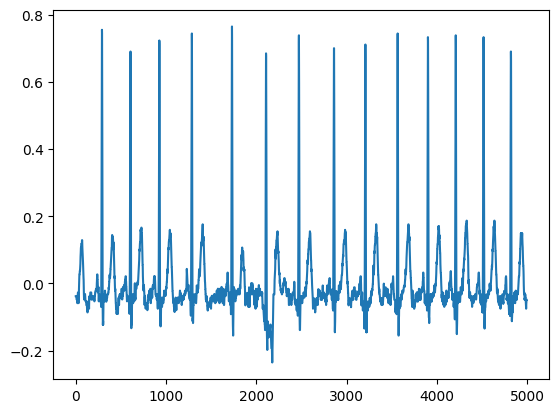

In [1212]:
plt.plot(y_train_alldb[19209, 0, 8])

In [94]:
train_records_to_drop = []
train_records_to_keep = []
for i in range(X_train_alldb.size(0)):
    for j in range(3):
        if torch.max(X_train_alldb[i,0,j]) - torch.min(X_train_alldb[i,0,j]) < 1e-3:
            train_records_to_drop.append(i)
            print(f"nan error at xtrain index {i}, lead {j}")
    for j in range(9):
        if torch.max(y_train_alldb[i,0,j]) - torch.min(y_train_alldb[i,0,j]) < 1e-3:
            train_records_to_drop.append(i)
            print(f"nan error at ytrain index {i}, lead {j}")

test_records_to_drop = []
test_records_to_keep = []
for i in range(X_test_alldb.size(0)):
    for j in range(3):
        if torch.max(X_test_alldb[i,0,j]) - torch.min(X_test_alldb[i,0,j]) < 1e-3:
            test_records_to_drop.append(i)
            print(f"nan error at xtest index {i}, lead {j}")
    for j in range(9):
        if torch.max(y_test_alldb[i,0,j]) - torch.min(y_test_alldb[i,0,j]) < 1e-3:
            test_records_to_drop.append(i)
            print(f"nan error at ytrain index {i}, lead {j}")

for i in range(len(X_train_alldb)):
    if i not in train_records_to_drop:
        train_records_to_keep.append(i)
for i in range(len(X_test_alldb)):
    if i not in test_records_to_drop:
        test_records_to_keep.append(i)
X_train_alldb = X_train_alldb[train_records_to_keep]
y_train_alldb = y_train_alldb[train_records_to_keep]
X_test_alldb = X_test_alldb[test_records_to_keep]
y_test_alldb = y_test_alldb[test_records_to_keep]
X_train_alldb.shape, y_train_alldb.shape,X_test_alldb.shape, y_test_alldb.shape

nan error at xtrain index 54878, lead 2
nan error at xtrain index 60629, lead 2
nan error at ytrain index 65031, lead 7
nan error at ytrain index 65032, lead 7
nan error at xtrain index 72310, lead 1
nan error at xtrain index 72311, lead 1
nan error at xtrain index 72312, lead 0
nan error at xtrain index 72312, lead 1
nan error at ytrain index 72312, lead 0
nan error at ytrain index 72312, lead 1
nan error at ytrain index 72312, lead 2
nan error at ytrain index 72312, lead 3
nan error at xtrain index 72313, lead 0
nan error at xtrain index 72313, lead 1
nan error at ytrain index 72313, lead 0
nan error at ytrain index 72313, lead 1
nan error at ytrain index 72313, lead 2
nan error at ytrain index 72313, lead 3
nan error at xtrain index 72314, lead 1
nan error at xtrain index 72314, lead 2
nan error at xtrain index 72315, lead 1
nan error at ytrain index 74805, lead 6
nan error at ytrain index 74805, lead 7
nan error at ytrain index 74805, lead 8
nan error at ytrain index 74806, lead 6


(torch.Size([81094, 1, 3, 4992]),
 torch.Size([81094, 1, 9, 4992]),
 torch.Size([25926, 1, 3, 4992]),
 torch.Size([25926, 1, 9, 4992]))

In [111]:
import torch
from torch.utils.data import TensorDataset, DataLoader

class CustomDataset(Dataset):
    def __init__(self, x_data, y_data):
        self.x_data = x_data
        self.y_data = y_data

    def __len__(self):
        return self.x_data.size(0)

    def __getitem__(self, idx):
        x = self.x_data[idx]
        y = self.y_data[idx]
        return x, y
        
# Create Dataset objects for training and testing data
#train_dataset = TensorDataset(X_5sec_train, y_5sec_train)
#test_dataset = TensorDataset(X_5sec_test, y_5sec_test)

train_dataset = CustomDataset(X_train_alldb, y_train_alldb)
test_dataset = CustomDataset(X_test_alldb, y_test_alldb)

# Create DataLoader objects for training and testing data
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, pin_memory=True)


In [114]:
generator = Generator(1, 1).to(device)
discriminator = PatchGANDiscriminator(2, 1).to(device)
# Loss functions
criterion_GAN = nn.BCEWithLogitsLoss()
criterion_L1 = nn.L1Loss()

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=0.000025, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.00000025, betas=(0.5, 0.999))

Epoch [1/100], Step [1]
L1 Loss: 0.6392616629600525, Gan Loss: 0.6698899865150452
Total D Loss: 0.7313958406448364, Total G Loss: 64.59605407714844
Epoch [1/100], Step [501]
L1 Loss: 0.05203801766037941, Gan Loss: 0.699407696723938
Total D Loss: 0.7033825516700745, Total G Loss: 5.903209209442139
Epoch [1/100], Step [1001]
L1 Loss: 0.03942713513970375, Gan Loss: 0.6924039125442505
Total D Loss: 0.6993358135223389, Total G Loss: 4.635117530822754
Epoch [1/100], Step [1501]
L1 Loss: 0.03391366824507713, Gan Loss: 0.6930413246154785
Total D Loss: 0.6976436972618103, Total G Loss: 4.084407806396484
Epoch [1/100], Step [2001]
L1 Loss: 0.03370606154203415, Gan Loss: 0.6948887705802917
Total D Loss: 0.6972527503967285, Total G Loss: 4.065495014190674
Epoch [1/100], Step [2501]
L1 Loss: 0.027283430099487305, Gan Loss: 0.6948390603065491
Total D Loss: 0.6961289048194885, Total G Loss: 3.4231820106506348
Test Loss: 0.03306126222014427
Index: 24645


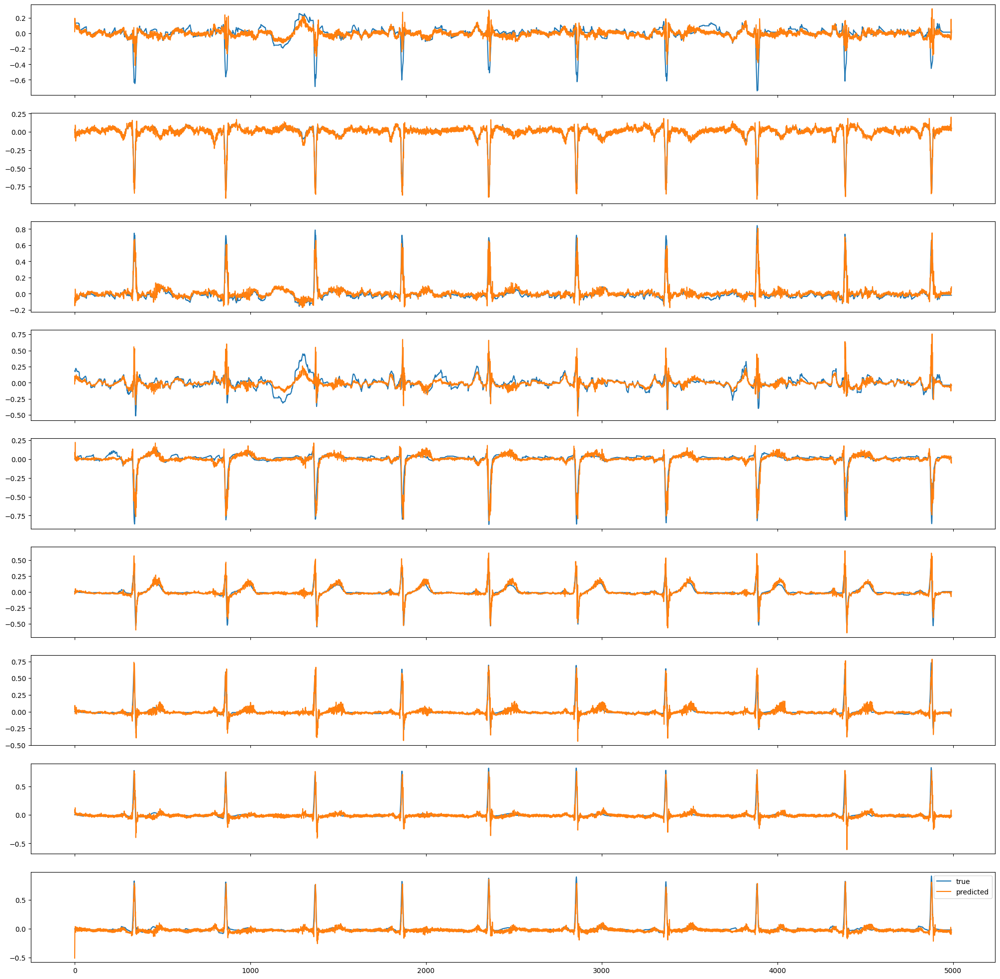

Epoch [2/100], Step [1]
L1 Loss: 0.032502029091119766, Gan Loss: 0.6943909525871277
Total D Loss: 0.6969151496887207, Total G Loss: 3.944593906402588
Epoch [2/100], Step [501]
L1 Loss: 0.029001833871006966, Gan Loss: 0.6969796419143677
Total D Loss: 0.6946408748626709, Total G Loss: 3.597163200378418
Epoch [2/100], Step [1001]
L1 Loss: 0.026451963931322098, Gan Loss: 0.6968119144439697
Total D Loss: 0.69422847032547, Total G Loss: 3.342008352279663
Epoch [2/100], Step [1501]
L1 Loss: 0.026581430807709694, Gan Loss: 0.6986284255981445
Total D Loss: 0.6937298774719238, Total G Loss: 3.356771469116211
Epoch [2/100], Step [2001]
L1 Loss: 0.025674423202872276, Gan Loss: 0.6976668238639832
Total D Loss: 0.6931825876235962, Total G Loss: 3.2651093006134033
Epoch [2/100], Step [2501]
L1 Loss: 0.026098966598510742, Gan Loss: 0.6969451308250427
Total D Loss: 0.6932346820831299, Total G Loss: 3.3068418502807617
Test Loss: 0.02890777587890625
Index: 13899


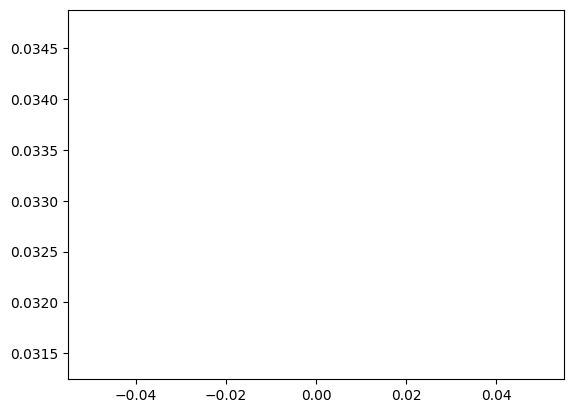

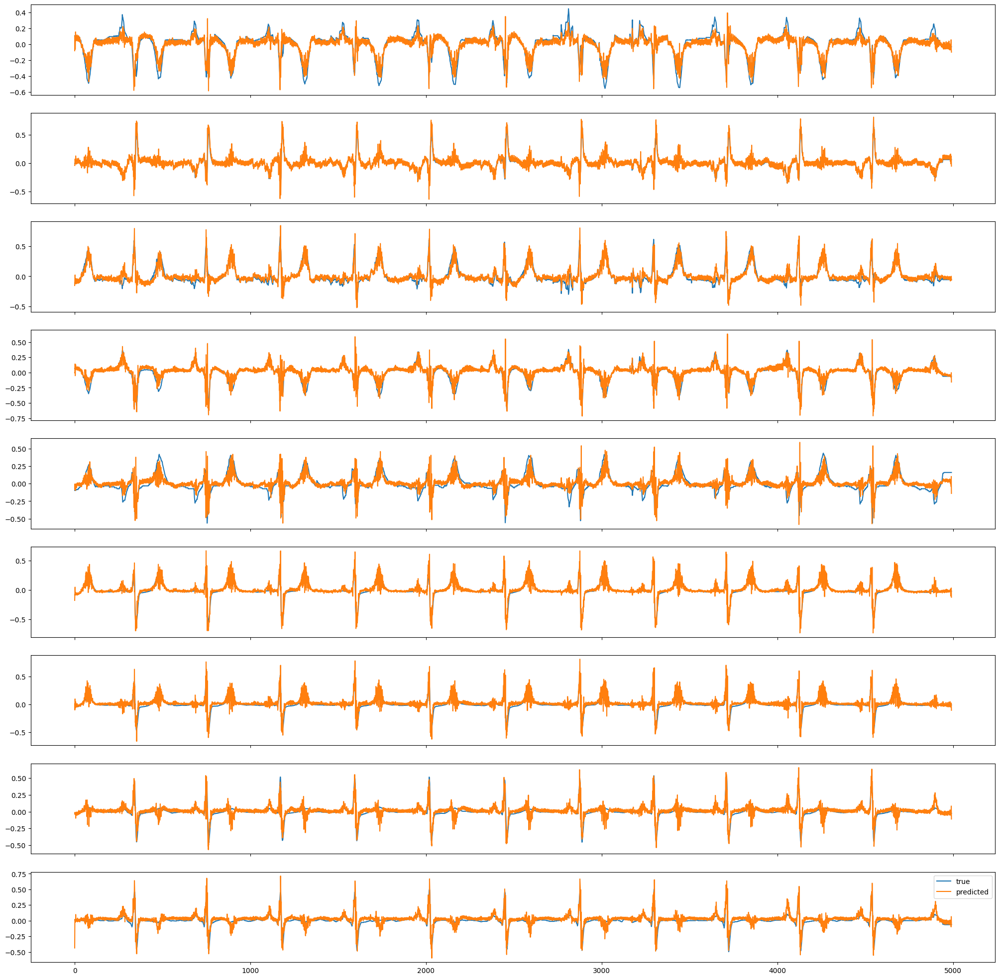

Epoch [3/100], Step [1]
L1 Loss: 0.02771434374153614, Gan Loss: 0.70003741979599
Total D Loss: 0.6928698420524597, Total G Loss: 3.4714717864990234
Epoch [3/100], Step [501]
L1 Loss: 0.024639930576086044, Gan Loss: 0.6965225338935852
Total D Loss: 0.6922518014907837, Total G Loss: 3.160515546798706
Epoch [3/100], Step [1001]
L1 Loss: 0.023301176726818085, Gan Loss: 0.6997753381729126
Total D Loss: 0.6909023523330688, Total G Loss: 3.029892921447754
Epoch [3/100], Step [1501]
L1 Loss: 0.021108422428369522, Gan Loss: 0.7026246190071106
Total D Loss: 0.69037926197052, Total G Loss: 2.813466787338257
Epoch [3/100], Step [2001]
L1 Loss: 0.02302064187824726, Gan Loss: 0.6973746418952942
Total D Loss: 0.6912195682525635, Total G Loss: 2.999438762664795
Epoch [3/100], Step [2501]
L1 Loss: 0.025315195322036743, Gan Loss: 0.6930138468742371
Total D Loss: 0.6901131868362427, Total G Loss: 3.2245333194732666
Test Loss: 0.02912919968366623
Index: 1352


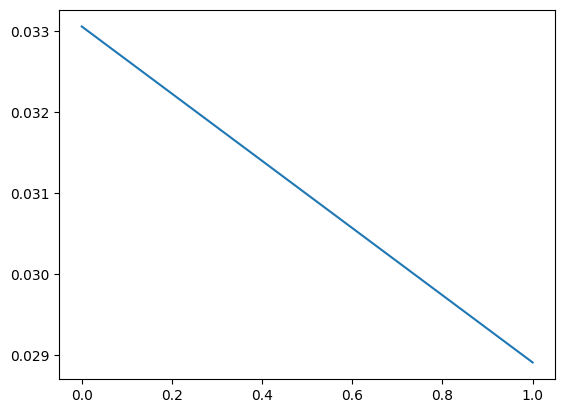

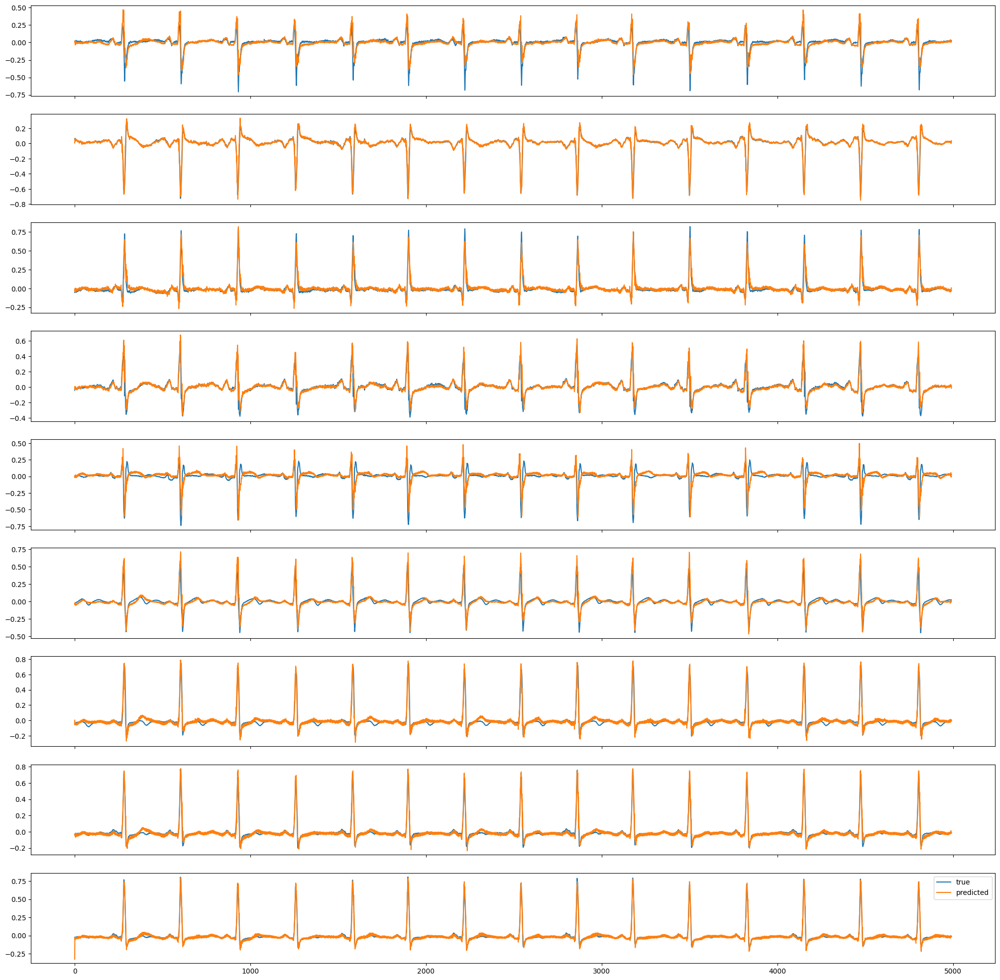

Epoch [4/100], Step [1]
L1 Loss: 0.024203650653362274, Gan Loss: 0.7009086012840271
Total D Loss: 0.6926076412200928, Total G Loss: 3.1212737560272217
Epoch [4/100], Step [501]
L1 Loss: 0.02113388106226921, Gan Loss: 0.7055025696754456
Total D Loss: 0.6892282366752625, Total G Loss: 2.8188905715942383
Epoch [4/100], Step [1001]
L1 Loss: 0.02289920300245285, Gan Loss: 0.6977044939994812
Total D Loss: 0.6862466335296631, Total G Loss: 2.9876248836517334
Epoch [4/100], Step [1501]
L1 Loss: 0.02085874229669571, Gan Loss: 0.7027039527893066
Total D Loss: 0.68720942735672, Total G Loss: 2.7885782718658447
Epoch [4/100], Step [2001]
L1 Loss: 0.023976977914571762, Gan Loss: 0.7009065747261047
Total D Loss: 0.6856899261474609, Total G Loss: 3.098604202270508
Epoch [4/100], Step [2501]
L1 Loss: 0.02262301929295063, Gan Loss: 0.7071155309677124
Total D Loss: 0.6849838495254517, Total G Loss: 2.9694175720214844
Test Loss: 0.021576205268502235
Index: 23957


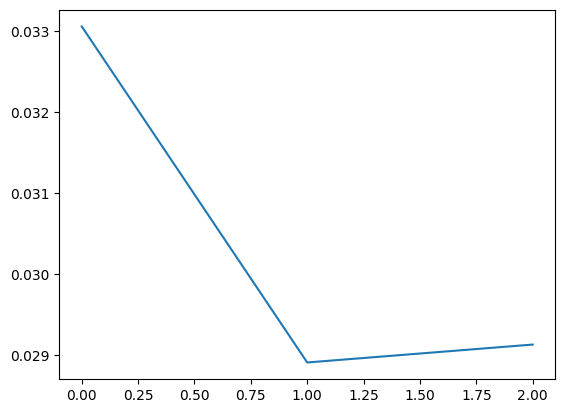

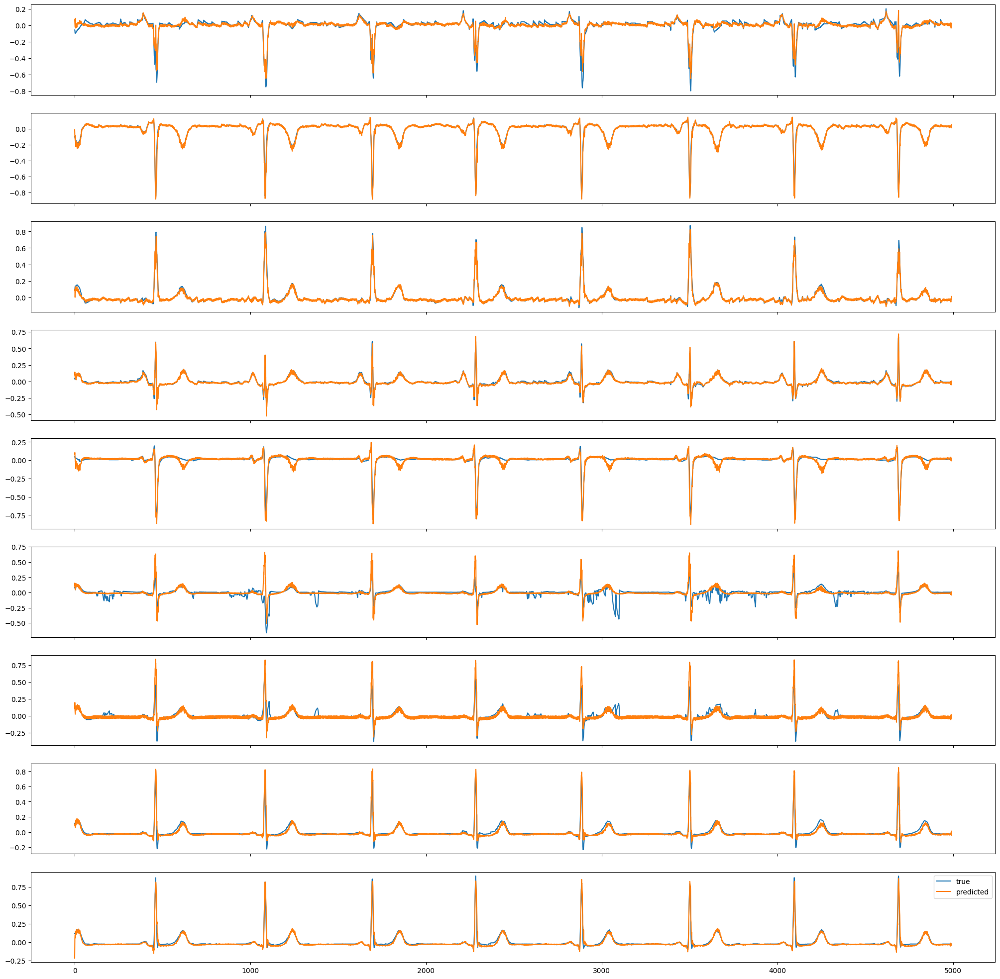

Epoch [5/100], Step [1]
L1 Loss: 0.023410813882946968, Gan Loss: 0.6945842504501343
Total D Loss: 0.6862297058105469, Total G Loss: 3.035665512084961
Epoch [5/100], Step [501]
L1 Loss: 0.02169976383447647, Gan Loss: 0.7057307958602905
Total D Loss: 0.6859568357467651, Total G Loss: 2.8757071495056152
Epoch [5/100], Step [1001]
L1 Loss: 0.020314069464802742, Gan Loss: 0.7041329741477966
Total D Loss: 0.686573326587677, Total G Loss: 2.7355399131774902
Epoch [5/100], Step [1501]
L1 Loss: 0.02196715772151947, Gan Loss: 0.704095184803009
Total D Loss: 0.6830435991287231, Total G Loss: 2.900810956954956
Epoch [5/100], Step [2001]
L1 Loss: 0.021176867187023163, Gan Loss: 0.7014898061752319
Total D Loss: 0.6833017468452454, Total G Loss: 2.81917667388916
Epoch [5/100], Step [2501]
L1 Loss: 0.020875712856650352, Gan Loss: 0.708832323551178
Total D Loss: 0.6812795996665955, Total G Loss: 2.796403646469116
Test Loss: 0.022277062758803368
Index: 3124


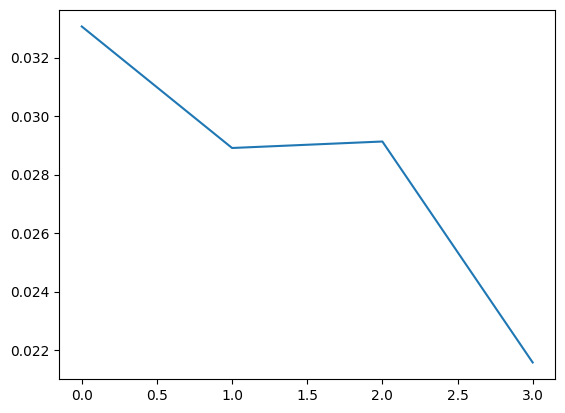

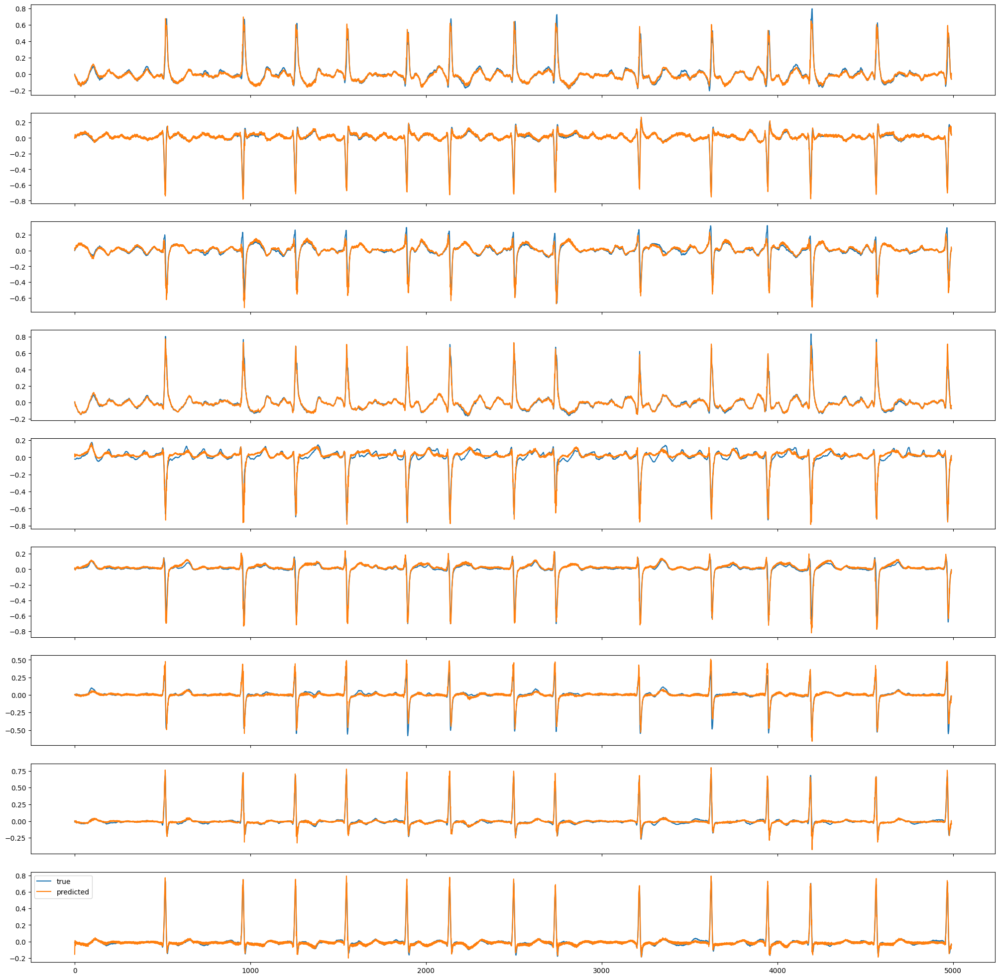

Epoch [6/100], Step [1]
L1 Loss: 0.022696051746606827, Gan Loss: 0.7079799175262451
Total D Loss: 0.6818928718566895, Total G Loss: 2.9775850772857666
Epoch [6/100], Step [501]
L1 Loss: 0.020707953721284866, Gan Loss: 0.7144389152526855
Total D Loss: 0.6800225973129272, Total G Loss: 2.785234212875366
Epoch [6/100], Step [1001]
L1 Loss: 0.0194317027926445, Gan Loss: 0.7146636843681335
Total D Loss: 0.6829723119735718, Total G Loss: 2.657834053039551
Epoch [6/100], Step [1501]
L1 Loss: 0.01935546286404133, Gan Loss: 0.7093062996864319
Total D Loss: 0.6842594146728516, Total G Loss: 2.644852638244629
Epoch [6/100], Step [2001]
L1 Loss: 0.021102968603372574, Gan Loss: 0.7036250233650208
Total D Loss: 0.6838037371635437, Total G Loss: 2.8139219284057617
Epoch [6/100], Step [2501]
L1 Loss: 0.01919502206146717, Gan Loss: 0.7155875563621521
Total D Loss: 0.6801650524139404, Total G Loss: 2.635089874267578
Test Loss: 0.021718012169003487
Index: 17298


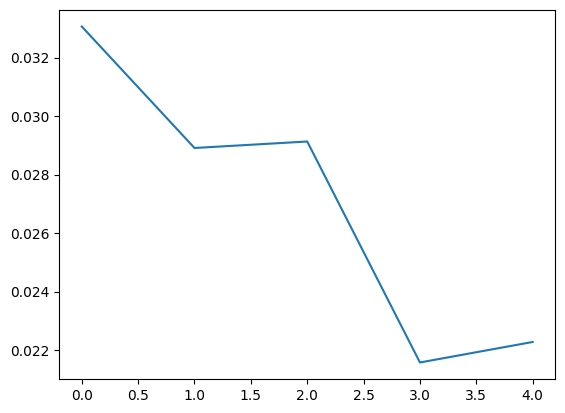

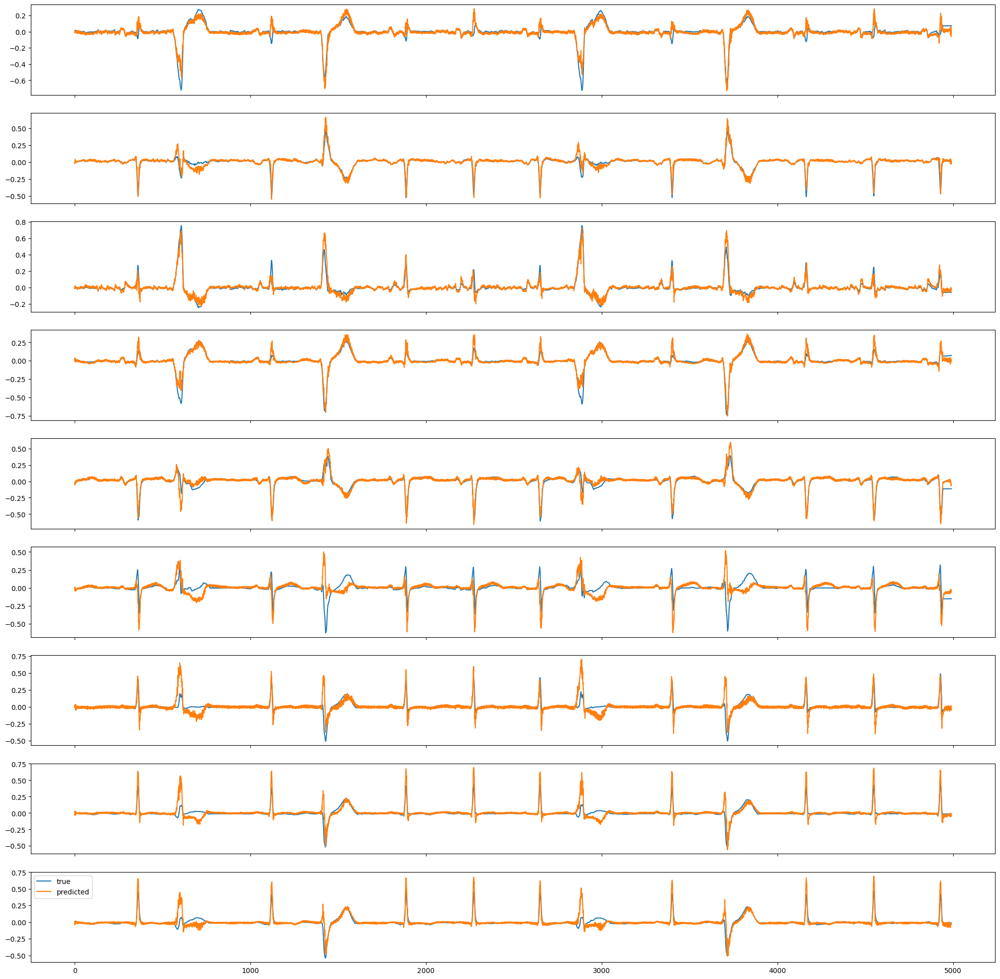

Epoch [7/100], Step [1]
L1 Loss: 0.02075626142323017, Gan Loss: 0.7218969464302063
Total D Loss: 0.6816353797912598, Total G Loss: 2.797523021697998
Epoch [7/100], Step [501]
L1 Loss: 0.020469339564442635, Gan Loss: 0.7023648619651794
Total D Loss: 0.6818655729293823, Total G Loss: 2.7492988109588623
Epoch [7/100], Step [1001]
L1 Loss: 0.018367404118180275, Gan Loss: 0.7277567386627197
Total D Loss: 0.6850847005844116, Total G Loss: 2.5644969940185547
Epoch [7/100], Step [1501]
L1 Loss: 0.020939016714692116, Gan Loss: 0.7070772647857666
Total D Loss: 0.6812862157821655, Total G Loss: 2.800978899002075
Epoch [7/100], Step [2001]
L1 Loss: 0.018553845584392548, Gan Loss: 0.717447817325592
Total D Loss: 0.6795851588249207, Total G Loss: 2.5728323459625244
Epoch [7/100], Step [2501]
L1 Loss: 0.0199421513825655, Gan Loss: 0.6902177333831787
Total D Loss: 0.6787737011909485, Total G Loss: 2.6844329833984375
Test Loss: 0.022908730432391167
Index: 19301


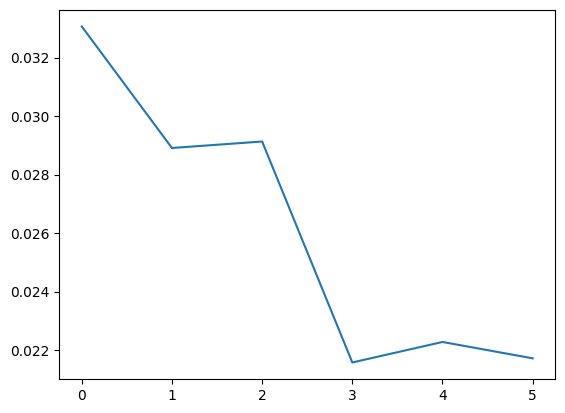

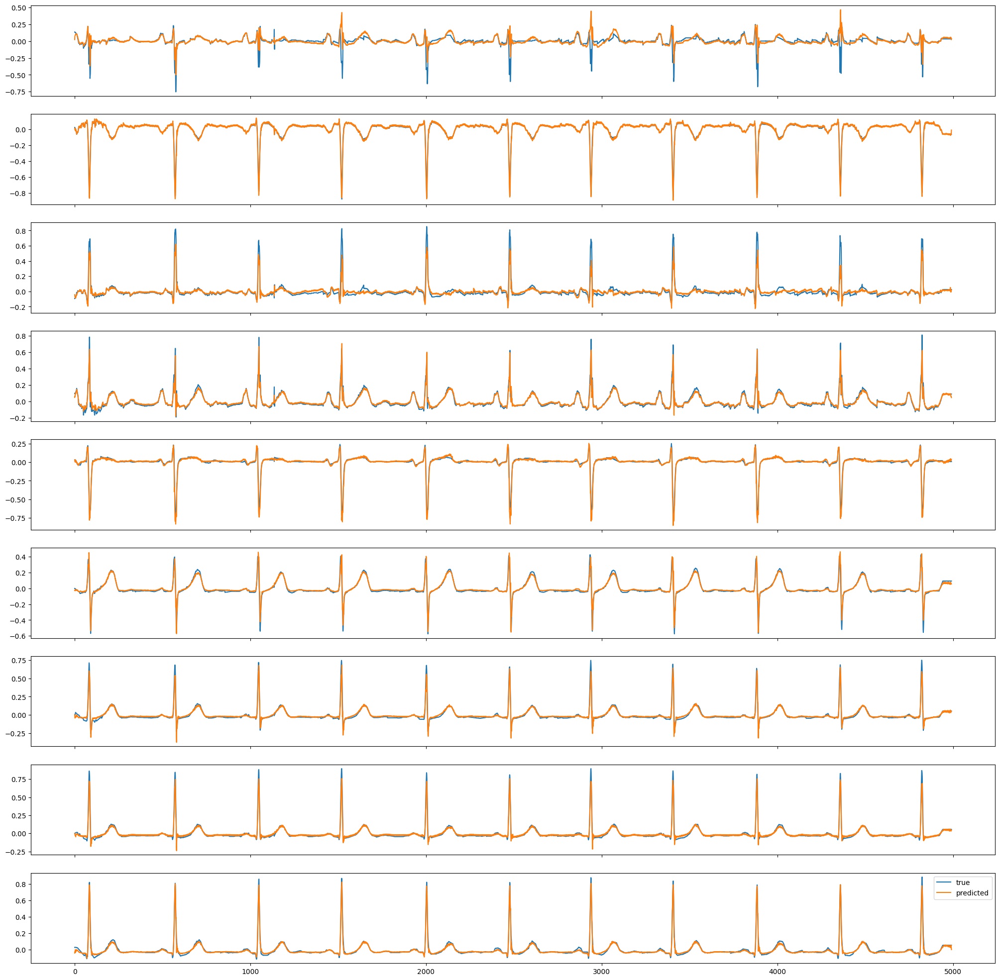

avg R2 score for III: 0.7209652066230774
avg R2 score for aVR: 0.9646778106689453
avg R2 score for aVL: 0.5944259762763977
avg R2 score for aVF: 0.9083614945411682
avg R2 score for V1: 0.8199223279953003
avg R2 score for V3: 0.7761248350143433
avg R2 score for V4: 0.7119881510734558
avg R2 score for V5: 0.7667560577392578
avg R2 score for V6: 0.8341287970542908
avg CC score for III: 0.8663910627365112
avg CC score for aVR: 0.9881563186645508
avg CC score for aVL: 0.7879620790481567
avg CC score for aVF: 0.9605744481086731
avg CC score for V1: 0.9270858764648438
avg CC score for V3: 0.8953994512557983
avg CC score for V4: 0.8559808135032654
avg CC score for V5: 0.8782485723495483
avg CC score for V6: 0.919197678565979
avg R2 score: 0.7885944843292236
avg CC score: 0.8976662755012512
Avg MAE: 0.022947147488594055
Epoch [8/100], Step [1]
L1 Loss: 0.02286982722580433, Gan Loss: 0.69437175989151
Total D Loss: 0.6772052645683289, Total G Loss: 2.9813544750213623
Epoch [8/100], Step [501]
L1 

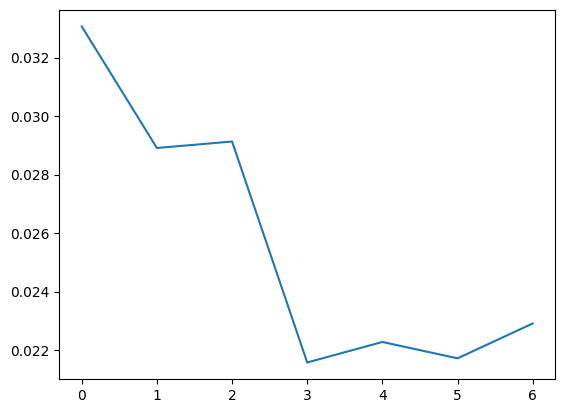

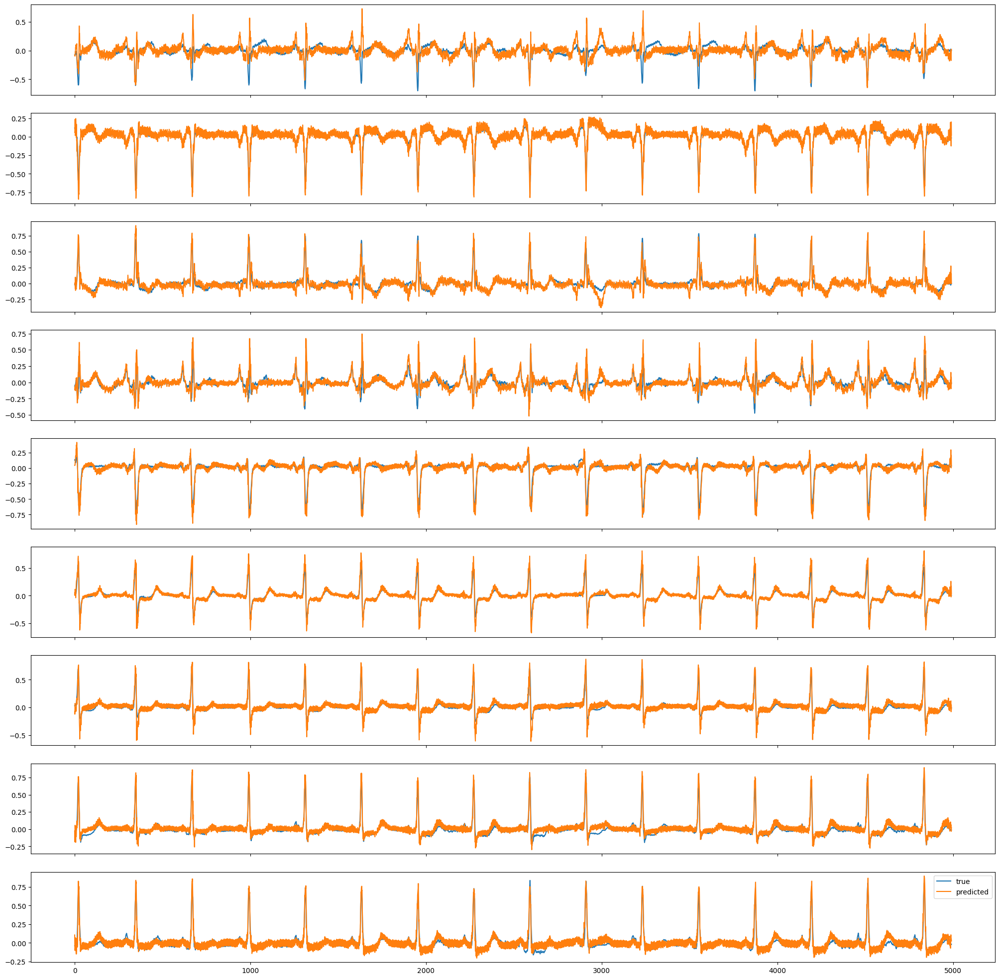

avg R2 score for III: 0.8336958289146423
avg R2 score for aVR: 0.9733054637908936
avg R2 score for aVL: 0.8973463177680969
avg R2 score for aVF: 0.9174519181251526
avg R2 score for V1: 0.8417304158210754
avg R2 score for V3: 0.8287608623504639
avg R2 score for V4: 0.7452252507209778
avg R2 score for V5: 0.796924889087677
avg R2 score for V6: 0.8457435369491577
avg CC score for III: 0.9275047183036804
avg CC score for aVR: 0.9893138408660889
avg CC score for aVL: 0.9524633884429932
avg CC score for aVF: 0.9673718810081482
avg CC score for V1: 0.9274519681930542
avg CC score for V3: 0.9211419820785522
avg CC score for V4: 0.8805415034294128
avg CC score for V5: 0.8989337682723999
avg CC score for V6: 0.9270458221435547
avg R2 score: 0.8533538579940796
avg CC score: 0.9324188232421875
Avg MAE: 0.020152753219008446
Epoch [9/100], Step [1]
L1 Loss: 0.019145140424370766, Gan Loss: 0.7285698056221008
Total D Loss: 0.6775962114334106, Total G Loss: 2.6430838108062744
Epoch [9/100], Step [501]


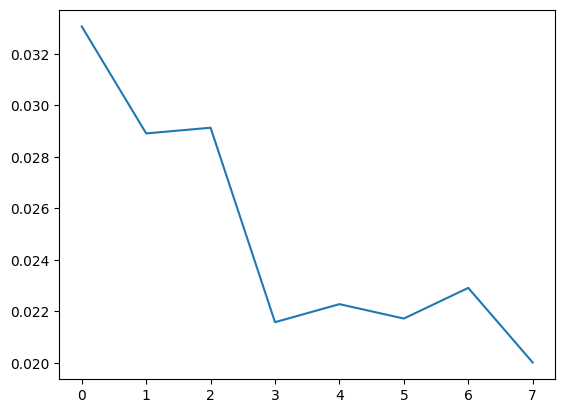

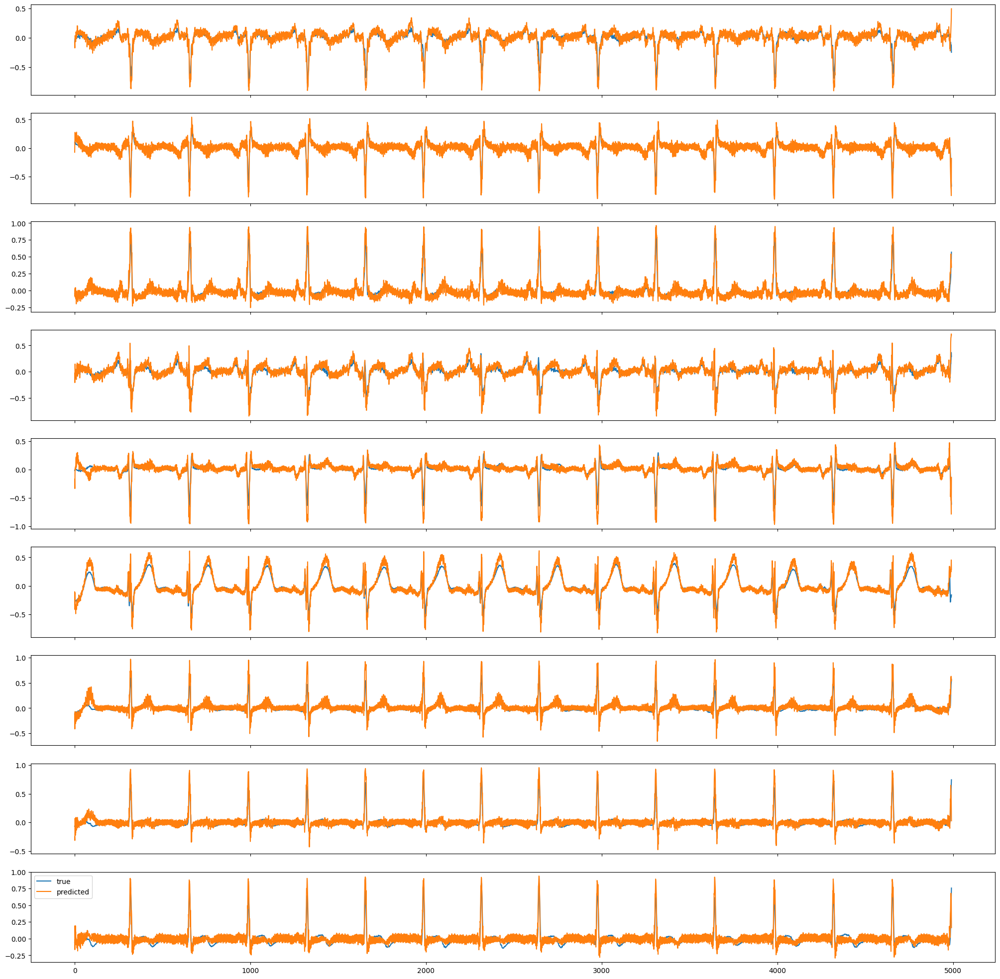

avg R2 score for III: 0.7919586896896362
avg R2 score for aVR: 0.9700323343276978
avg R2 score for aVL: 0.8519001007080078
avg R2 score for aVF: 0.9281708598136902
avg R2 score for V1: 0.8483369946479797
avg R2 score for V3: 0.8271017074584961
avg R2 score for V4: 0.7348406314849854
avg R2 score for V5: 0.7874588966369629
avg R2 score for V6: 0.8371260166168213
avg CC score for III: 0.910792887210846
avg CC score for aVR: 0.9893922209739685
avg CC score for aVL: 0.9301329851150513
avg CC score for aVF: 0.9712280035018921
avg CC score for V1: 0.9335535764694214
avg CC score for V3: 0.9220909476280212
avg CC score for V4: 0.8776231408119202
avg CC score for V5: 0.8963307738304138
avg CC score for V6: 0.9246007204055786
avg R2 score: 0.8418806791305542
avg CC score: 0.9284161329269409
Avg MAE: 0.02124670147895813
Epoch [10/100], Step [1]
L1 Loss: 0.020522259175777435, Gan Loss: 0.70100998878479
Total D Loss: 0.6822119951248169, Total G Loss: 2.7532358169555664
Epoch [10/100], Step [501]
L

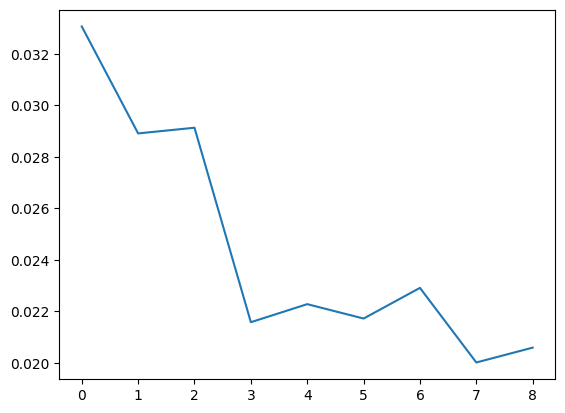

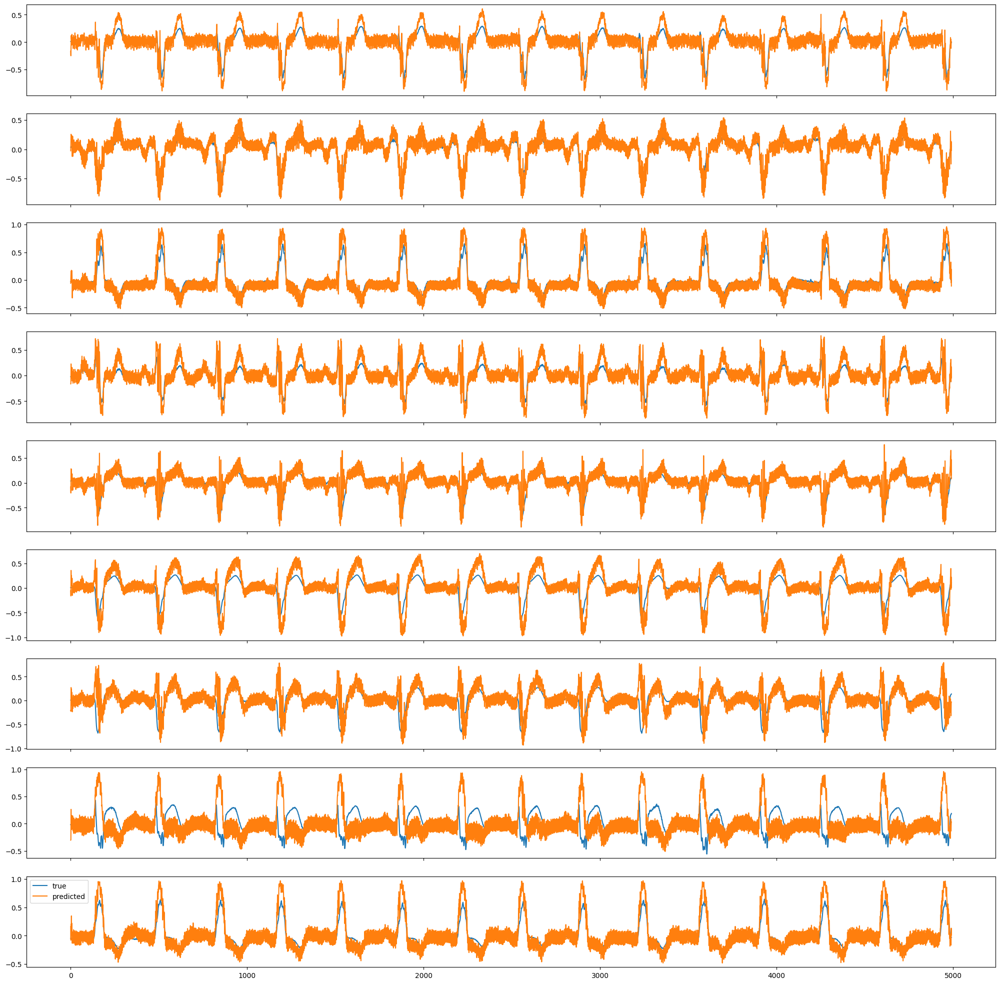

avg R2 score for III: 0.7279830574989319
avg R2 score for aVR: 0.9628853797912598
avg R2 score for aVL: 0.8096910119056702
avg R2 score for aVF: 0.8802407383918762
avg R2 score for V1: 0.8270941972732544
avg R2 score for V3: 0.763508677482605
avg R2 score for V4: 0.6830395460128784
avg R2 score for V5: 0.7796185612678528
avg R2 score for V6: 0.8367464542388916
avg CC score for III: 0.8848505020141602
avg CC score for aVR: 0.9858140349388123
avg CC score for aVL: 0.9045681357383728
avg CC score for aVF: 0.955112636089325
avg CC score for V1: 0.9179441332817078
avg CC score for V3: 0.8913615942001343
avg CC score for V4: 0.8597165942192078
avg CC score for V5: 0.903834342956543
avg CC score for V6: 0.929909348487854
avg R2 score: 0.8078675866127014
avg CC score: 0.914790153503418
Avg MAE: 0.02270357310771942
Epoch [11/100], Step [1]
L1 Loss: 0.020740866661071777, Gan Loss: 0.6853763461112976
Total D Loss: 0.6867857575416565, Total G Loss: 2.75946307182312
Epoch [11/100], Step [501]
L1 Lo

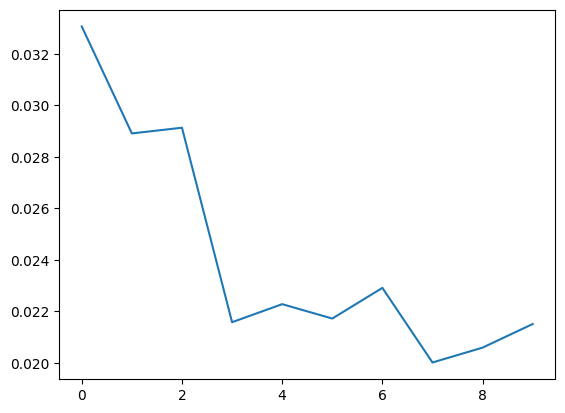

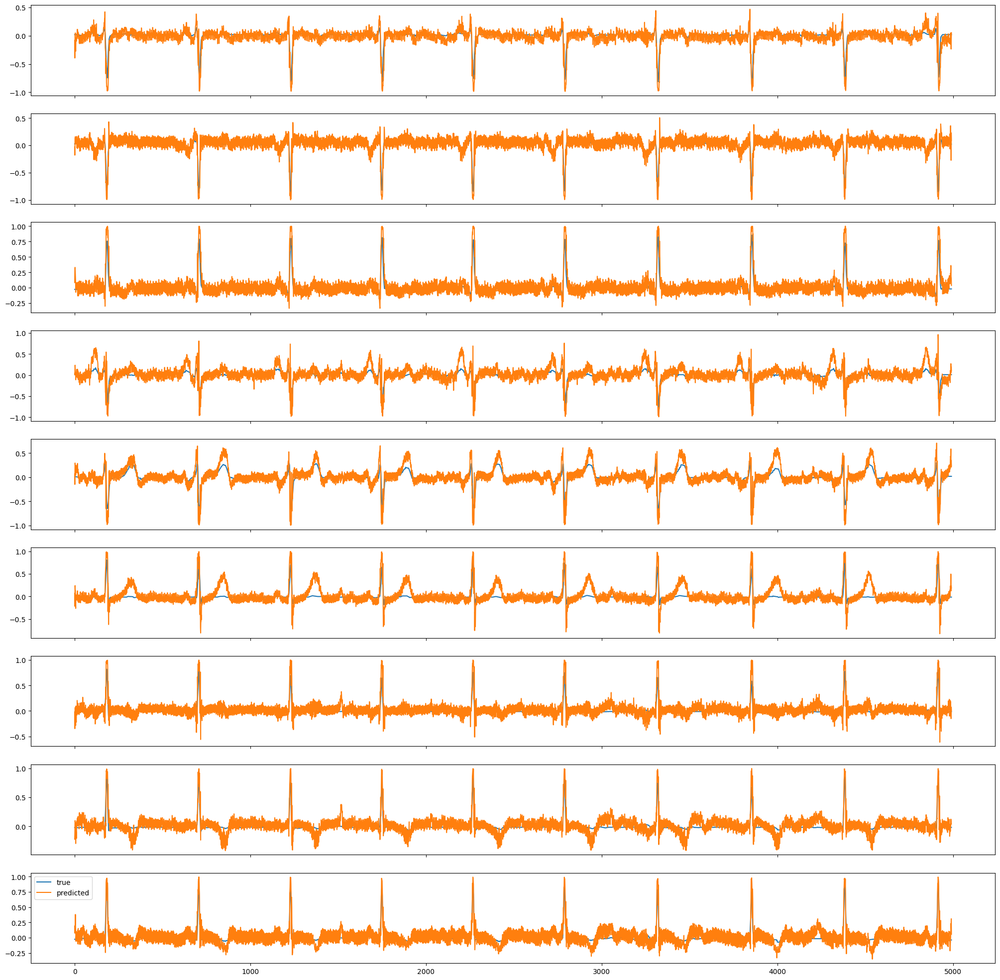

avg R2 score for III: 0.8213962912559509
avg R2 score for aVR: 0.9764332175254822
avg R2 score for aVL: 0.8973333835601807
avg R2 score for aVF: 0.9078554511070251
avg R2 score for V1: 0.8547610640525818
avg R2 score for V3: 0.8186976313591003
avg R2 score for V4: 0.7280331254005432
avg R2 score for V5: 0.8089972734451294
avg R2 score for V6: 0.8454874753952026
avg CC score for III: 0.9212657809257507
avg CC score for aVR: 0.9919859170913696
avg CC score for aVL: 0.9525277614593506
avg CC score for aVF: 0.9651506543159485
avg CC score for V1: 0.9337310194969177
avg CC score for V3: 0.921294093132019
avg CC score for V4: 0.8760407567024231
avg CC score for V5: 0.9133999347686768
avg CC score for V6: 0.9317952990531921
avg R2 score: 0.8509994149208069
avg CC score: 0.9341323375701904
Avg MAE: 0.02007376216351986
Epoch [12/100], Step [1]
L1 Loss: 0.01903870329260826, Gan Loss: 0.6996711492538452
Total D Loss: 0.6774278879165649, Total G Loss: 2.603541374206543
Epoch [12/100], Step [501]
L

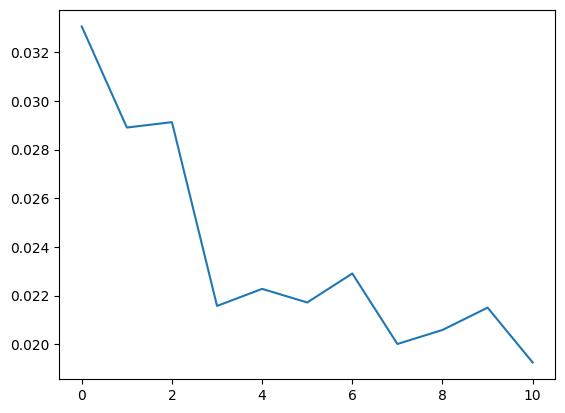

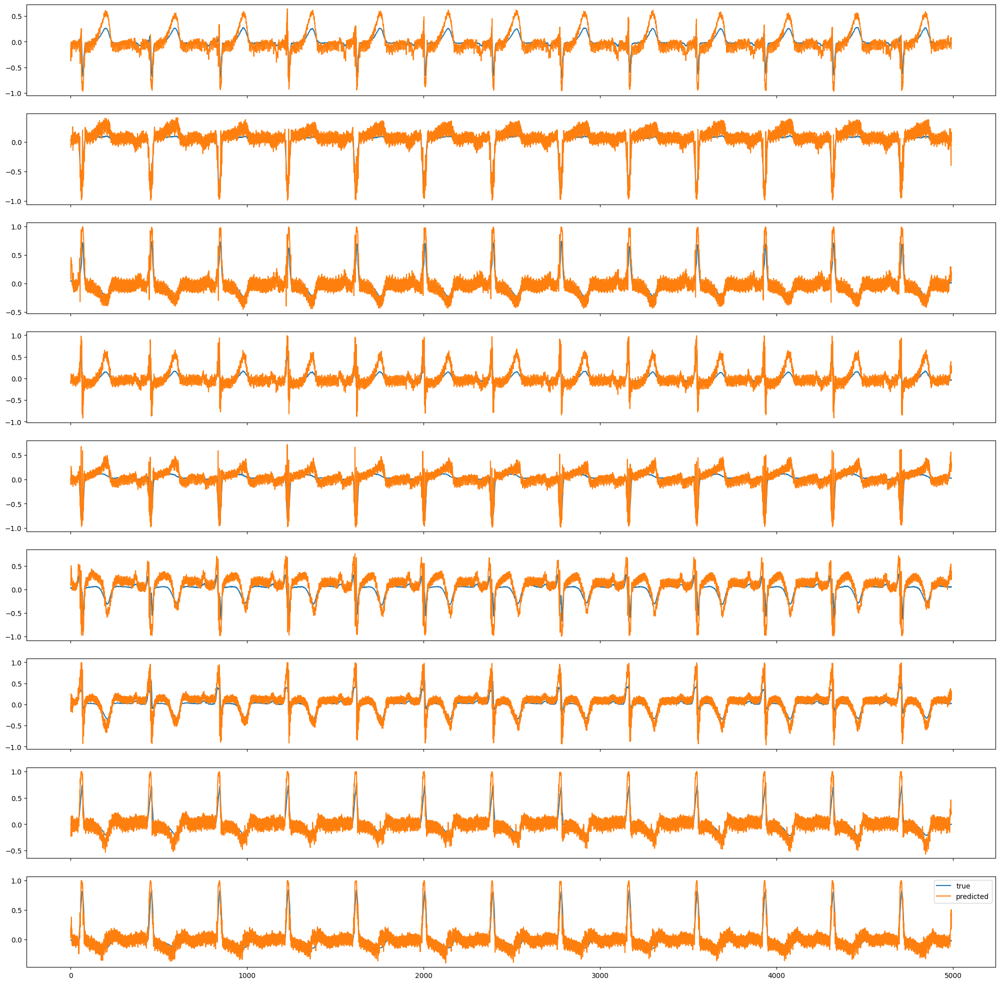

avg R2 score for III: 0.8124539256095886
avg R2 score for aVR: 0.97365802526474
avg R2 score for aVL: 0.8378599882125854
avg R2 score for aVF: 0.9252219796180725
avg R2 score for V1: 0.8488680124282837
avg R2 score for V3: 0.7894320487976074
avg R2 score for V4: 0.6956654191017151
avg R2 score for V5: 0.7810143828392029
avg R2 score for V6: 0.838079035282135
avg CC score for III: 0.9174274206161499
avg CC score for aVR: 0.9916619062423706
avg CC score for aVL: 0.922584593296051
avg CC score for aVF: 0.9707503318786621
avg CC score for V1: 0.9370384812355042
avg CC score for V3: 0.9183840155601501
avg CC score for V4: 0.8791548609733582
avg CC score for V5: 0.9011607766151428
avg CC score for V6: 0.9300366044044495
avg R2 score: 0.8335835933685303
avg CC score: 0.9297999143600464
Avg MAE: 0.02061486802995205
Epoch [13/100], Step [1]
L1 Loss: 0.01990416832268238, Gan Loss: 0.6636932492256165
Total D Loss: 0.6935650110244751, Total G Loss: 2.6541101932525635
Epoch [13/100], Step [501]
L1 

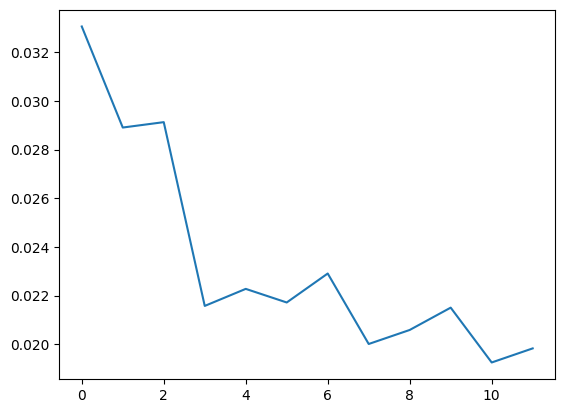

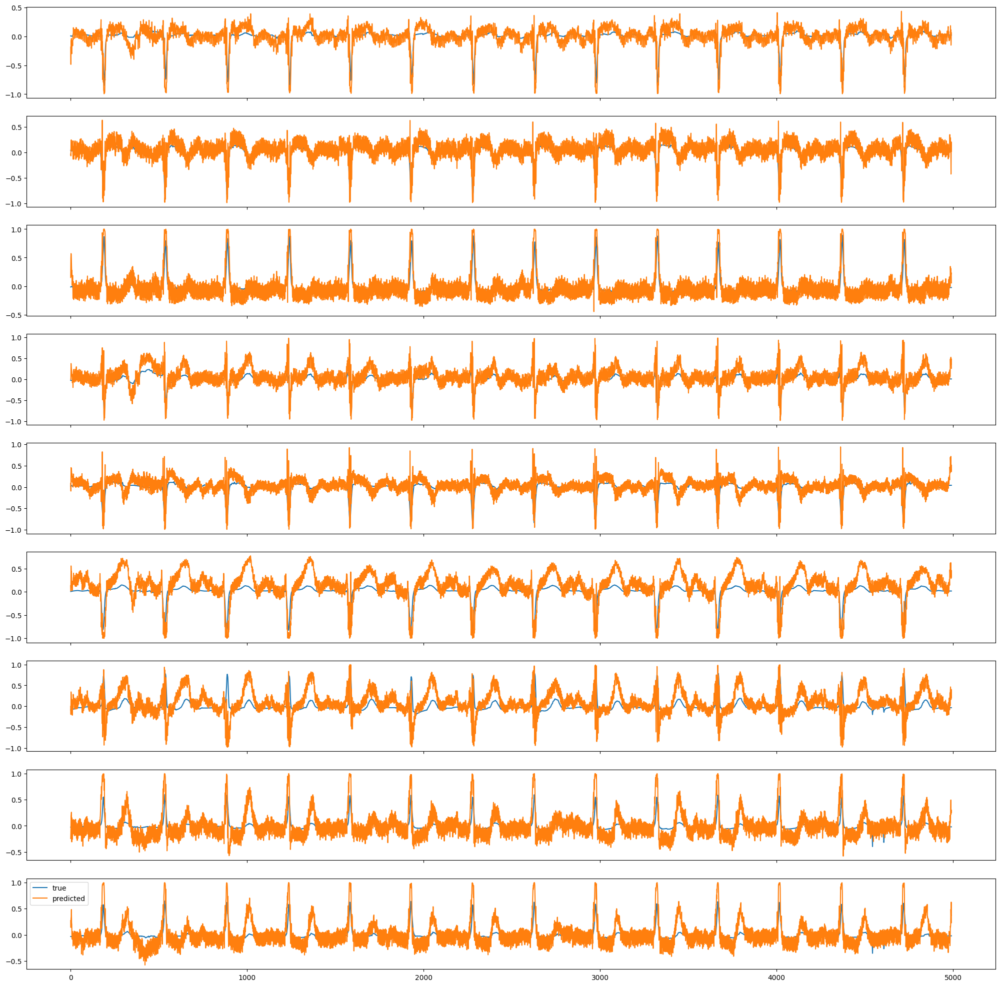

avg R2 score for III: 0.7634629011154175
avg R2 score for aVR: 0.9748812913894653
avg R2 score for aVL: 0.8550149202346802
avg R2 score for aVF: 0.894207239151001
avg R2 score for V1: 0.8480005264282227
avg R2 score for V3: 0.8141694068908691
avg R2 score for V4: 0.7272690534591675
avg R2 score for V5: 0.7833936214447021
avg R2 score for V6: 0.833487331867218
avg CC score for III: 0.9074417352676392
avg CC score for aVR: 0.9901114702224731
avg CC score for aVL: 0.9382032155990601
avg CC score for aVF: 0.9618434906005859
avg CC score for V1: 0.9325653314590454
avg CC score for V3: 0.9253454804420471
avg CC score for V4: 0.8877705931663513
avg CC score for V5: 0.9070958495140076
avg CC score for V6: 0.925432026386261
avg R2 score: 0.8326539993286133
avg CC score: 0.9306454062461853
Avg MAE: 0.021319042891263962
Epoch [14/100], Step [1]
L1 Loss: 0.01879039779305458, Gan Loss: 0.6863923072814941
Total D Loss: 0.6851438879966736, Total G Loss: 2.565432071685791
Epoch [14/100], Step [501]
L1

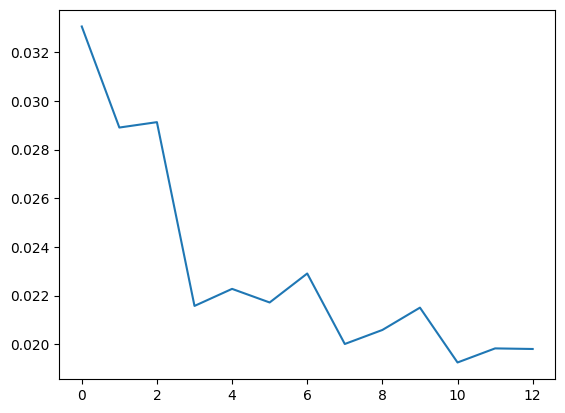

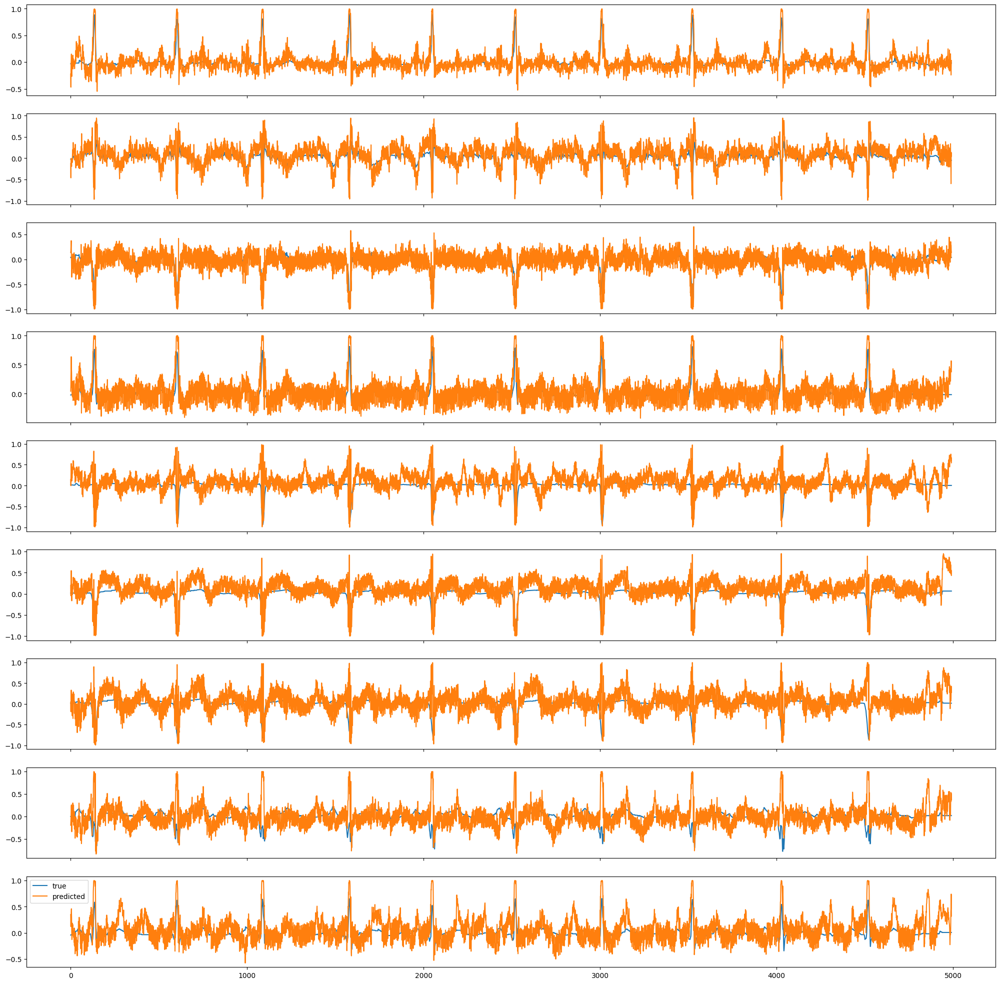

avg R2 score for III: 0.7792780995368958
avg R2 score for aVR: 0.9658255577087402
avg R2 score for aVL: 0.8899957537651062
avg R2 score for aVF: 0.8820266127586365
avg R2 score for V1: 0.8406941890716553
avg R2 score for V3: 0.7683036923408508
avg R2 score for V4: 0.6775972843170166
avg R2 score for V5: 0.7500144243240356
avg R2 score for V6: 0.8044825792312622
avg CC score for III: 0.917487621307373
avg CC score for aVR: 0.9885016083717346
avg CC score for aVL: 0.9571391940116882
avg CC score for aVF: 0.9633085131645203
avg CC score for V1: 0.93104487657547
avg CC score for V3: 0.9062315821647644
avg CC score for V4: 0.880171537399292
avg CC score for V5: 0.904841423034668
avg CC score for V6: 0.9283605813980103
avg R2 score: 0.8175798058509827
avg CC score: 0.9307875037193298
Avg MAE: 0.022599082440137863
Epoch [15/100], Step [1]
L1 Loss: 0.021497884765267372, Gan Loss: 0.6085032224655151
Total D Loss: 0.7174665927886963, Total G Loss: 2.758291721343994
Epoch [15/100], Step [501]
L1 

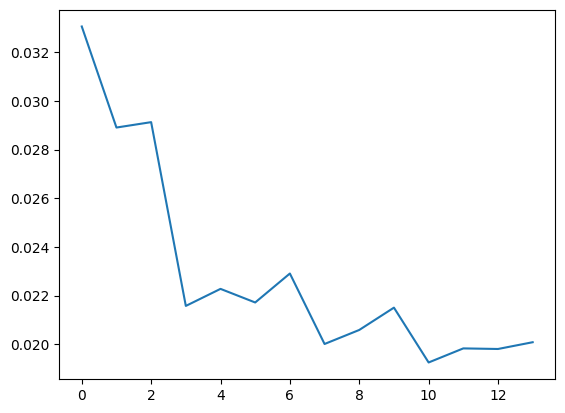

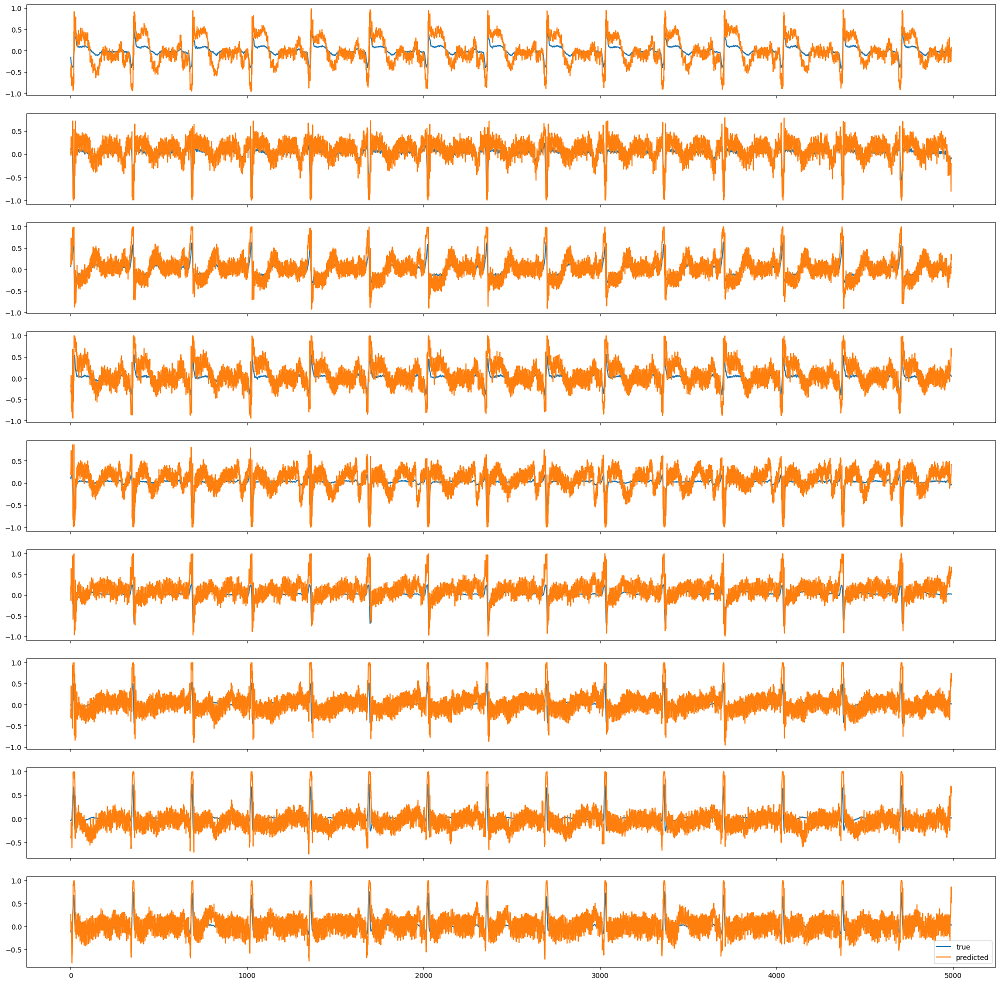

avg R2 score for III: 0.8042718172073364
avg R2 score for aVR: 0.9679719805717468
avg R2 score for aVL: 0.8553708791732788
avg R2 score for aVF: 0.9228804707527161
avg R2 score for V1: 0.8292909264564514
avg R2 score for V3: 0.7858708500862122
avg R2 score for V4: 0.6913732886314392
avg R2 score for V5: 0.7419645190238953
avg R2 score for V6: 0.8035795092582703
avg CC score for III: 0.9243698716163635
avg CC score for aVR: 0.9913402795791626
avg CC score for aVL: 0.938400149345398
avg CC score for aVF: 0.973337709903717
avg CC score for V1: 0.930332362651825
avg CC score for V3: 0.9149712920188904
avg CC score for V4: 0.884692907333374
avg CC score for V5: 0.8983404040336609
avg CC score for V6: 0.9209508299827576
avg R2 score: 0.8225082159042358
avg CC score: 0.9307484030723572
Avg MAE: 0.022202547639608383


Exception: Training finished.

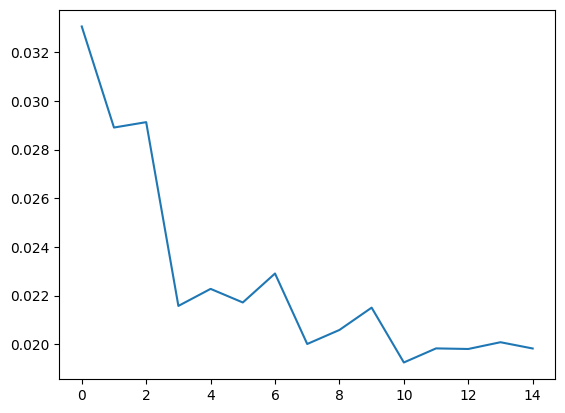

In [115]:
# Training
num_epochs = 100
N = 100
test_losses = []
best_r2_score = 0
counter = 0

for epoch in range(num_epochs):
    for i, (input_img, target_img) in enumerate(train_loader):
        input_img = input_img.to(device)
        target_img = target_img.to(device)

        # Train Discriminator
        optimizer_D.zero_grad()
        fake_img = generator(input_img)
        real_output = discriminator(input_img, target_img)
        fake_output = discriminator(input_img, fake_img.detach())
        real_loss = criterion_GAN(real_output, torch.ones_like(real_output))
        fake_loss = criterion_GAN(fake_output, torch.zeros_like(fake_output))
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        fake_output = discriminator(input_img, fake_img)
        gan_loss = criterion_GAN(fake_output, torch.ones_like(fake_output))
        l1_loss = criterion_L1(fake_img, target_img)
        g_loss = gan_loss + N * l1_loss
        g_loss.backward()
        optimizer_G.step()
            
        if (i % 500 == 0):
            print(f"Epoch [{epoch+1}/{num_epochs}], Step [{i+1}]")
            print(f"L1 Loss: {l1_loss.item()}, Gan Loss: {gan_loss.item()}")
            print(f"Total D Loss: {d_loss.item()}, Total G Loss: {g_loss.item()}")
            
    
    with torch.no_grad():
        generator.eval()
        discriminator.eval()
        l1_test_loss = []
        for input_img, target_img in test_loader:
            input_img = input_img.to(device)
            patient_true = target_img.to(device)
            #print(f"patient {index} from test set")
            patient_pred = generator(input_img)
            l1_test_loss.append(criterion_L1(patient_pred, patient_true))

        epoch_avg_test_loss = sum(l1_test_loss)/len(l1_test_loss)
        print(f"Test Loss: {epoch_avg_test_loss}")
        #g_loss = gan_loss + N * l1_loss
        test_losses.append(epoch_avg_test_loss)
        # if epoch > 10 and epoch_avg_test_loss > sum(test_losses)/len(test_losses):
        #     print(f"Stopped Early at Epoch: {epoch}")
        #     break
        
    generator.train()
    discriminator.train()

    sample(generator, X=X_test_alldb, y=y_test_alldb)
    if epoch > 5:
        current_r2_score = compute_metrics(generator, X=X_test_alldb, y=y_test_alldb, num_preds_ratio = 1)
        if current_r2_score > best_r2_score:
            best_r2_score = current_r2_score
            torch.save(generator.state_dict(), 'bestest_generator_final.pt')
            counter = 0
        else:
            if epoch > 10:
                if counter > 2:
                    plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])
                    raise Exception("Training finished.")
                else:
                    counter += 1
    plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])
print("Training finished.")

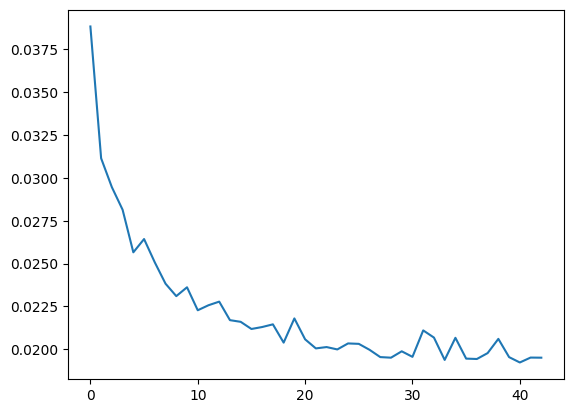

In [74]:
plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])

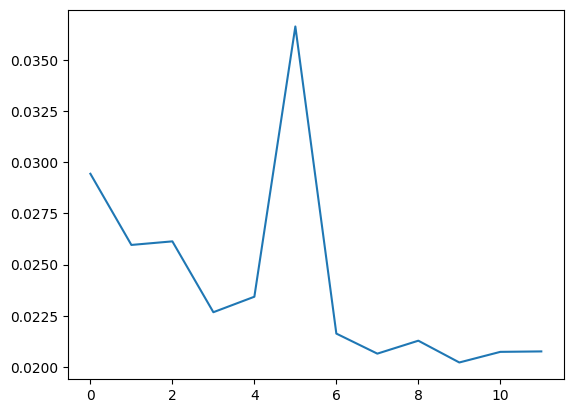

In [109]:
plt.plot([i for i in range(len(test_losses))], [i.to('cpu') for i in test_losses])

### Results

In [119]:
### ONLY IF TESTING NOT TRAINING!!!!
best_state_dict = torch.load('best_generator_final.pt')
test_state_dict = torch.load('bestest_generator_final.pt')
best_generator = Generator(1, 1).to(device)
test_generator = Generator(1, 1).to(device)
best_generator.load_state_dict(best_state_dict)
test_generator.load_state_dict(test_state_dict)

<All keys matched successfully>

In [117]:
compute_metrics(test_generator, X=torch.cat((X_train_ptbdb,X_test_ptbdb)), y=torch.cat((y_train_ptbdb,y_test_ptbdb)), num_preds_ratio = 1)

avg R2 score for III: 0.8753482103347778
avg R2 score for aVR: 0.9697490930557251
avg R2 score for aVL: 0.9141367673873901
avg R2 score for aVF: 0.9340164065361023
avg R2 score for V1: 0.8347302079200745
avg R2 score for V3: 0.8647483587265015
avg R2 score for V4: 0.6685481667518616
avg R2 score for V5: 0.680280864238739
avg R2 score for V6: 0.7598485946655273
avg CC score for III: 0.9456267356872559
avg CC score for aVR: 0.9878559112548828
avg CC score for aVL: 0.9637457132339478
avg CC score for aVF: 0.9737665057182312
avg CC score for V1: 0.9235357642173767
avg CC score for V3: 0.9372468590736389
avg CC score for V4: 0.845964789390564
avg CC score for V5: 0.8328904509544373
avg CC score for V6: 0.8812694549560547
avg R2 score: 0.8334896564483643
avg CC score: 0.9213225245475769
Avg MAE: 0.021946795284748077


tensor(0.8335)

In [118]:
compute_metrics(test_generator, X=torch.cat((X_train_ptbxl,X_test_ptbxl)), y=torch.cat((y_train_ptbxl,y_test_ptbxl)), num_preds_ratio = 1)

avg R2 score for III: 0.8262712359428406
avg R2 score for aVR: 0.9740472435951233
avg R2 score for aVL: 0.8943184018135071
avg R2 score for aVF: 0.9146960973739624
avg R2 score for V1: 0.8432857990264893
avg R2 score for V3: 0.8219279050827026
avg R2 score for V4: 0.7600885033607483
avg R2 score for V5: 0.8191552758216858
avg R2 score for V6: 0.8622775673866272
avg CC score for III: 0.9240272045135498
avg CC score for aVR: 0.989586591720581
avg CC score for aVL: 0.9502187967300415
avg CC score for aVF: 0.9661534428596497
avg CC score for V1: 0.9281059503555298
avg CC score for V3: 0.9180842638015747
avg CC score for V4: 0.8872002959251404
avg CC score for V5: 0.9113382697105408
avg CC score for V6: 0.9356760382652283
avg R2 score: 0.8573408722877502
avg CC score: 0.9344878792762756
Avg MAE: 0.019821200519800186


tensor(0.8573)

In [120]:
compute_metrics(best_generator, X=torch.cat((X_train_ptbdb,X_test_ptbdb)), y=torch.cat((y_train_ptbdb,y_test_ptbdb)), num_preds_ratio = 1)

avg R2 score for III: 0.8878481388092041
avg R2 score for aVR: 0.9729824066162109
avg R2 score for aVL: 0.9183260798454285
avg R2 score for aVF: 0.9355728030204773
avg R2 score for V1: 0.8221064209938049
avg R2 score for V3: 0.8710543513298035
avg R2 score for V4: 0.689637303352356
avg R2 score for V5: 0.7250013947486877
avg R2 score for V6: 0.7763298749923706
avg CC score for III: 0.9508563876152039
avg CC score for aVR: 0.9912346005439758
avg CC score for aVL: 0.9660940170288086
avg CC score for aVF: 0.9778051972389221
avg CC score for V1: 0.9258806705474854
avg CC score for V3: 0.9448744058609009
avg CC score for V4: 0.8484984040260315
avg CC score for V5: 0.8532787561416626
avg CC score for V6: 0.8877253532409668
avg R2 score: 0.8443176746368408
avg CC score: 0.9273607730865479
Avg MAE: 0.022811027243733406


tensor(0.8443)

In [121]:
compute_metrics(best_generator, X=torch.cat((X_train_ptbxl,X_test_ptbxl)), y=torch.cat((y_train_ptbxl,y_test_ptbxl)), num_preds_ratio = 1)

avg R2 score for III: 0.7781639695167542
avg R2 score for aVR: 0.9758508205413818
avg R2 score for aVL: 0.8311355113983154
avg R2 score for aVF: 0.9154834151268005
avg R2 score for V1: 0.8425065279006958
avg R2 score for V3: 0.816792905330658
avg R2 score for V4: 0.7808886766433716
avg R2 score for V5: 0.8369078040122986
avg R2 score for V6: 0.8580021262168884
avg CC score for III: 0.9015561938285828
avg CC score for aVR: 0.9917415380477905
avg CC score for aVL: 0.9214717149734497
avg CC score for aVF: 0.9685342311859131
avg CC score for V1: 0.9361777305603027
avg CC score for V3: 0.9181911945343018
avg CC score for V4: 0.891330897808075
avg CC score for V5: 0.9210182428359985
avg CC score for V6: 0.9351023435592651
avg R2 score: 0.8484146595001221
avg CC score: 0.9316803812980652
Avg MAE: 0.021664585918188095


tensor(0.8484)

In [997]:
compute_metrics(test_generator, X=X_test_ptbdb, y=y_test_ptbdb, num_preds_ratio = 1)

avg R2 score for III: 0.9041444659233093
avg R2 score for aVR: 0.9771047830581665
avg R2 score for aVL: 0.9520943760871887
avg R2 score for aVF: 0.9518340229988098
avg R2 score for V1: 0.8750513195991516
avg R2 score for V3: 0.8867736458778381
avg R2 score for V4: 0.6567413806915283
avg R2 score for V5: 0.6881424784660339
avg R2 score for V6: 0.7742029428482056
avg CC score for III: 0.9570623636245728
avg CC score for aVR: 0.9911781549453735
avg CC score for aVL: 0.9796123504638672
avg CC score for aVF: 0.9795265197753906
avg CC score for V1: 0.9433387517929077
avg CC score for V3: 0.9489545226097107
avg CC score for V4: 0.8547775745391846
avg CC score for V5: 0.8532382249832153
avg CC score for V6: 0.896120011806488
avg R2 score: 0.8517876863479614
avg CC score: 0.9337565302848816
Avg MAE: 0.179144024848938


In [994]:
compute_metrics(generator, X=X_test_ptbdb, y=y_test_ptbdb, num_preds_ratio = 1)

avg R2 score for III: 0.909586489200592
avg R2 score for aVR: 0.9765156507492065
avg R2 score for aVL: 0.9494005441665649
avg R2 score for aVF: 0.9543986916542053
avg R2 score for V1: 0.8723655939102173
avg R2 score for V3: 0.8901511430740356
avg R2 score for V4: 0.6518449187278748
avg R2 score for V5: 0.7010539174079895
avg R2 score for V6: 0.7798808813095093
avg CC score for III: 0.9609375596046448
avg CC score for aVR: 0.9920220971107483
avg CC score for aVL: 0.9791670441627502
avg CC score for aVF: 0.981329083442688
avg CC score for V1: 0.940278947353363
avg CC score for V3: 0.9524742960929871
avg CC score for V4: 0.8544132709503174
avg CC score for V5: 0.8551034927368164
avg CC score for V6: 0.8955429196357727
avg R2 score: 0.8539108633995056
avg CC score: 0.934585452079773
Avg MAE: 0.18121354281902313


In [ ]:
compute_metrics(generator, X=X_test_WFDB, y=y_test_WFDB, num_preds_ratio = 1)

In [808]:
compute_metrics(test_generator, X=X_test_WFDB, y=y_test_WFDB, num_preds_ratio = 1)

avg R2 score for III: 0.9220448136329651
avg R2 score for aVR: 0.984952986240387
avg R2 score for aVL: 0.932612955570221
avg R2 score for aVF: 0.9680029153823853
avg R2 score for V1: 0.7762766480445862
avg R2 score for V3: 0.8183363080024719
avg R2 score for V4: 0.8030358552932739
avg R2 score for V5: 0.8314886093139648
avg R2 score for V6: 0.8180562853813171
avg CC score for III: 0.9666684865951538
avg CC score for aVR: 0.9941547513008118
avg CC score for aVL: 0.9711855053901672
avg CC score for aVF: 0.9867870807647705
avg CC score for V1: 0.8980785012245178
avg CC score for V3: 0.9197503328323364
avg CC score for V4: 0.9087125062942505
avg CC score for V5: 0.9273734092712402
avg CC score for V6: 0.9235274195671082
avg R2 score: 0.8727563619613647
avg CC score: 0.9440264105796814
Avg MAE: 0.16364847123622894


In [998]:
compute_metrics(test_generator, X=torch.cat((X_train_ptbxl,X_test_ptbxl)), y=torch.cat((y_train_ptbxl,y_test_ptbxl)), num_preds_ratio = 1)

avg R2 score for III: 0.777404248714447
avg R2 score for aVR: 0.977411687374115
avg R2 score for aVL: 0.8911401629447937
avg R2 score for aVF: 0.9011569023132324
avg R2 score for V1: 0.8243663311004639
avg R2 score for V3: 0.8233416080474854
avg R2 score for V4: 0.7723023891448975
avg R2 score for V5: 0.8324945569038391
avg R2 score for V6: 0.8700130581855774
avg CC score for III: 0.8986596465110779
avg CC score for aVR: 0.9913482666015625
avg CC score for aVL: 0.9473130702972412
avg CC score for aVF: 0.9603990912437439
avg CC score for V1: 0.9192693829536438
avg CC score for V3: 0.9187029004096985
avg CC score for V4: 0.8915442824363708
avg CC score for V5: 0.921096682548523
avg CC score for V6: 0.9415689706802368
avg R2 score: 0.8521811962127686
avg CC score: 0.9322114586830139
Avg MAE: 0.17782488465309143


In [41]:
compute_metrics(generator, X=X_test_ptbxl, y=y_test_ptbxl, num_preds_ratio = 1)

avg R2 score for III: 0.7927505373954773
avg R2 score for aVR: 0.9758790135383606
avg R2 score for aVL: 0.8906744122505188
avg R2 score for aVF: 0.9032529592514038
avg R2 score for V1: 0.829798698425293
avg R2 score for V3: 0.8102869987487793
avg R2 score for V4: 0.7733938097953796
avg R2 score for V5: 0.8348205089569092
avg R2 score for V6: 0.8652670383453369
avg CC score for III: 0.9036221504211426
avg CC score for aVR: 0.9903520941734314
avg CC score for aVL: 0.94677734375
avg CC score for aVF: 0.9596433043479919
avg CC score for V1: 0.9190810918807983
avg CC score for V3: 0.9165535569190979
avg CC score for V4: 0.8941415548324585
avg CC score for V5: 0.9251607656478882
avg CC score for V6: 0.9384151697158813
avg R2 score: 0.8529026508331299
avg CC score: 0.9326385855674744
Avg MAE: 0.01981505937874317


In [42]:
compute_metrics(generator, X=torch.cat((X_train_ptbxl,X_test_ptbxl)), y=torch.cat((y_train_ptbxl,y_test_ptbxl)), num_preds_ratio = 1)

avg R2 score for III: 0.8103013038635254
avg R2 score for aVR: 0.9765203595161438
avg R2 score for aVL: 0.8998907208442688
avg R2 score for aVF: 0.9110924601554871
avg R2 score for V1: 0.8240891098976135
avg R2 score for V3: 0.8184122443199158
avg R2 score for V4: 0.7744026780128479
avg R2 score for V5: 0.8320599794387817
avg R2 score for V6: 0.8672982454299927
avg CC score for III: 0.9111093282699585
avg CC score for aVR: 0.9904850721359253
avg CC score for aVL: 0.9517159461975098
avg CC score for aVF: 0.9632705450057983
avg CC score for V1: 0.9170814752578735
avg CC score for V3: 0.9205115437507629
avg CC score for V4: 0.8945162296295166
avg CC score for V5: 0.9232791662216187
avg CC score for V6: 0.9400019645690918
avg R2 score: 0.857118546962738
avg CC score: 0.9346634745597839
Avg MAE: 0.019445903599262238


In [839]:
compute_metrics(test_generator, X=X_test_ptbxl, y=y_test_ptbxl, num_preds_ratio = 1)

avg R2 score for III: 0.7579148411750793
avg R2 score for aVR: 0.9754132628440857
avg R2 score for aVL: 0.878530740737915
avg R2 score for aVF: 0.8928389549255371
avg R2 score for V1: 0.8317018151283264
avg R2 score for V3: 0.8147818446159363
avg R2 score for V4: 0.7664878964424133
avg R2 score for V5: 0.834833025932312
avg R2 score for V6: 0.865505576133728
avg CC score for III: 0.8906256556510925
avg CC score for aVR: 0.9908442497253418
avg CC score for aVL: 0.9409027695655823
avg CC score for aVF: 0.9567640423774719
avg CC score for V1: 0.9214196801185608
avg CC score for V3: 0.9141756892204285
avg CC score for V4: 0.8895804286003113
avg CC score for V5: 0.9227043986320496
avg CC score for V6: 0.9388895034790039
avg R2 score: 0.8464453220367432
avg CC score: 0.9295451045036316
Avg MAE: 0.18151602149009705


In [40]:
compute_metrics(generator, X=X_test_incart, y=y_test_incart, num_preds_ratio = 1, skip_indices=[15,21])

avg R2 score for III: 0.8539612889289856
avg R2 score for aVR: 0.9438508749008179
avg R2 score for aVL: 0.6304050087928772
avg R2 score for aVF: 0.9527312517166138
avg R2 score for V1: 0.8508140444755554
avg R2 score for V3: 0.5263820886611938
avg R2 score for V4: 0.4870745837688446
avg R2 score for V5: 0.6136033535003662
avg R2 score for V6: 0.6968715190887451
avg CC score for III: 0.932573139667511
avg CC score for aVR: 0.9761315584182739
avg CC score for aVL: 0.8231985569000244
avg CC score for aVF: 0.9795172214508057
avg CC score for V1: 0.9360562562942505
avg CC score for V3: 0.7840000987052917
avg CC score for V4: 0.7155203819274902
avg CC score for V5: 0.8040372133255005
avg CC score for V6: 0.8400126695632935
avg R2 score: 0.7284104228019714
avg CC score: 0.8656718730926514
Avg MAE: 0.022519659250974655


In [32]:
compute_metrics(test_generator, X=X_test_incart, y=y_test_incart, num_preds_ratio = 1, skip_indices=[15,21])

avg R2 score for III: 0.8976856470108032
avg R2 score for aVR: 0.9559561610221863
avg R2 score for aVL: 0.7142919898033142
avg R2 score for aVF: 0.9675351977348328
avg R2 score for V1: 0.8630774617195129
avg R2 score for V3: 0.6517932415008545
avg R2 score for V4: 0.6633223295211792
avg R2 score for V5: 0.724685788154602
avg R2 score for V6: 0.7660735845565796
avg CC score for III: 0.9533089995384216
avg CC score for aVR: 0.9835834503173828
avg CC score for aVL: 0.8683381080627441
avg CC score for aVF: 0.9868004322052002
avg CC score for V1: 0.9422085285186768
avg CC score for V3: 0.8263018131256104
avg CC score for V4: 0.837105929851532
avg CC score for V5: 0.8708667159080505
avg CC score for V6: 0.8759279251098633
avg R2 score: 0.8004912734031677
avg CC score: 0.9049379825592041
Avg MAE: 0.019752318039536476


In [15]:
torch.save(generator.state_dict(), 'best_generator_v4.pt')

In [54]:
torch.save(discriminator.state_dict(), 'best_discriminator.pt')

In [55]:
torch.save({'generator_optimizer': optimizer_G.state_dict(), 'discriminator_optimizer': optimizer_D.state_dict()}, 'optim_state_dicts.pt')

Index: 140


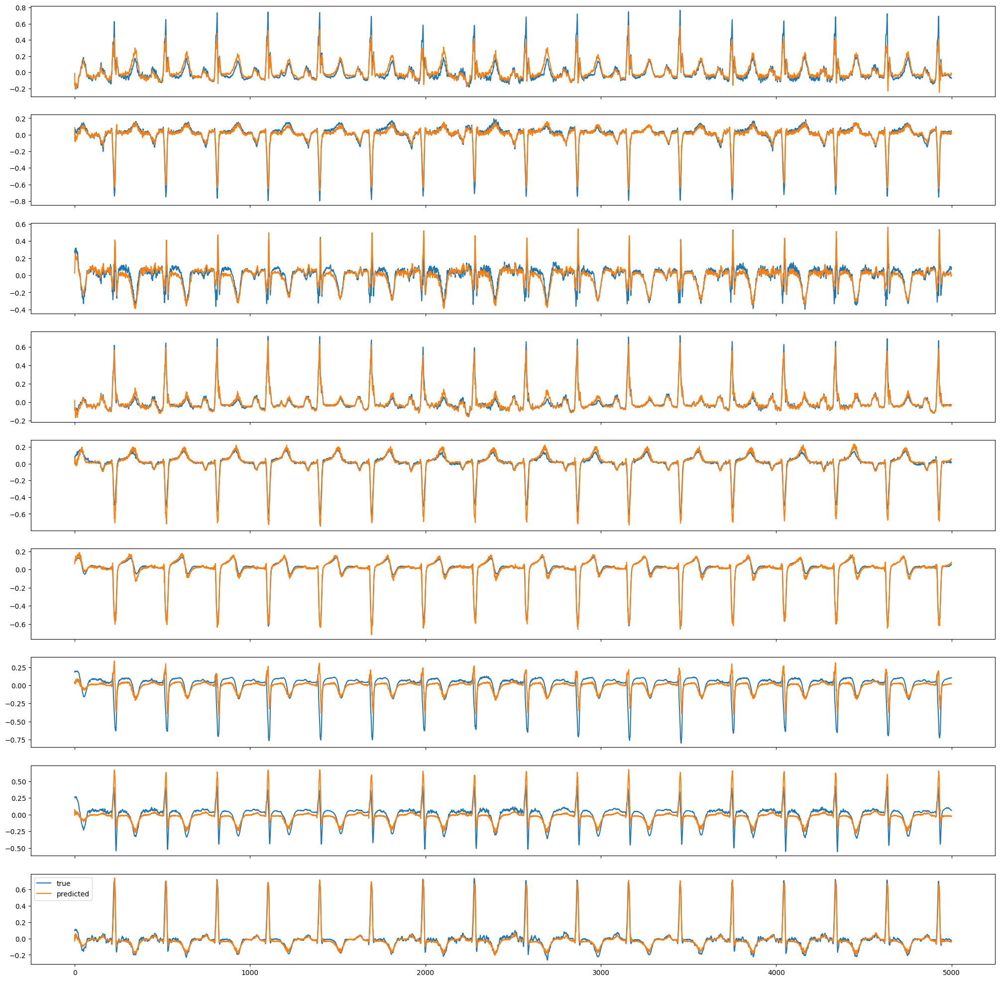

In [22]:
sample(generator, X=X_train_ptbdb, y=y_train_ptbdb, length=5000)

Index: 21


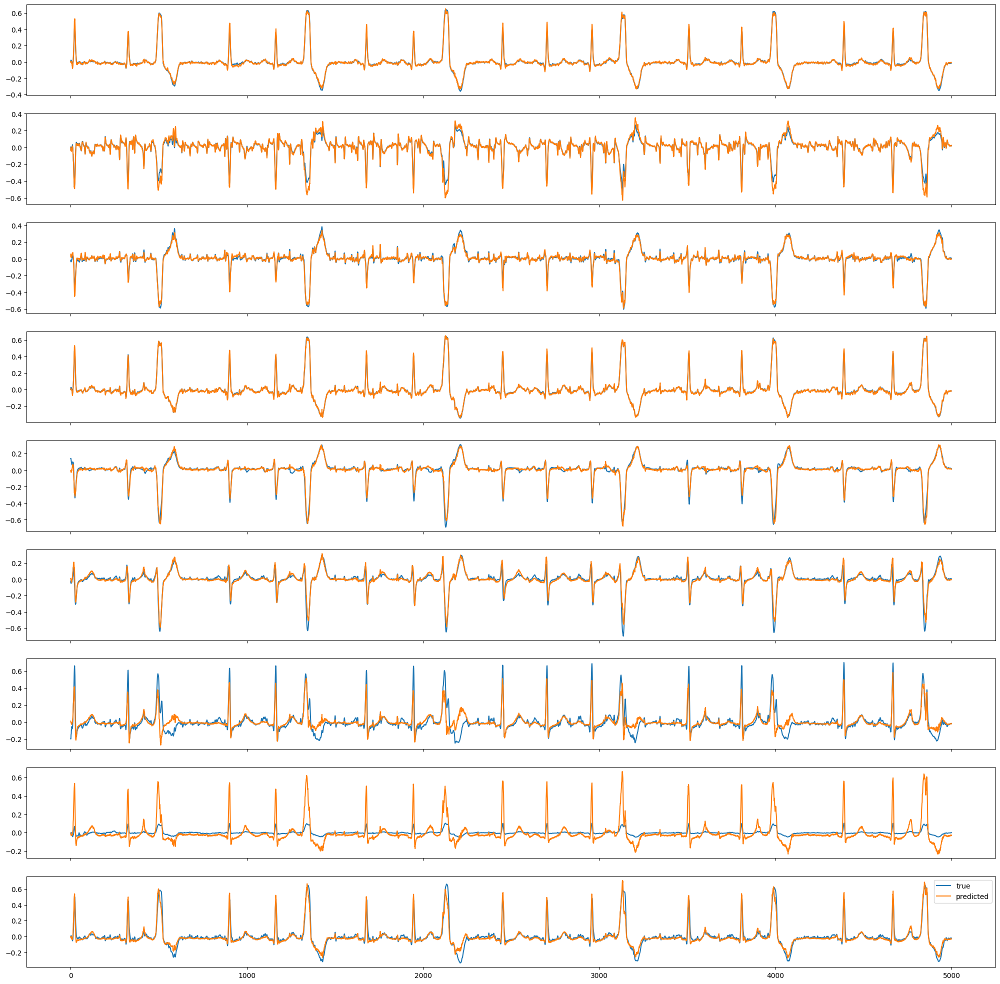

In [815]:
sample(test_generator, X=X_test_incart, y=y_test_incart,length=5000, index=21)

In [98]:
X_test_incart.shape

torch.Size([32, 1, 3, 14592])

In [100]:
generator.eval()
output = generator(X_test_incart[12].to(device))
output.shape

torch.Size([1, 1, 9, 14592])

In [213]:
index = 21
patient_pred = generator(X_test_incart[index].unsqueeze(0).to(device))[0,0].detach().cpu()
patient_true = y_test_incart[index,0]

avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
for i in range(9):
    #z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
    #avg_pearsoncorr_score[leads[i + 3]] += z[0,1]
    avg_r2_score[leads[i + 3]] += r2_score(patient_pred[i], patient_true[i])
    #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
for i in range(9):
    #print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
    print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")

avg R2 score for III: 0.9820821285247803
avg R2 score for aVR: 0.944968044757843
avg R2 score for aVL: 0.9569369554519653
avg R2 score for aVF: 0.9913856387138367
avg R2 score for V1: 0.94279944896698
avg R2 score for V3: 0.831372082233429
avg R2 score for V4: 0.6437737345695496
avg R2 score for V5: -4.799623012542725
avg R2 score for V6: 0.8564413785934448
avg R2 score: 0.26112625002861023


In [177]:
sus = [(15,-2),(21,-2)]
stillvalid = [(29,-4), (19,-4), (30,-4)]

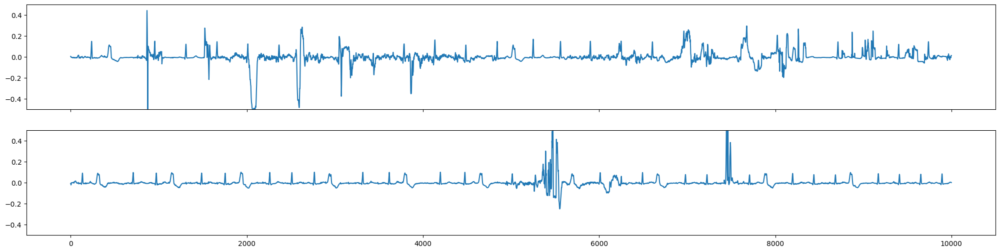

In [218]:
plt.subplots(len(sus), 1, sharex='all', figsize=(25,3*len(sus)))
for i,j in enumerate(sus):
    plt.subplot(len(sus), 1, i+1)
    plt.ylim(-0.5,0.5)
    plt.plot(y_test_incart[j[0],0,j[1]][:10000])

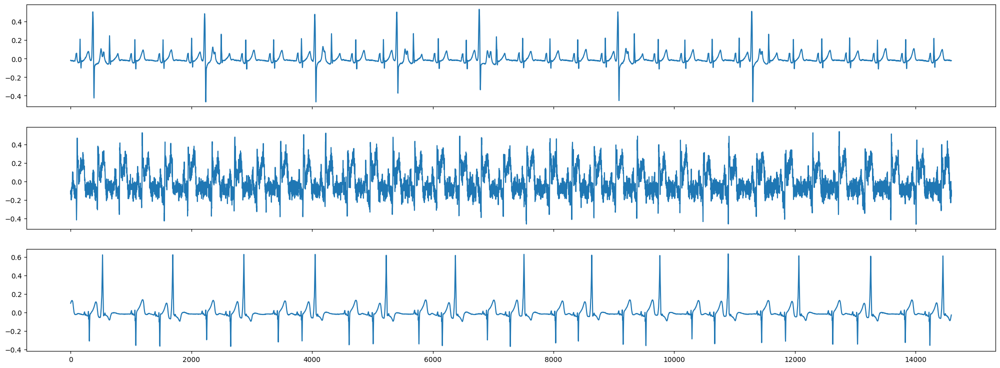

In [181]:
plt.subplots(len(stillvalid), 1, sharex='all', figsize=(25,3*len(stillvalid)))
for i,j in enumerate(stillvalid):
    plt.subplot(len(stillvalid), 1, i+1)
    plt.plot(y_test_incart[j[0],0,j[1]])

### Extra test or train data

#### CPSC

In [442]:
# cpsc_extra_dir = "physionet.org/files/challenge-2021/1.0.3/training/cpsc_2018_extra"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# cpsc_extra_data = []
# for folder in os.listdir(cpsc_extra_dir):
#     i = os.path.join(cpsc_extra_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'mat':
#                 cpsc_extra_data.append(torch.tensor(io.loadmat(datafile)['val'], dtype=torch.float32))

# cpsc_dir = "physionet.org/files/challenge-2021/1.0.3/training/cpsc_2018"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# cpsc_data = []
# for folder in os.listdir(cpsc_dir):
#     i = os.path.join(cpsc_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'mat':
#                 cpsc_data.append(torch.tensor(io.loadmat(datafile)['val'], dtype=torch.float32))

In [293]:
# all are 500 hz
# cpsc_dir = "physionet.org/files/challenge-2021/1.0.3/training/cpsc_2018"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# cpsc_data = []
# for folder in os.listdir(cpsc_dir):
#     i = os.path.join(cpsc_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'hea':
#                 with open(datafile) as f:
#                     lines = f.readline()
#                     if lines.split()[-2] != '500':
#                         print(f"bad, {datafile}")

# cpsc_extra_dir = "physionet.org/files/challenge-2021/1.0.3/training/cpsc_2018_extra"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# for folder in os.listdir(cpsc_extra_dir):
#     i = os.path.join(cpsc_extra_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'hea':
#                 with open(datafile) as f:
#                     lines = f.readline()
#                     if lines.split()[-2] != '500':
#                         print(f"bad, {datafile}")

In [71]:
total_cpsc_data_baseline_corrected = torch.load('baseline_corrected_cpsc_all.pt')
len(total_cpsc_data_baseline_corrected)

10330

In [72]:
# data normalization
bad_indices = []
for i in range(len(total_cpsc_data_baseline_corrected)):
    for j in range(12):
        if torch.max(total_cpsc_data_baseline_corrected[i][j]) - torch.min(total_cpsc_data_baseline_corrected[i][j]) < 1e-5:
            print(f"nan error at index {i}, lead {j}")
            bad_indices.append(i)
        #print(X_cpsc_data_windowed[i,0,j].shape)
        total_cpsc_data_baseline_corrected[i][j] = (total_cpsc_data_baseline_corrected[i][j]-torch.mean(total_cpsc_data_baseline_corrected[i][j]))/(torch.max(total_cpsc_data_baseline_corrected[i][j]) - torch.min(total_cpsc_data_baseline_corrected[i][j]))
        # total_cpsc_data_baseline_corrected[i][j] *= 1/torch.max(torch.abs(total_cpsc_data_baseline_corrected[i][j]))
        # if torch.isnan(total_cpsc_data_baseline_corrected[i][j]).any():
        #     print(f"nan error at index {i}, lead {j}")
        #     bad_indices.append(i)
    # for j in range(9):
    #     if torch.max(y_cpsc_data_windowed[i,0,j]) - torch.min(y_cpsc_data_windowed[i,0,j]) < 1e-5:
    #         print(f"nan error at train index {i}, lead {j+3}")
    #         bad_indices.append(i)
    #     #print(y_cpsc_data_windowed[i,0,j].shape)
    #     y_cpsc_data_windowed[i,0,j] = (y_cpsc_data_windowed[i,0,j]-torch.mean(y_cpsc_data_windowed[i,0,j]))/(torch.max(y_cpsc_data_windowed[i,0,j]) - torch.min(y_cpsc_data_windowed[i,0,j]))

records_to_keep = []
for i in range(len(total_cpsc_data_baseline_corrected)):
    if i not in bad_indices:
        records_to_keep.append(i)
len(records_to_keep)
# WFDB_records = WFDB_records[records_to_keep]
# WFDB_records.shape

nan error at index 262, lead 0
nan error at index 262, lead 1
nan error at index 262, lead 2
nan error at index 262, lead 3
nan error at index 262, lead 4
nan error at index 262, lead 5
nan error at index 262, lead 6
nan error at index 262, lead 7
nan error at index 262, lead 8
nan error at index 262, lead 9
nan error at index 262, lead 10
nan error at index 262, lead 11
nan error at index 349, lead 6
nan error at index 349, lead 7
nan error at index 349, lead 8
nan error at index 349, lead 9
nan error at index 349, lead 10
nan error at index 349, lead 11
nan error at index 554, lead 6
nan error at index 554, lead 7
nan error at index 554, lead 8
nan error at index 554, lead 9
nan error at index 554, lead 10
nan error at index 554, lead 11
nan error at index 1005, lead 9
nan error at index 1005, lead 10
nan error at index 1005, lead 11
nan error at index 2127, lead 10
nan error at index 2127, lead 11
nan error at index 2397, lead 11
nan error at index 2719, lead 0
nan error at index 27

10304

In [73]:
total_cpsc_data_baseline_corrected_filt = []
for idx, ele in enumerate(total_cpsc_data_baseline_corrected): 
	# checking if element not present in index list
	if idx not in bad_indices:
		total_cpsc_data_baseline_corrected_filt.append(ele)
len(total_cpsc_data_baseline_corrected_filt)

10304

In [74]:
# fs = 500
# for i in range(len(total_cpsc_data)):
#     for j in range(len(leads)):
#         temp = total_cpsc_data[i][j]
#         mfil1 = scipy.ndimage.median_filter(temp, size=int(fs/5))
#         mfil2 = scipy.ndimage.median_filter(mfil1, size=int(3*fs/5))
#         total_cpsc_data[i][j] = temp-mfil2


In [87]:
X_cpsc_data_cropped = []
y_cpsc_data_cropped = []
for i in range(len(total_cpsc_data_baseline_corrected_filt)):
    real_len = total_cpsc_data_baseline_corrected_filt[i].size(1)
    #print(real_len)
    cropped_len = 128*(total_cpsc_data_baseline_corrected_filt[i].size(1)//128)
    # if cropped_len >= 4864:
    #     #print(cropped_len)
    #     X_cpsc_data_cropped.append(torch.cat((total_cpsc_data_baseline_corrected_filt[i][:2,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], total_cpsc_data_baseline_corrected_filt[i][7, int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len].unsqueeze(0)))) 
    #     y_cpsc_data_cropped.append(torch.cat((total_cpsc_data_baseline_corrected_filt[i][2:7,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], total_cpsc_data_baseline_corrected_filt[i][8:,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len]))) 
    X_cpsc_data_cropped.append(torch.cat((total_cpsc_data_baseline_corrected_filt[i][:2,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], total_cpsc_data_baseline_corrected_filt[i][7, int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len].unsqueeze(0)))) 
    y_cpsc_data_cropped.append(torch.cat((total_cpsc_data_baseline_corrected_filt[i][2:7,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], total_cpsc_data_baseline_corrected_filt[i][8:,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len]))) 

# extract 4992 point graphs with window size 1216 from 14592 point ECG
X_cpsc_data_windowed = []
window_size = 1248
image_size = 4992
for i in range(len(X_cpsc_data_cropped)):
    if X_cpsc_data_cropped[i].size(1) < image_size:
        continue
    if X_cpsc_data_cropped[i].size(1)  < image_size+ window_size:
        X_cpsc_data_windowed.append(X_cpsc_data_cropped[i][:, int((X_cpsc_data_cropped[i].size(1) - image_size)/2):int((X_cpsc_data_cropped[i].size(1) - image_size)/2) + image_size])
    else:
        for j in range((X_cpsc_data_cropped[i].size(1) - image_size)//window_size):
            X_cpsc_data_windowed.append(X_cpsc_data_cropped[i][:, j*window_size: j*window_size + image_size])
X_cpsc_data_windowed = torch.stack(X_cpsc_data_windowed)
X_cpsc_data_windowed = X_cpsc_data_windowed.unsqueeze(1)
# extract 4864 point graphs with window size 1216 from 14592 point ECG
y_cpsc_data_windowed = []
window_size = 1248
image_size = 4992
for i in range(len(y_cpsc_data_cropped)):
    if y_cpsc_data_cropped[i].size(1) < image_size:
        continue
    if y_cpsc_data_cropped[i].size(1)  < image_size+ window_size:
        y_cpsc_data_windowed.append(y_cpsc_data_cropped[i][:, int((y_cpsc_data_cropped[i].size(1) - image_size)/2):int((y_cpsc_data_cropped[i].size(1) - image_size)/2) + image_size])
    else:
        for j in range((y_cpsc_data_cropped[i].size(1) - image_size)//window_size):
            y_cpsc_data_windowed.append(y_cpsc_data_cropped[i][:, j*window_size: j*window_size + image_size])
y_cpsc_data_windowed = torch.stack(y_cpsc_data_windowed)
y_cpsc_data_windowed = y_cpsc_data_windowed.unsqueeze(1)
X_cpsc_data_windowed.shape, y_cpsc_data_windowed.shape

(torch.Size([26610, 1, 3, 4992]), torch.Size([26610, 1, 9, 4992]))

In [85]:
len([i for i in range(len(X_cpsc_data_cropped)) if X_cpsc_data_cropped[i].size(1) > 4992+2*1248])

3178

In [810]:
compute_metrics(test_generator, X=X_cpsc_data_cropped, y=y_cpsc_data_cropped, num_preds_ratio = 1, skip_indices=[4081, 6981, 1628, 358])

avg R2 score for III: 0.8769180178642273
avg R2 score for aVR: 0.9649385213851929
avg R2 score for aVL: 0.8901894092559814
avg R2 score for aVF: 0.9415804743766785
avg R2 score for V1: 0.7544613480567932
avg R2 score for V3: 0.8114058375358582
avg R2 score for V4: 0.7638962864875793
avg R2 score for V5: 0.7723775506019592
avg R2 score for V6: 0.7507575750350952
avg CC score for III: 0.9509978890419006
avg CC score for aVR: 0.9824785590171814
avg CC score for aVL: 0.9601098299026489
avg CC score for aVF: 0.9768861532211304
avg CC score for V1: 0.8934062719345093
avg CC score for V3: 0.919456422328949
avg CC score for V4: 0.8933579921722412
avg CC score for V5: 0.9075138568878174
avg CC score for V6: 0.9109405875205994
avg R2 score: 0.8362805843353271
avg CC score: 0.9327941536903381
Avg MAE: 0.17713133990764618


In [48]:
compute_metrics(generator, X=X_cpsc_data_cropped, y=y_cpsc_data_cropped, num_preds_ratio = 1, skip_indices=[4081, 6981, 1628, 358])

avg R2 score for III: 0.8690800666809082
avg R2 score for aVR: 0.9639734029769897
avg R2 score for aVL: 0.879827618598938
avg R2 score for aVF: 0.9420889616012573
avg R2 score for V1: 0.7587299942970276
avg R2 score for V3: 0.8067631721496582
avg R2 score for V4: 0.7626856565475464
avg R2 score for V5: 0.7772606015205383
avg R2 score for V6: 0.7576631903648376
avg CC score for III: 0.9446874260902405
avg CC score for aVR: 0.9830137491226196
avg CC score for aVL: 0.953980028629303
avg CC score for aVF: 0.9760022163391113
avg CC score for V1: 0.8897256851196289
avg CC score for V3: 0.9209138751029968
avg CC score for V4: 0.8948594927787781
avg CC score for V5: 0.9114617109298706
avg CC score for V6: 0.9146357774734497
avg R2 score: 0.8353414535522461
avg CC score: 0.9321421384811401
Avg MAE: 0.019701894372701645


In [562]:
#index = torch.randint(0, round((1-r) * d0), (1,)).item()
#patient_true = y[index,0]
generator.eval()
L1 = nn.L1Loss()
total_l1_loss = 0
#patient_pred = generator(X[index].to(device))[0,0].detach().cpu()
#plt.ylim(-3,3)
X=X_cpsc_data_cropped
y=y_cpsc_data_cropped
totalnum = len(y)
test_num_patients = int(1*totalnum)
avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
idx = torch.randperm(totalnum)
for index in idx:
    #print(f"patient {index} from test set")
    #print(index.item())
    if X[0].dim() == 3:
        patient_true = y[index.item(),0]
        patient_pred = generator(X[index.item()].to(device))[0,0].detach().cpu()
    else:
        patient_true = y[index.item()]
        patient_pred = generator(X[index.item()].unsqueeze(0).to(device))[0,0].detach().cpu()
    for i in range(9):
        z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
        total_l1_loss += L1(patient_pred, patient_true)
        avg_pearsoncorr_score[leads[i + 3]] += z[0,1]/test_num_patients
        r2 = r2_score(patient_pred[i], patient_true[i])
        if r2 > 100:
            print(f"patient {index}, test lead {i}: R2: {r2}") 
        avg_r2_score[leads[i + 3]] += r2/test_num_patients
        #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
for i in range(9):
    print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
for i in range(9):
    print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")
print(f"avg CC score: {sum([avg_pearsoncorr_score[leads[i + 3]] for i in range(9)])/9}")
print(f"Avg MAE: {total_l1_loss/test_num_patients}")
#compute_metrics(generator, 0.01, 'train')

patient 358, test lead 8: R2: 1157469952.0
avg R2 score for III: 0.8793512582778931
avg R2 score for aVR: 0.9592047333717346
avg R2 score for aVL: 0.892828643321991
avg R2 score for aVF: 0.9376508593559265
avg R2 score for V1: 0.6928880214691162
avg R2 score for V3: -238497.078125
avg R2 score for V4: 0.7235535979270935
avg R2 score for V5: 0.7645959854125977
avg R2 score for V6: 112327.640625
avg CC score for III: 0.9524389505386353
avg CC score for aVR: 0.9830827116966248
avg CC score for aVL: 0.9601852893829346
avg CC score for aVF: 0.9747098088264465
avg CC score for V1: 0.8917660117149353
avg CC score for V3: 0.9081547260284424
avg CC score for V4: 0.8763192892074585
avg CC score for V5: 0.9026228189468384
avg CC score for V6: 0.9119406342506409
avg R2 score: -14018.1767578125
avg CC score: 0.9290244579315186
Avg MAE: 0.18031096458435059


Index: 4081


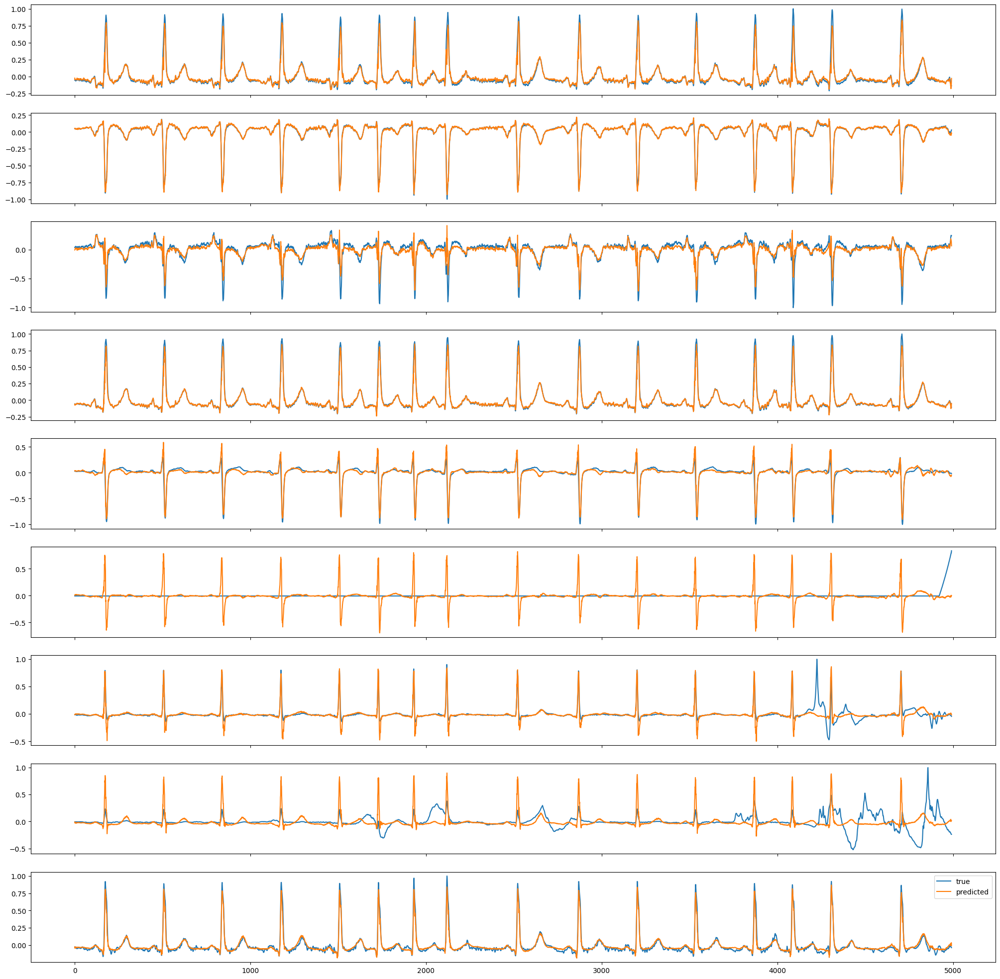

In [680]:
sample(generator, X=X_cpsc_data_cropped, y=y_cpsc_data_cropped, index=4081)

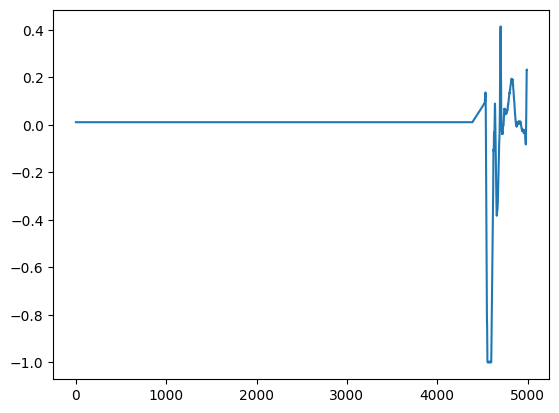

In [681]:
plt.plot(y_cpsc_data_cropped[6981][-1])

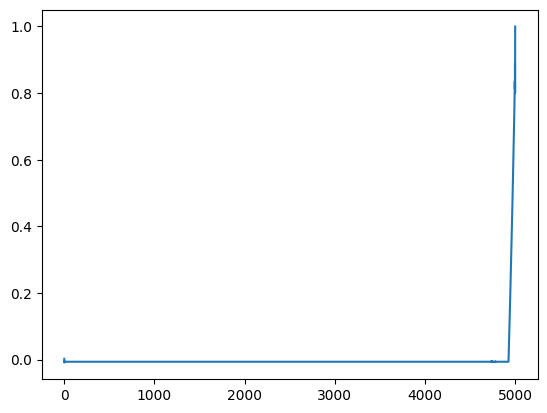

In [685]:
plt.plot(total_cpsc_data_baseline_corrected_filt[4081][-4])

#### Georgia

In [694]:
# georgia_dir = "physionet.org/files/challenge-2021/1.0.3/training/georgia"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# georgia_data = []
# for folder in os.listdir(georgia_dir):
#     i = os.path.join(georgia_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'mat':
#                 georgia_data.append(torch.tensor(io.loadmat(datafile)['val'], dtype=torch.float32))

In [695]:
# fs = 500
# for i in range(len(georgia_data_filt)):
#     for j in range(len(leads)):
#         temp = georgia_data_filt[i][j]
#         mfil1 = scipy.ndimage.median_filter(temp, size=int(fs/5))
#         mfil2 = scipy.ndimage.median_filter(mfil1, size=int(3*fs/5))
#         georgia_data_filt[i][j] = temp-mfil2


In [696]:
# torch.save(georgia_data_filt, "baseline_corrected_georgia.pt")

In [697]:
# georgia_dir = "physionet.org/files/challenge-2021/1.0.3/training/georgia"
# leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
# for folder in os.listdir(georgia_dir):
#     i = os.path.join(georgia_dir, folder)
#     if not os.path.isfile(i):
#         for file in os.listdir(i):
#             datafile = os.path.join(i, file)
#             if datafile[-3:] == 'hea':
#                 with open(datafile) as f:
#                     lines = f.readline()
#                     if lines.split()[-2] != '500':
#                         print(f"bad, {datafile}")

In [60]:
georgia_data_baseline_corrected = torch.load("baseline_corrected_georgia.pt")

In [61]:
len(georgia_data_baseline_corrected)

10344

In [62]:
georgia_data_baseline_corrected_scaled = copy.deepcopy(georgia_data_baseline_corrected)

In [63]:
# data normalization
bad_indices = []
for i in range(len(georgia_data_baseline_corrected)):
    for j in range(12):
        if torch.max(georgia_data_baseline_corrected[i][j]) - torch.min(georgia_data_baseline_corrected[i][j]) < 1e-5:
            print(f"nan error at index {i}, lead {j}")
            bad_indices.append(i)
        #print(X_cpsc_data_windowed[i,0,j].shape)
        georgia_data_baseline_corrected_scaled[i][j] = (georgia_data_baseline_corrected[i][j]-torch.mean(georgia_data_baseline_corrected[i][j]))/(torch.max(georgia_data_baseline_corrected[i][j]) - torch.min(georgia_data_baseline_corrected[i][j]))
        # georgia_data_baseline_corrected_scaled[i][j] *= 1/torch.max(torch.abs(georgia_data_baseline_corrected[i][j])) # trying something new
        if torch.isnan(georgia_data_baseline_corrected_scaled[i][j]).any():
            print(f"nan error at index {i}, lead {j}")
            bad_indices.append(i)
    # for j in range(9):
    #     if torch.max(y_cpsc_data_windowed[i,0,j]) - torch.min(y_cpsc_data_windowed[i,0,j]) < 1e-5:
    #         print(f"nan error at train index {i}, lead {j+3}")
    #         bad_indices.append(i)
    #     #print(y_cpsc_data_windowed[i,0,j].shape)
    #     y_cpsc_data_windowed[i,0,j] = (y_cpsc_data_windowed[i,0,j]-torch.mean(y_cpsc_data_windowed[i,0,j]))/(torch.max(y_cpsc_data_windowed[i,0,j]) - torch.min(y_cpsc_data_windowed[i,0,j]))

records_to_keep = []
for i in range(len(georgia_data_baseline_corrected_scaled)):
    if i not in bad_indices:
        records_to_keep.append(i)
len(records_to_keep)
# WFDB_records = WFDB_records[records_to_keep]
# WFDB_records.shape

nan error at index 2455, lead 7
nan error at index 3748, lead 7
nan error at index 5070, lead 9
nan error at index 5303, lead 8
nan error at index 5458, lead 8
nan error at index 5663, lead 8
nan error at index 9429, lead 8
nan error at index 9597, lead 10
nan error at index 9715, lead 11


10335

In [64]:
georgia_data_baseline_corrected_scaled_filtered = []
for idx, ele in enumerate(georgia_data_baseline_corrected_scaled): 
	# checking if element not present in index list
	if idx not in bad_indices:
		georgia_data_baseline_corrected_scaled_filtered.append(ele)
len(georgia_data_baseline_corrected_scaled_filtered)

10335

In [65]:
X_georgia_data_cropped = []
y_georgia_data_cropped = []
for i in range(len(georgia_data_baseline_corrected_scaled_filtered)):
    real_len = georgia_data_baseline_corrected_scaled_filtered[i].size(1)
    #print(real_len)
    cropped_len = 128*(georgia_data_baseline_corrected_scaled_filtered[i].size(1)//128)
    # if cropped_len >= 4864:
    #     #print(cropped_len)
    #     X_cpsc_data_cropped.append(torch.cat((georgia_data_baseline_corrected_scaled_filtered[i][:2,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], georgia_data_baseline_corrected_scaled_filtered[i][7, int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len].unsqueeze(0)))) 
    #     y_cpsc_data_cropped.append(torch.cat((georgia_data_baseline_corrected_scaled_filtered[i][2:7,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], georgia_data_baseline_corrected_scaled_filtered[i][8:,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len]))) 
    X_georgia_data_cropped.append(torch.cat((georgia_data_baseline_corrected_scaled_filtered[i][:2,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], georgia_data_baseline_corrected_scaled_filtered[i][7, int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len].unsqueeze(0)))) 
    y_georgia_data_cropped.append(torch.cat((georgia_data_baseline_corrected_scaled_filtered[i][2:7,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len], georgia_data_baseline_corrected_scaled_filtered[i][8:,int((real_len-cropped_len)/2): int((real_len-cropped_len)/2) + cropped_len]))) 


In [66]:
set(X_georgia_data_cropped[i].size(1) for i in range(len(X_georgia_data_cropped)))

{2432, 4992}

In [69]:
len([i for i in range(len(X_georgia_data_cropped)) if X_georgia_data_cropped[i].size(1) == 2432])

52

In [55]:
compute_metrics(test_generator, X=X_georgia_data_cropped, y=y_georgia_data_cropped, num_preds_ratio = 1)

NameError: name 'test_generator' is not defined

In [56]:
compute_metrics(generator, X=X_georgia_data_cropped, y=y_georgia_data_cropped, num_preds_ratio = 1)

avg R2 score for III: 0.8706310391426086
avg R2 score for aVR: 0.9769594073295593
avg R2 score for aVL: 0.8969132304191589
avg R2 score for aVF: 0.9289507865905762
avg R2 score for V1: 0.8014729022979736
avg R2 score for V3: 0.582093358039856
avg R2 score for V4: 0.6259452700614929
avg R2 score for V5: 0.6915998458862305
avg R2 score for V6: 0.7460615634918213
avg CC score for III: 0.9401979446411133
avg CC score for aVR: 0.9904393553733826
avg CC score for aVL: 0.9525011777877808
avg CC score for aVF: 0.9693957567214966
avg CC score for V1: 0.899871826171875
avg CC score for V3: 0.8038589954376221
avg CC score for V4: 0.8145793676376343
avg CC score for V5: 0.8545352220535278
avg CC score for V6: 0.8810931444168091
avg R2 score: 0.7911808490753174
avg CC score: 0.9007192254066467
Avg MAE: 0.023333881050348282


In [ ]:
#index = torch.randint(0, round((1-r) * d0), (1,)).item()
#patient_true = y[index,0]
generator.eval()
L1 = nn.L1Loss()
total_l1_loss = 0
#patient_pred = generator(X[index].to(device))[0,0].detach().cpu()
#plt.ylim(-3,3)
X=X_georgia_data_cropped
y=y_georgia_data_cropped
totalnum = len(y)
test_num_patients = int(1*totalnum)
avg_pearsoncorr_score = {leads[i + 3]: 0 for i in range(9)}
avg_r2_score = {leads[i + 3]: 0 for i in range(9)}
idx = torch.randperm(totalnum)
for index in idx:
    #print(f"patient {index} from test set")
    #print(index.item())
    if X[0].dim() == 3:
        patient_true = y[index.item(),0]
        patient_pred = generator(X[index.item()].to(device))[0,0].detach().cpu()
    else:
        patient_true = y[index.item()]
        patient_pred = generator(X[index.item()].unsqueeze(0).to(device))[0,0].detach().cpu()
    for i in range(9):
        z = torch.corrcoef(torch.stack((patient_true[i],patient_pred[i])))
        total_l1_loss += L1(patient_pred, patient_true)
        avg_pearsoncorr_score[leads[i + 3]] += z[0,1]/test_num_patients
        r2 = r2_score(patient_pred[i], patient_true[i])
        if r2.isnan():
            print(f"patient {index}, test lead {i}: R2: {r2}") 
        avg_r2_score[leads[i + 3]] += r2/test_num_patients
        #print(f"CC score for {leads[i + 3]}: {z[0,1]}")
for i in range(9):
    print(f"avg R2 score for {leads[i + 3]}: {avg_r2_score[leads[i + 3]]}")
for i in range(9):
    print(f"avg CC score for {leads[i + 3]}: {avg_pearsoncorr_score[leads[i + 3]]}")
print(f"avg R2 score: {sum([avg_r2_score[leads[i + 3]] for i in range(9)])/9}")
print(f"avg CC score: {sum([avg_pearsoncorr_score[leads[i + 3]] for i in range(9)])/9}")
print(f"Avg MAE: {total_l1_loss/test_num_patients}")
#compute_metrics(generator, 0.01, 'train')

Index: 10237


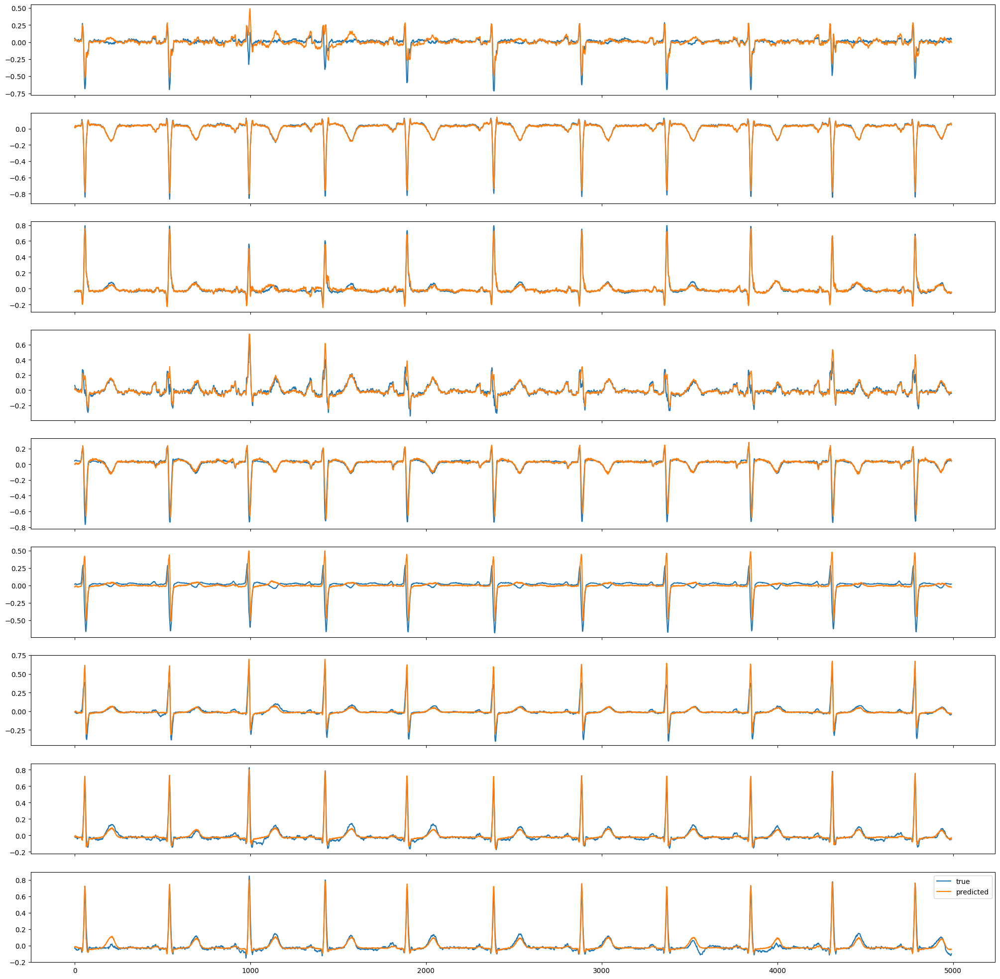

In [1188]:
sample(generator, X=X_georgia_data_cropped, y=y_georgia_data_cropped)

In [88]:
# extract 4992 point graphs with window size 1216 from 14592 point ECG
X_georgia_data_windowed = []
window_size = 1248
image_size = 4992
for i in range(len(X_georgia_data_cropped)):
    if X_georgia_data_cropped[i].size(1) < image_size:
        continue
    if X_georgia_data_cropped[i].size(1)  < image_size+ window_size:
        X_georgia_data_windowed.append(X_georgia_data_cropped[i][:, int((X_georgia_data_cropped[i].size(1) - image_size)/2):int((X_georgia_data_cropped[i].size(1) - image_size)/2) + image_size])
    else:
        for j in range((X_georgia_data_cropped[i].size(1) - image_size)//window_size):
            X_georgia_data_windowed.append(X_georgia_data_cropped[i][:, j*window_size: j*window_size + image_size])
X_georgia_data_windowed = torch.stack(X_georgia_data_windowed)
X_georgia_data_windowed = X_georgia_data_windowed.unsqueeze(1)
# extract 4864 point graphs with window size 1216 from 14592 point ECG
y_georgia_data_windowed = []
window_size = 1248
image_size = 4992
for i in range(len(y_georgia_data_cropped)):
    if y_georgia_data_cropped[i].size(1) < image_size:
        continue
    if y_georgia_data_cropped[i].size(1)  < image_size+ window_size:
        y_georgia_data_windowed.append(y_georgia_data_cropped[i][:, int((y_georgia_data_cropped[i].size(1) - image_size)/2):int((y_georgia_data_cropped[i].size(1) - image_size)/2) + image_size])
    else:
        for j in range((y_georgia_data_cropped[i].size(1) - image_size)//window_size):
            y_georgia_data_windowed.append(y_georgia_data_cropped[i][:, j*window_size: j*window_size + image_size])
y_georgia_data_windowed = torch.stack(y_georgia_data_windowed)
y_georgia_data_windowed = y_georgia_data_windowed.unsqueeze(1)
X_georgia_data_windowed.shape, y_georgia_data_windowed.shape

(torch.Size([10283, 1, 3, 4992]), torch.Size([10283, 1, 9, 4992]))

#### PTBDB Subgroups

In [132]:
# data prep
ptbdb_mainfolder = "dump_data"
leads = ['I','II','V2', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V3', 'V4', 'V5', 'V6']
ptbdb_conditiondata = {'BB': [], 'HC': [], 'HY' : [], 'MI': [], 'ND': [],'VA': []}
for folder in os.listdir(ptbdb_mainfolder):
    i = os.path.join(ptbdb_mainfolder, folder)
    # checking if it is a dir
    if not os.path.isfile(i):
        j1 = os.path.join(i, 'RL3')
        j2 = os.path.join(i, 'SL9')
        for patient in os.listdir(j1):
            k1 = os.path.join(j1, patient)
            k2 = os.path.join(j2, patient)
            RL3data = torch.tensor(io.loadmat(k1)['val_RL3'], dtype=torch.float32)
            SL9data = torch.tensor(io.loadmat(k2)['val_SL9'], dtype=torch.float32)
            ptbdb_conditiondata[folder].append(torch.cat((RL3data,SL9data), 0))

for key in ptbdb_conditiondata:
    ptbdb_conditiondata[key] = torch.stack(ptbdb_conditiondata[key], 0)

d0 = sum([ptbdb_conditiondata[key].shape[0] for key in ptbdb_conditiondata])
r_ptbdb = 0.465 # proportion of time/people taken for training
d1 = 30000
illness_wise_patient_nums = [len(ptbdb_conditiondata[condition]) for condition in ptbdb_conditiondata]
totaldata_ptbdb = torch.cat([ptbdb_conditiondata[condition] for condition in ptbdb_conditiondata], dim=0)
traindata_ptbdb = torch.cat([ptbdb_conditiondata[condition][:round(r_ptbdb*len(ptbdb_conditiondata[condition]))] for condition in ptbdb_conditiondata], dim=0)
testdata_ptbdb = torch.cat([ptbdb_conditiondata[condition][round(r_ptbdb*len(ptbdb_conditiondata[condition])):] for condition in ptbdb_conditiondata], dim=0)

resampled_testdata_ptbdb = torch.zeros((testdata_ptbdb.size(0),testdata_ptbdb.size(1), int(testdata_ptbdb.size(2)/2)))
for i in range(len(testdata_ptbdb)):
    for j in range(len(leads)):
        resampled_testdata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(testdata_ptbdb[i,j], 15000), dtype=torch.float32)

resampled_traindata_ptbdb = torch.zeros((traindata_ptbdb.size(0),traindata_ptbdb.size(1), int(traindata_ptbdb.size(2)/2)))
for i in range(len(traindata_ptbdb)):
    for j in range(len(leads)):
        resampled_traindata_ptbdb[i,j] = torch.tensor(scipy.signal.resample(traindata_ptbdb[i,j], 15000), dtype=torch.float32)


train_idx = torch.randperm(resampled_traindata_ptbdb.size(0))
test_idx = torch.randperm(resampled_testdata_ptbdb.size(0))
resampled_traindata_ptbdb = resampled_traindata_ptbdb[train_idx]
resampled_testdata_ptbdb = resampled_testdata_ptbdb[test_idx]
ptbdb_clip_len = 12

X_test_ptbdb = resampled_testdata_ptbdb[:,:3,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
y_test_ptbdb = resampled_testdata_ptbdb[:,3:,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
X_train_ptbdb = resampled_traindata_ptbdb[:,:3,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
y_train_ptbdb = resampled_traindata_ptbdb[:,3:,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)

# # data normalization
# for i in range(X_train_ptbdb.size(0)):
#     for j in range(3):
#         #print(X_train_ptbdb[i,0,j].shape)
#         X_train_ptbdb[i,0,j] = X_train_ptbdb[i,0,j]/torch.max(torch.abs(X_train_ptbdb[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbdb[i,0,j].shape)
#         y_train_ptbdb[i,0,j] = y_train_ptbdb[i,0,j]/torch.max(torch.abs(y_train_ptbdb[i,0,j]))
# for i in range(X_test_ptbdb.size(0)):
#     for j in range(3):
#         #print(X_test_ptbdb[i,0,j].shape)
#         X_test_ptbdb[i,0,j] = X_test_ptbdb[i,0,j]/torch.max(torch.abs(X_test_ptbdb[i,0,j]))
#     for j in range(9):
#         #print(y_train_ptbdb[i,0,j].shape)
#         y_test_ptbdb[i,0,j] = y_test_ptbdb[i,0,j]/torch.max(torch.abs(y_test_ptbdb[i,0,j]))

# data normalization
for i in range(X_train_ptbdb.size(0)):
    for j in range(3):
        if torch.max(X_train_ptbdb[i,0,j]) - torch.min(X_train_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j}")
        #print(X_train_ptbdb[i,0,j].shape)
        X_train_ptbdb[i,0,j] = (X_train_ptbdb[i,0,j]-torch.mean(X_train_ptbdb[i,0,j]))/(torch.max(X_train_ptbdb[i,0,j]) - torch.min(X_train_ptbdb[i,0,j]))
    for j in range(9):
        if torch.max(y_train_ptbdb[i,0,j]) - torch.min(y_train_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at train index {i}, lead {j+3}")
        #print(y_train_ptbdb[i,0,j].shape)
        y_train_ptbdb[i,0,j] = (y_train_ptbdb[i,0,j]-torch.mean(y_train_ptbdb[i,0,j]))/(torch.max(y_train_ptbdb[i,0,j]) - torch.min(y_train_ptbdb[i,0,j]))
for i in range(X_test_ptbdb.size(0)):
    for j in range(3):
        if torch.max(X_test_ptbdb[i,0,j]) - torch.min(X_test_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j}")
        #print(X_test_ptbdb[i,0,j].shape)
        X_test_ptbdb[i,0,j] = (X_test_ptbdb[i,0,j]-torch.mean(X_test_ptbdb[i,0,j]))/(torch.max(X_test_ptbdb[i,0,j]) - torch.min(X_test_ptbdb[i,0,j]))
    for j in range(9):
        if torch.max(y_test_ptbdb[i,0,j]) - torch.min(y_test_ptbdb[i,0,j]) < 1e-5:
            print(f"nan error at test index {i}, lead {j+3}")
        #print(y_train_ptbdb[i,0,j].shape)
        y_test_ptbdb[i,0,j] = (y_test_ptbdb[i,0,j]-torch.mean(y_test_ptbdb[i,0,j]))/(torch.max(y_test_ptbdb[i,0,j]) - torch.min(y_test_ptbdb[i,0,j]))
    #break

In [133]:
ptbdb_conditiondata_tensorized = {}
for condition in ptbdb_conditiondata:
    data = copy.deepcopy(ptbdb_conditiondata[condition])
    resampled = torch.zeros((data.size(0),data.size(1), int(data.size(2)/2)))
    for i in range(len(data)):
        for j in range(len(leads)):
            resampled[i,j] = torch.tensor(scipy.signal.resample(data[i,j], 15000), dtype=torch.float32)
    ptbdb_clip_len = 12
    X = resampled[:,:3,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
    y = resampled[:,3:,ptbdb_clip_len:-ptbdb_clip_len].unsqueeze(1)
    # data normalization
    for i in range(X.size(0)):
        for j in range(3):
            if torch.max(X[i,0,j]) - torch.min(X[i,0,j]) < 1e-5:
                print(f"nan error at train index {i}, lead {j}")
            X[i,0,j] = (X[i,0,j]-torch.mean(X[i,0,j]))/(torch.max(X[i,0,j]) - torch.min(X[i,0,j]))
        for j in range(9):
            if torch.max(y[i,0,j]) - torch.min(y[i,0,j]) < 1e-5:
                print(f"nan error at train index {i}, lead {j+3}")
            y[i,0,j] = (y[i,0,j]-torch.mean(y[i,0,j]))/(torch.max(y[i,0,j]) - torch.min(y[i,0,j]))
    ptbdb_conditiondata_tensorized[condition] = {'X' : X, 'y' : y}


In [136]:
for condition in ptbdb_conditiondata_tensorized:
    print(f"Results for PTBDB condition: {condition}")
    compute_metrics(best_generator, X=ptbdb_conditiondata_tensorized[condition]['X'], y=ptbdb_conditiondata_tensorized[condition]['y'], num_preds_ratio = 1)
    print("")

Results for PTBDB condition: BB
avg R2 score for III: 0.9002957344055176
avg R2 score for aVR: 0.9603393077850342
avg R2 score for aVL: 0.9370538592338562
avg R2 score for aVF: 0.9684830904006958
avg R2 score for V1: 0.8487034440040588
avg R2 score for V3: 0.9031379222869873
avg R2 score for V4: 0.7012417912483215
avg R2 score for V5: 0.8131775259971619
avg R2 score for V6: 0.785176157951355
avg CC score for III: 0.951845645904541
avg CC score for aVR: 0.983280599117279
avg CC score for aVL: 0.9731466174125671
avg CC score for aVF: 0.9885067343711853
avg CC score for V1: 0.9378551840782166
avg CC score for V3: 0.9617359638214111
avg CC score for V4: 0.8252278566360474
avg CC score for V5: 0.8985391855239868
avg CC score for V6: 0.8692305088043213
avg R2 score: 0.8686231970787048
avg CC score: 0.9321520328521729
Avg MAE: 0.023819200694561005

Results for PTBDB condition: HC
avg R2 score for III: 0.8913534879684448
avg R2 score for aVR: 0.9879788756370544
avg R2 score for aVL: 0.86738985